# Import

In [22]:
import os
import sys
import pandas as pd
import numpy as np
import datetime as dt
import itertools as it
import csv
import ast
from pprint import pprint
from prettytable import PrettyTable
import matplotlib
import matplotlib.pylab as plt
import matplotlib.colors as mcolors
import seaborn as sns
import portion as P

pdir = os.path.abspath(os.path.join(os.getcwd(), '..'))  # for jupyter-notebook
sys.path.insert(1, pdir)
from myutils import *

%config InlineBackend.figure_format = 'retina'  # 提高 jupyter notebook 的圖形顯示解析度
# plt.style.use('ggplot')

pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 500)

In [2]:
def set_data(df, mode='pcap', tz=0):
    if mode == 'pcap':
        df['seq'] = df['seq'].astype('Int32')
        # df['rpkg'] = df['rpkg'].astype('Int8')
        df['frame_id'] = df['frame_id'].astype('Int32')
        df['Timestamp'] = pd.to_datetime(df['Timestamp'])
        df['xmit_time'] = pd.to_datetime(df['xmit_time'])
        df['arr_time'] = pd.to_datetime(df['arr_time'])
        df['Timestamp_epoch'] = df['Timestamp_epoch'].astype('float32')
        df['xmit_time_epoch'] = df['xmit_time_epoch'].astype('float32')
        df['arr_time_epoch'] = df['arr_time_epoch'].astype('float32')
        df['lost'] = df['lost'].astype('boolean')
        df['excl'] = df['excl'].astype('boolean')
        df['latency'] = df['latency'].astype('float32')
    # LTE (E-UTRA) & NR
    def nr_serv_cel(row):
        pos = row.serv_cel_pos
        if pos == 255:
            return 65535, -160, -50
        else:
            return row[f'PCI{pos}'], row[f'RSRP{pos}'], row[f'RSRQ{pos}']
    if mode == 'lte':
        df = df.rename(columns={
            'RSRP(dBm)': 'RSRP',
            'RSRQ(dB)': 'RSRQ',
            'Serving Cell Index': 'serv_cel_index',
            'Number of Neighbor Cells': 'num_neigh_cels',
            'Number of Detected Cells': 'num_cels',
            }).reindex(['Timestamp','type_id','PCI','RSRP','RSRQ','serv_cel_index','EARFCN','NR_ARFCN',
                        'num_cels','num_neigh_cels','serv_cel_pos','PCI0','RSRP0','RSRQ0',
                        *df.columns.to_list()[df.columns.get_loc('PCI1'):]], axis=1)
        df.loc[df['serv_cel_index'] == '(MI)Unknown', 'serv_cel_index'] = '3_SCell'
        df['num_cels'] = df['num_neigh_cels'] + 1
        ## set dtypes
        df['Timestamp'] = pd.to_datetime(df['Timestamp']) + pd.Timedelta(hours=tz)
        df['type_id'] = df['type_id'].astype('category')
        df['serv_cel_index'] = df['serv_cel_index'].astype('category')
        df['EARFCN'] = df['EARFCN'].astype('Int32')
        df['NR_ARFCN'] = df['NR_ARFCN'].astype('Int32')
        df['num_cels'] = df['num_cels'].astype('UInt8')
        df['num_neigh_cels'] = df['num_neigh_cels'].astype('UInt8')
        df['serv_cel_pos'] = df['serv_cel_pos'].astype('UInt8')
        for tag in df.columns:
            if tag.startswith('PCI'):
                df[tag] = df[tag].astype('Int32')
            if tag.startswith(('RSRP','RSRQ')):
                df[tag] = df[tag].astype('float32')
    if mode == 'nr':
        if df.empty:
            df = pd.DataFrame(columns=['Timestamp','type_id','PCI','RSRP','RSRQ','serv_cel_index','EARFCN','NR_ARFCN',
                                       'num_cels','num_neigh_cels','serv_cel_pos','PCI0','RSRP0','RSRQ0'])
        else:
            df = df.rename(columns={
                'Raster ARFCN': 'NR_ARFCN',
                'Serving Cell Index': 'serv_cel_pos',
                'Num Cells': 'num_cels',
                }).reindex(['Timestamp','type_id','PCI','RSRP','RSRQ','serv_cel_index','EARFCN','NR_ARFCN',
                            'num_cels','num_neigh_cels','serv_cel_pos','PCI0','RSRP0','RSRQ0',
                            *df.columns.to_list()[df.columns.get_loc('PCI1'):]], axis=1)
            df.loc[df['serv_cel_pos'] != 255, 'serv_cel_index'] = 'PSCell'
            df[['PCI','RSRP','RSRQ']] = df.apply(nr_serv_cel, axis=1, result_type='expand')
            df.loc[df['serv_cel_pos'] == 255, 'num_neigh_cels'] = df['num_cels']
            df.loc[df['serv_cel_pos'] != 255, 'num_neigh_cels'] = df['num_cels'] - 1
        ## set dtypes
        df['Timestamp'] = pd.to_datetime(df['Timestamp']) + pd.Timedelta(hours=tz)
        df['type_id'] = df['type_id'].astype('category')
        df['serv_cel_index'] = df['serv_cel_index'].astype('category')
        df['EARFCN'] = df['EARFCN'].astype('Int32')
        df['NR_ARFCN'] = df['NR_ARFCN'].astype('Int32')
        df['num_cels'] = df['num_cels'].astype('UInt8')
        df['num_neigh_cels'] = df['num_neigh_cels'].astype('UInt8')
        df['serv_cel_pos'] = df['serv_cel_pos'].astype('UInt8')
        for tag in df.columns:
            if tag.startswith('PCI'):
                df[tag] = df[tag].astype('Int32')
            if tag.startswith(('RSRP','RSRQ')):
                df[tag] = df[tag].astype('float32')
    return df

In [3]:
dates = ['2023-06-15',]

# root = '/home/wmnlab/D/database/'
root = '/Users/jackbedford/Desktop/MOXA/Code/data/'
paths = [s for s in dates if os.path.isdir(os.path.join(root, s))]

md_files = []

for date_dir in paths:
    datedir = os.path.join(root, date_dir)
    md_file = [os.path.join(datedir, s) for s in os.listdir(datedir) if s.endswith('.md')]
    md_files += md_file

md_files = sorted(md_files)

# pprint(md_files)

class Experiment():
    
    def __init__(self, dirname, setting):
        
        self.dirname = dirname
        self.setting = setting
        self.traces = []
        
    def __repr__(self):
        return f'{self.dirname} -> {self.setting} -> {self.traces}'

exp_list = []

for md_file in md_files:
    
    md_f = open(md_file, 'r')
    lines = []
    l = md_f.readline()[:-1]
    
    while l:
        
        if l == '#endif':
            break
        lines.append(l)
        l = md_f.readline()[:-1]
        
    md_f.close()
    
    for exp, dic in zip(lines[::2], lines[1::2]):
        
        dictionary = ast.literal_eval(dic)
        parent_dir = os.path.dirname(md_file)
        experiment = Experiment(dirname=os.path.join(parent_dir, exp), setting=dictionary)
        exp_list.append(experiment)

exp_list[0].traces = ["#{:02d}".format(i+1) for i in range(4)]
exp_list[1].traces = ["#{:02d}".format(i+1) for i in range(4)]
exp_list[2].traces = ["#{:02d}".format(i+1) for i in range(2, 6)]
exp_list[3].traces = ["#{:02d}".format(i+1) for i in range(4)]
exp_list[4].traces = ["#{:02d}".format(i+1) for i in range(4)]

pprint(exp_list)

[/Users/jackbedford/Desktop/MOXA/Code/data/2023-06-15/Bandlock_B1_B3_B7_B8_Dupl_Phone -> {'sm00': 'B1', 'sm01': 'B1', 'sm02': 'B3', 'sm03': 'B3', 'sm04': 'B7', 'sm05': 'B7', 'sm06': 'B8', 'sm07': 'B8'} -> ['#01', '#02', '#03', '#04'],
 /Users/jackbedford/Desktop/MOXA/Code/data/2023-06-15/Bandlock_All_B3_B7_B8_Dupl_Phone -> {'sm00': 'All', 'sm01': 'All', 'sm02': 'B3', 'sm03': 'B3', 'sm04': 'B7', 'sm05': 'B7', 'sm06': 'B8', 'sm07': 'B8'} -> ['#01', '#02', '#03', '#04'],
 /Users/jackbedford/Desktop/MOXA/Code/data/2023-06-15/Bandlock_LTE_B3_B7_B8_Dupl_Phone -> {'sm00': 'LTE', 'sm01': 'LTE', 'sm02': 'B3', 'sm03': 'B3', 'sm04': 'B7', 'sm05': 'B7', 'sm06': 'B8', 'sm07': 'B8'} -> ['#03', '#04', '#05', '#06'],
 /Users/jackbedford/Desktop/MOXA/Code/data/2023-06-15/Bandlock_LTE_LTEb3_LTEb7_LTEb8_Dupl_Phone -> {'sm00': 'LTE', 'sm01': 'LTE', 'sm02': 'LTEb3', 'sm03': 'LTEb3', 'sm04': 'LTEb7', 'sm05': 'LTEb7', 'sm06': 'LTEb8', 'sm07': 'LTEb8'} -> ['#01', '#02', '#03', '#04'],
 /Users/jackbedford/Desk

# Collecting Data

In [4]:
ul_plr_tables = {}
ul_elr_tables = {}

for exp in exp_list:
    dirname = exp.dirname
    devices = list(exp.setting.keys())
    schemes = list(exp.setting.values())
    traces = exp.traces
    print(os.path.basename(dirname))
    
    schemes = [f'{s}.0' if i % 2 == 0 else f'{s}.1' for i, s in enumerate(schemes)]
    # print(devices)
    # print(schemes)
    
    xs = list(it.product(schemes, repeat=2))
    xs = ['+'.join([s[0], s[1]]) if s[0] != s[1] else s[0] for s in xs]
    xs = np.reshape(xs, (len(schemes), len(schemes)))
    mtags = masked(xs.tolist(), mask(len(schemes), mode='upper'))

    xs = list(it.combinations(schemes, 2))
    tags = [*schemes, *['+'.join([s[0], s[1]]) for s in xs]]

    xs = list(it.combinations(devices, 2))
    xs = [*devices, *xs]
    devices = xs

    # print(devices)
    # print(tags)
    # display(pd.DataFrame(mtags))
    
    plr_table = pd.DataFrame(columns=tags)
    elr_table = pd.DataFrame(columns=tags)
    
    for i, trace in enumerate(traces):
        plr_row = []
        elr_row = []
        print(trace)
    
        for dev, schm in zip(devices, tags):
            print(dev)
            
            if type(dev) is not tuple: # Single Radio
                path = os.path.join(dirname, dev, trace, 'data', 'udp_uplk_loss_latency.pkl')
                df = set_data(pd.read_pickle(path))
                plr = df.lost.mean() * 100
                elr = df[~df.lost].excl.mean() * 100
            else: # Dual Radio
                path1 = os.path.join(dirname, dev[0], trace, 'data', 'udp_uplk_loss_latency.pkl')
                path2 = os.path.join(dirname, dev[1], trace, 'data', 'udp_uplk_loss_latency.pkl')
                df1 = set_data(pd.read_pickle(path1))
                df2 = set_data(pd.read_pickle(path2))
                st = max([df1['seq'].array[0], df2['seq'].array[0]])
                et = min([df1['seq'].array[-1], df2['seq'].array[-1]])
                df1 = df1[(df1['seq'] >= st) & (df1['seq'] <= et)].reset_index(drop=True)
                df2 = df2[(df2['seq'] >= st) & (df2['seq'] <= et)].reset_index(drop=True)
                df = pd.merge(df1.copy(), df2.copy(), on=['seq'], suffixes=('_m','_s')).copy()
                plr = (df.lost_m & df.lost_s).mean() * 100
                elr = (df[~(df.lost_m & df.lost_s)].excl_m & df[~(df.lost_m & df.lost_s)].excl_s).mean() * 100
            
            print(plr)
            print(elr)
            plr_row.append(plr)
            elr_row.append(elr)
        
        plr_table = pd.concat([plr_table, pd.DataFrame(plr_row, index=plr_table.columns).T])
        elr_table = pd.concat([elr_table, pd.DataFrame(elr_row, index=elr_table.columns).T])
    
    plr_table = plr_table.reset_index(drop=True).copy()
    elr_table = elr_table.reset_index(drop=True).copy()
    # display(plr_table)
    # display(elr_table)
    ul_plr_tables[os.path.basename(dirname)] = plr_table
    ul_elr_tables[os.path.basename(dirname)] = elr_table

Bandlock_B1_B3_B7_B8_Dupl_Phone
#01
sm00
0.000668395583241986
0.5534352420610784
sm01
0.0
0.0073498950969517985
sm02
0.03609094919196375
0.9213200684638425
sm03
0.04209851051460418
0.24534381559771634
sm04
0.024726339566152982
0.9003950508352216
sm05
0.026731177909354576
0.5608363748178451
sm06
0.31484799058798363
0.9428331936295056
sm07
0.02144211633688245
0.41217905326157617
('sm00', 'sm01')
0.0
0.0
('sm00', 'sm02')
0.0
0.0
('sm00', 'sm03')
0.0
0.005347164665935888
('sm00', 'sm04')
0.0
0.000668395583241986
('sm00', 'sm05')
0.0
0.002673582332967944
('sm00', 'sm06')
0.0
0.0
('sm00', 'sm07')
0.0
0.0006700661355275766
('sm01', 'sm02')
0.0
0.0
('sm01', 'sm03')
0.0
0.0
('sm01', 'sm04')
0.0
0.0
('sm01', 'sm05')
0.0
0.0
('sm01', 'sm06')
0.0
0.0
('sm01', 'sm07')
0.0
0.0
('sm02', 'sm03')
0.0
0.05480477469890792
('sm02', 'sm04')
0.0
0.29073264626859685
('sm02', 'sm05')
0.0
0.18513320233655478
('sm02', 'sm06')
0.0
0.5014139874445938
('sm02', 'sm07')
0.0
0.11458130917521558
('sm03', 'sm04')
0.0
0

In [5]:
dl_plr_tables = {}
dl_elr_tables = {}

for exp in exp_list:
    dirname = exp.dirname
    devices = list(exp.setting.keys())
    schemes = list(exp.setting.values())
    traces = exp.traces
    print(os.path.basename(dirname))
    
    schemes = [f'{s}.0' if i % 2 == 0 else f'{s}.1' for i, s in enumerate(schemes)]
    # print(devices)
    # print(schemes)
    
    xs = list(it.product(schemes, repeat=2))
    xs = ['+'.join([s[0], s[1]]) if s[0] != s[1] else s[0] for s in xs]
    xs = np.reshape(xs, (len(schemes), len(schemes)))
    mtags = masked(xs.tolist(), mask(len(schemes), mode='upper'))

    xs = list(it.combinations(schemes, 2))
    tags = [*schemes, *['+'.join([s[0], s[1]]) for s in xs]]

    xs = list(it.combinations(devices, 2))
    xs = [*devices, *xs]
    devices = xs

    # print(devices)
    # print(tags)
    # display(pd.DataFrame(mtags))
    
    plr_table = pd.DataFrame(columns=tags)
    elr_table = pd.DataFrame(columns=tags)
    
    for i, trace in enumerate(traces):
        plr_row = []
        elr_row = []
        print(trace)
    
        for dev, schm in zip(devices, tags):
            print(dev)
            
            if type(dev) is not tuple: # Single Radio
                path = os.path.join(dirname, dev, trace, 'data', 'udp_dnlk_loss_latency.pkl')
                df = set_data(pd.read_pickle(path))
                plr = df.lost.mean() * 100
                elr = df[~df.lost].excl.mean() * 100
            else: # Dual Radio
                path1 = os.path.join(dirname, dev[0], trace, 'data', 'udp_dnlk_loss_latency.pkl')
                path2 = os.path.join(dirname, dev[1], trace, 'data', 'udp_dnlk_loss_latency.pkl')
                df1 = set_data(pd.read_pickle(path1))
                df2 = set_data(pd.read_pickle(path2))
                st = max([df1['seq'].array[0], df2['seq'].array[0]])
                et = min([df1['seq'].array[-1], df2['seq'].array[-1]])
                df1 = df1[(df1['seq'] >= st) & (df1['seq'] <= et)].reset_index(drop=True)
                df2 = df2[(df2['seq'] >= st) & (df2['seq'] <= et)].reset_index(drop=True)
                df = pd.merge(df1.copy(), df2.copy(), on=['seq'], suffixes=('_m','_s')).copy()
                plr = (df.lost_m & df.lost_s).mean() * 100
                elr = (df[~(df.lost_m & df.lost_s)].excl_m & df[~(df.lost_m & df.lost_s)].excl_s).mean() * 100
            
            print(plr)
            print(elr)
            plr_row.append(plr)
            elr_row.append(elr)
        
        plr_table = pd.concat([plr_table, pd.DataFrame(plr_row, index=plr_table.columns).T])
        elr_table = pd.concat([elr_table, pd.DataFrame(elr_row, index=elr_table.columns).T])
    
    plr_table = plr_table.reset_index(drop=True).copy()
    elr_table = elr_table.reset_index(drop=True).copy()
    # display(plr_table)
    # display(elr_table)
    dl_plr_tables[os.path.basename(dirname)] = plr_table
    dl_elr_tables[os.path.basename(dirname)] = elr_table

Bandlock_B1_B3_B7_B8_Dupl_Phone
#01
sm00
0.5273641151779269
0.5825712423482929
sm01
0.0006681722815410725
0.6020272482477065
sm02
0.389648581091016
0.8507840229738525
sm03
0.09622516689052382
0.5825892110631751
sm04
0.699688581777356
0.3984090557301586
sm05
0.24459027787059437
0.5077978455437054
sm06
1.1303778175887056
1.0229539231263312
sm07
0.7772767172119889
0.218126810688889
('sm00', 'sm01')
0.0
0.3047883859583456
('sm00', 'sm02')
0.0
0.13033713873218725
('sm00', 'sm03')
0.0
0.08154426115552228
('sm00', 'sm04')
0.0
0.13568430339812315
('sm00', 'sm05')
0.0
0.10694329331871774
('sm00', 'sm06')
0.0
0.13639372321434542
('sm00', 'sm07')
0.0
0.0
('sm01', 'sm02')
0.0
0.11562470759647646
('sm01', 'sm03')
0.0
0.09154755461112336
('sm01', 'sm04')
0.0
0.12496825672623263
('sm01', 'sm05')
0.0
0.11694890335342627
('sm01', 'sm06')
0.0
0.1731329714698254
('sm01', 'sm07')
0.0
0.0
('sm02', 'sm03')
0.0006683509109622916
0.1363444970959959
('sm02', 'sm04')
0.032080843726189995
0.2674261569524115
('sm

# Show Heatmap

In [6]:
exps = [
    'Bandlock_B1_B3_B7_B8_Dupl_Phone',
    'Bandlock_All_B3_B7_B8_Dupl_Phone',
    'Bandlock_LTE_B3_B7_B8_Dupl_Phone',
    'Bandlock_LTE_LTEb3_LTEb7_LTEb8_Dupl_Phone',
    'Bandlock_LTEb1_LTEb3_LTEb7_LTEb8_Dupl_Phone',
]

## All Traces

Bandlock_B1_B3_B7_B8_Dupl_Phone


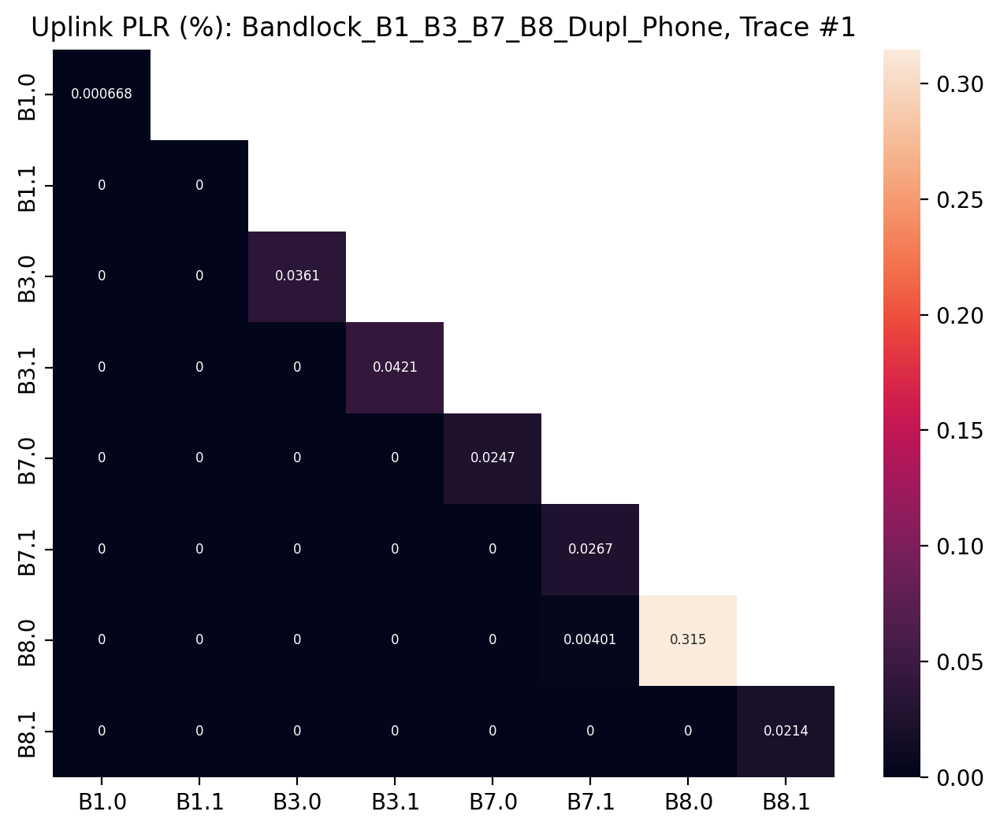

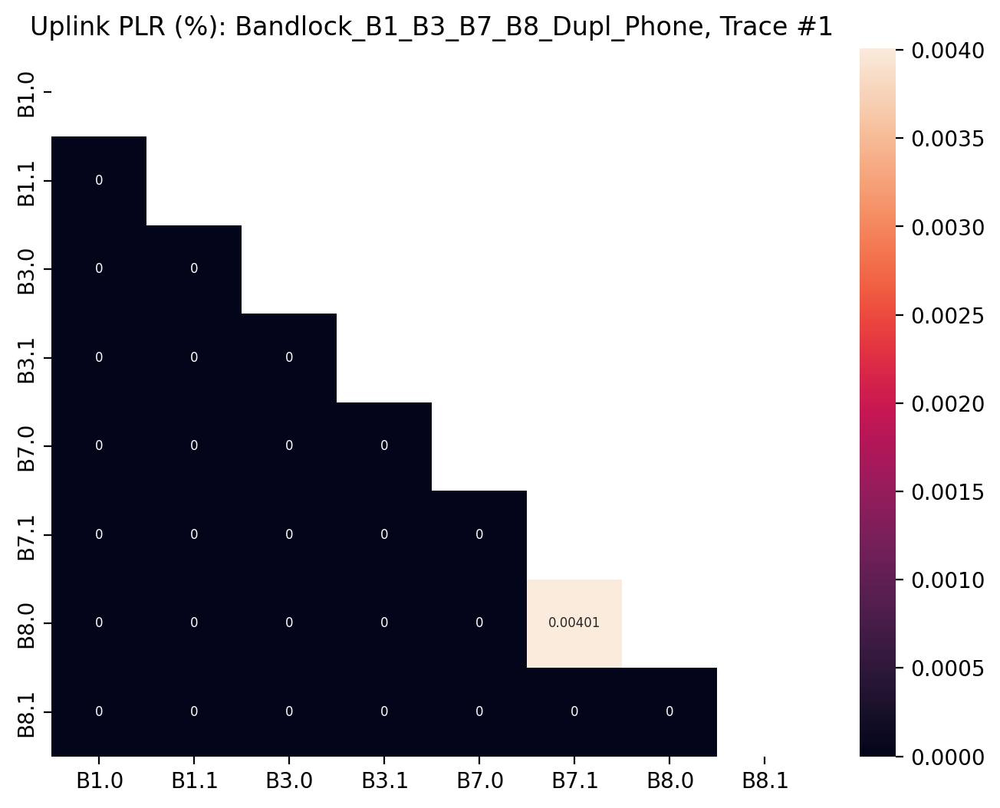

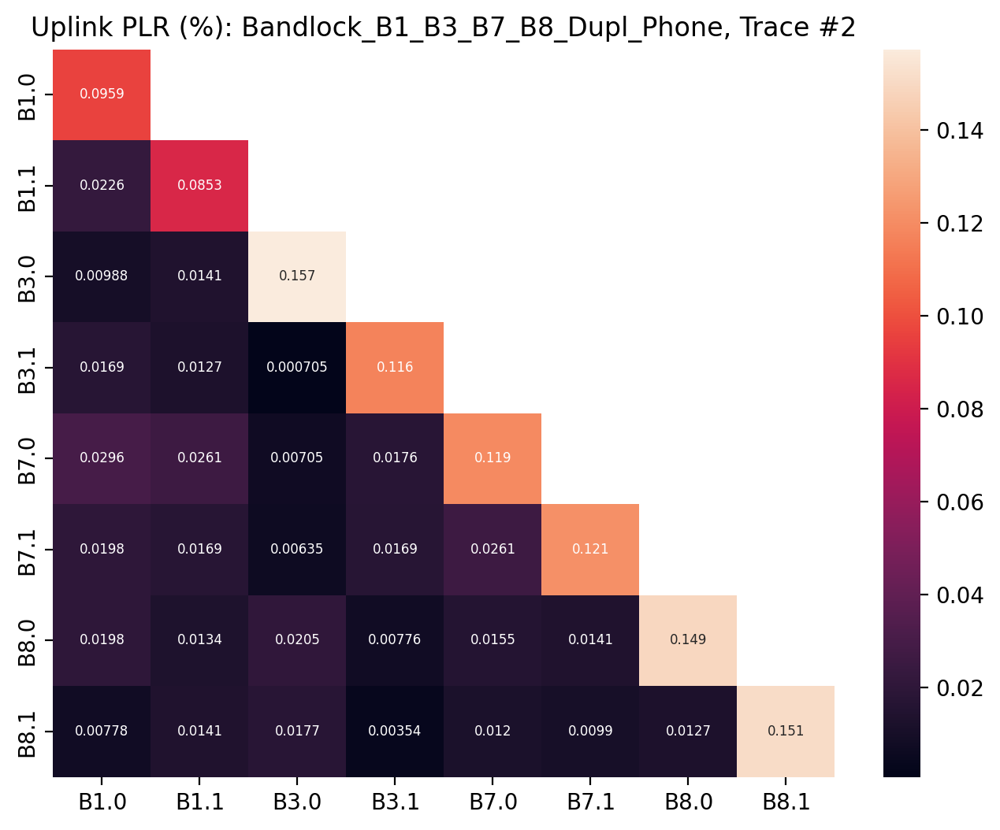

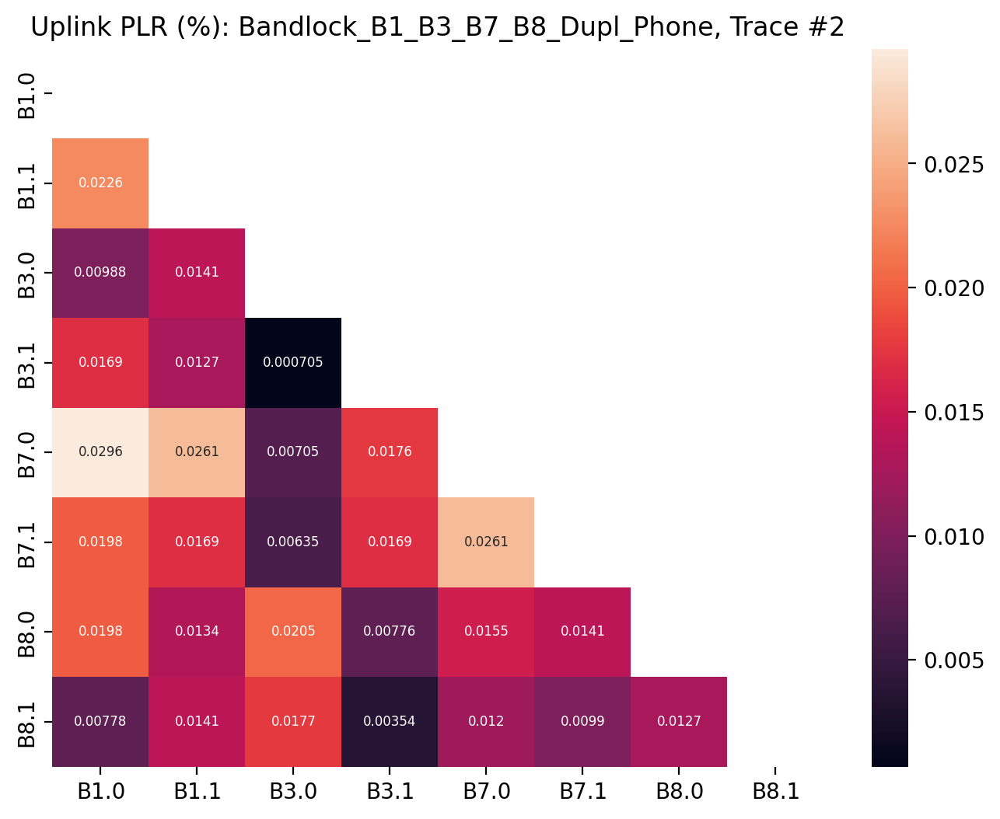

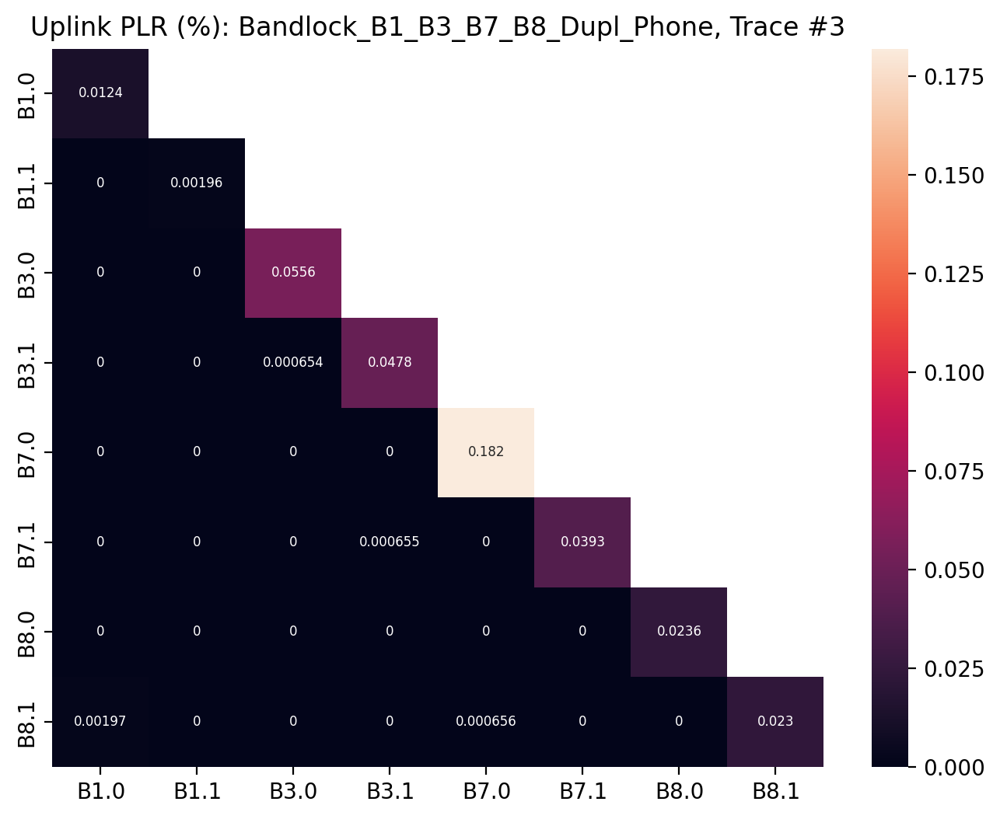

...

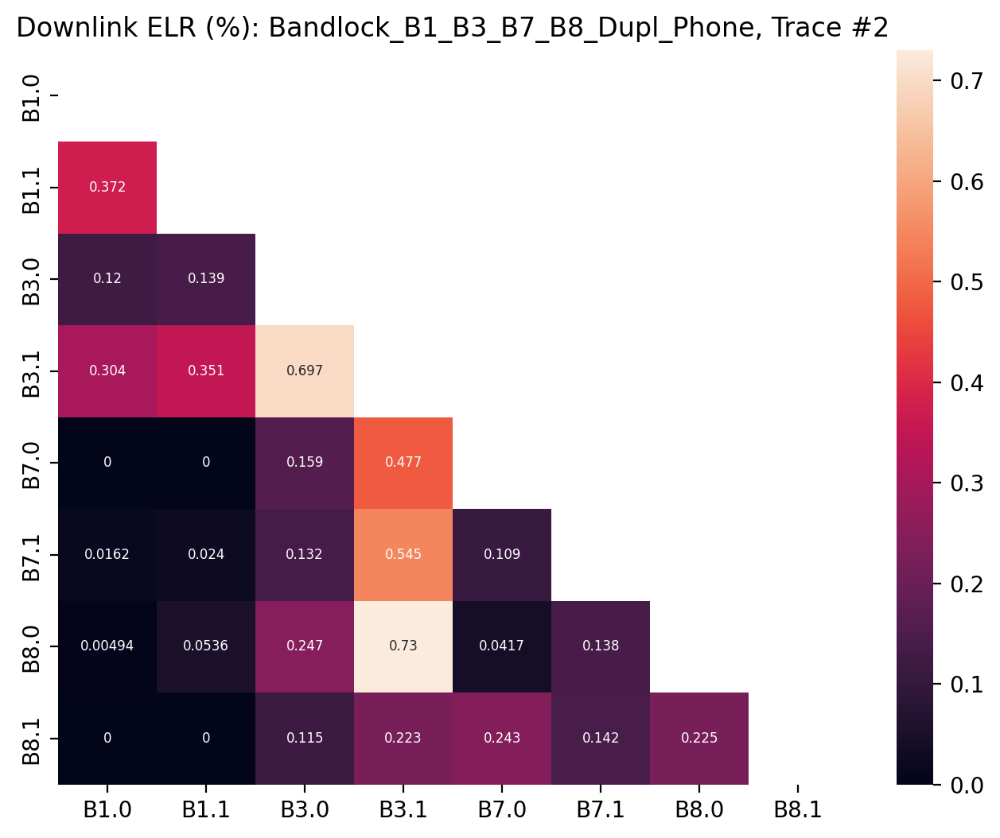

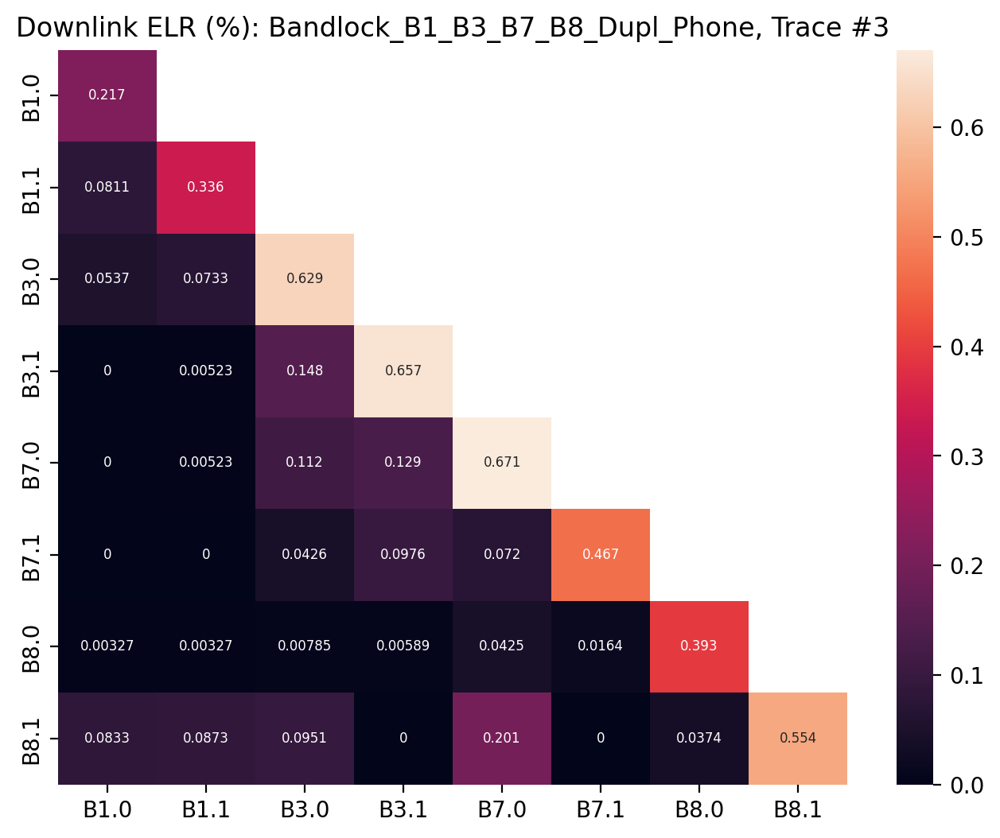

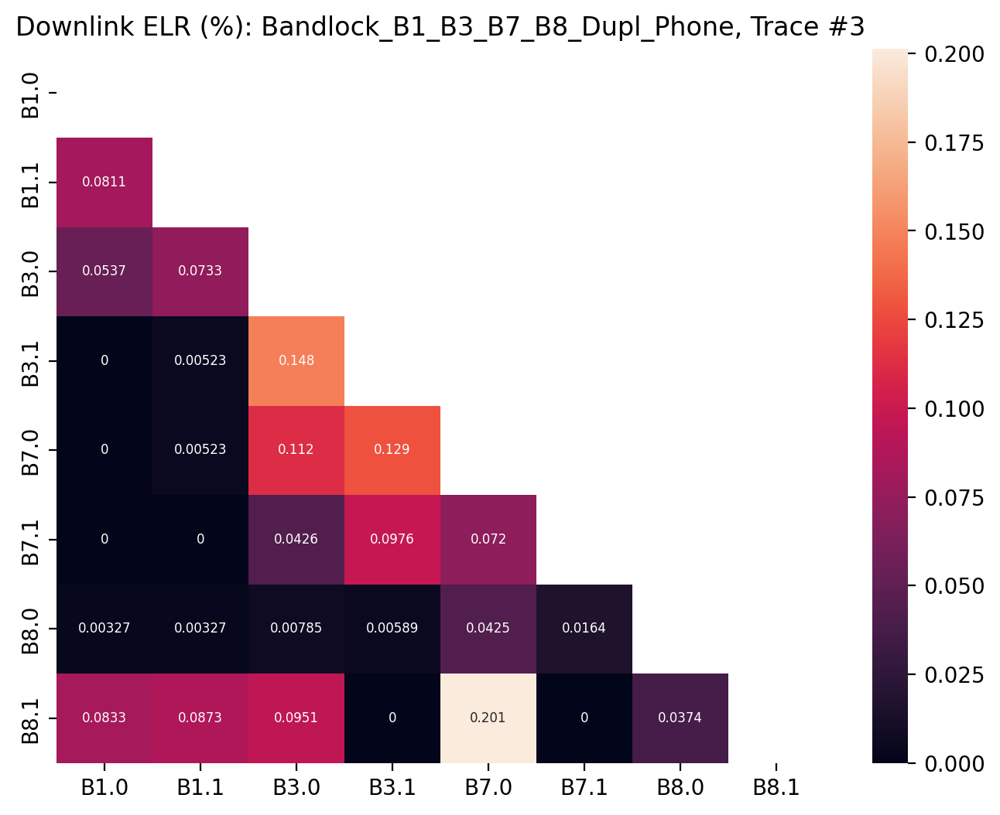

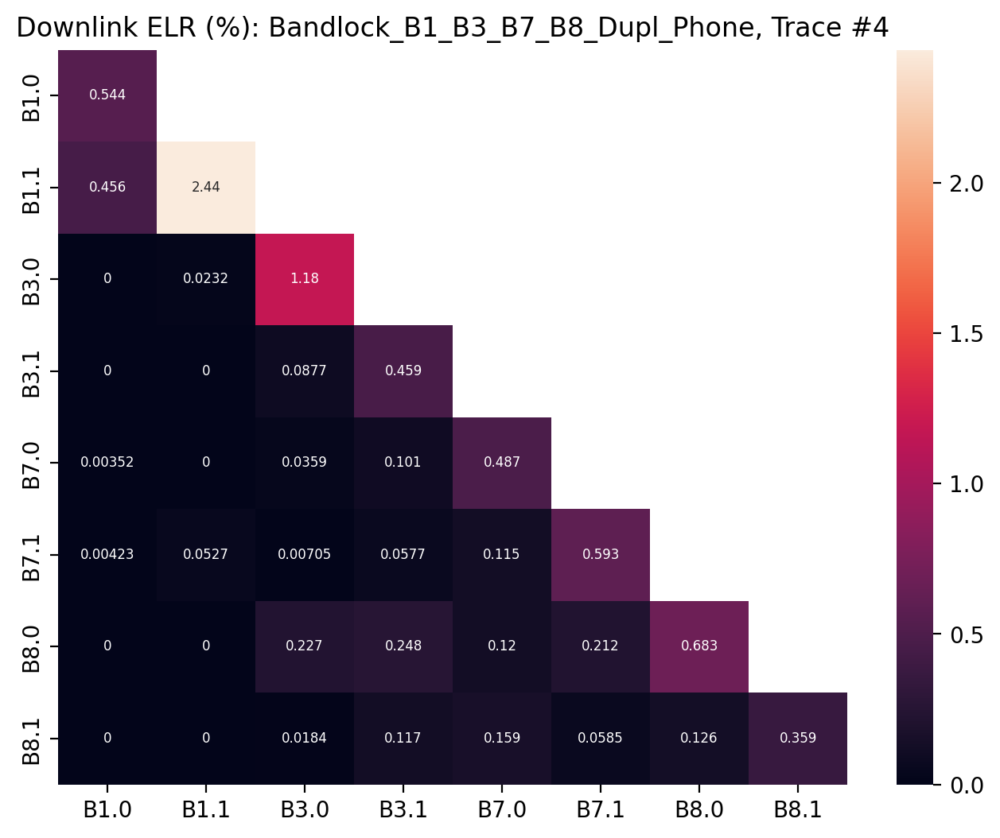

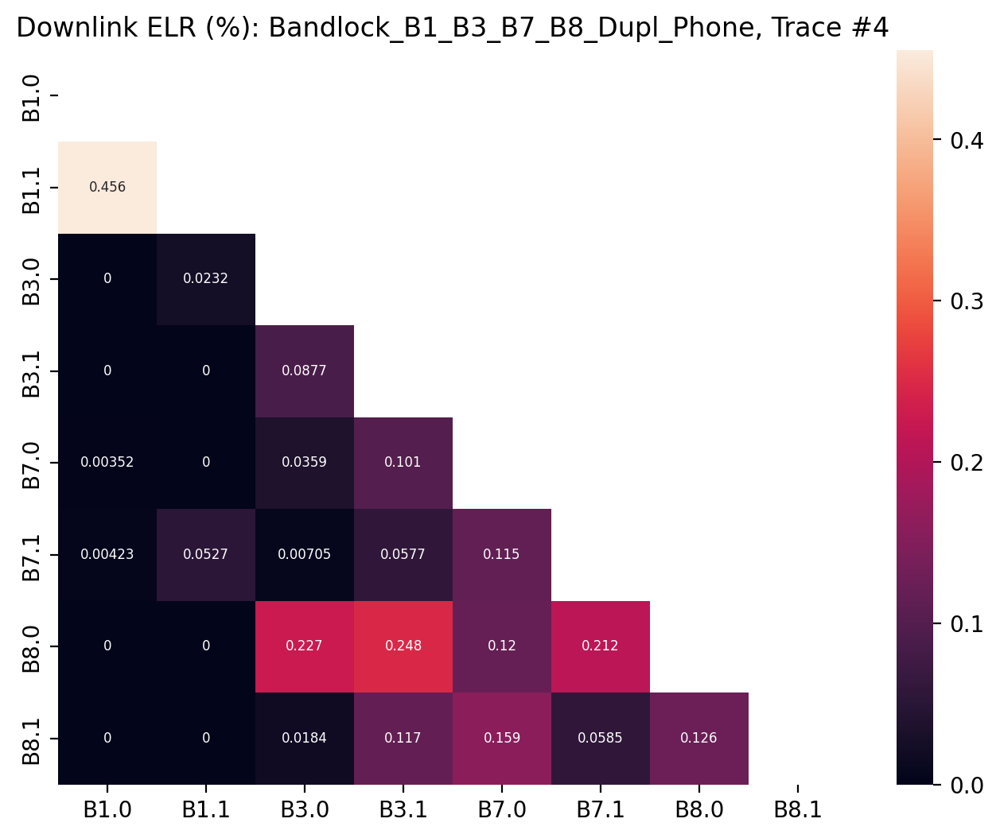

Bandlock_All_B3_B7_B8_Dupl_Phone


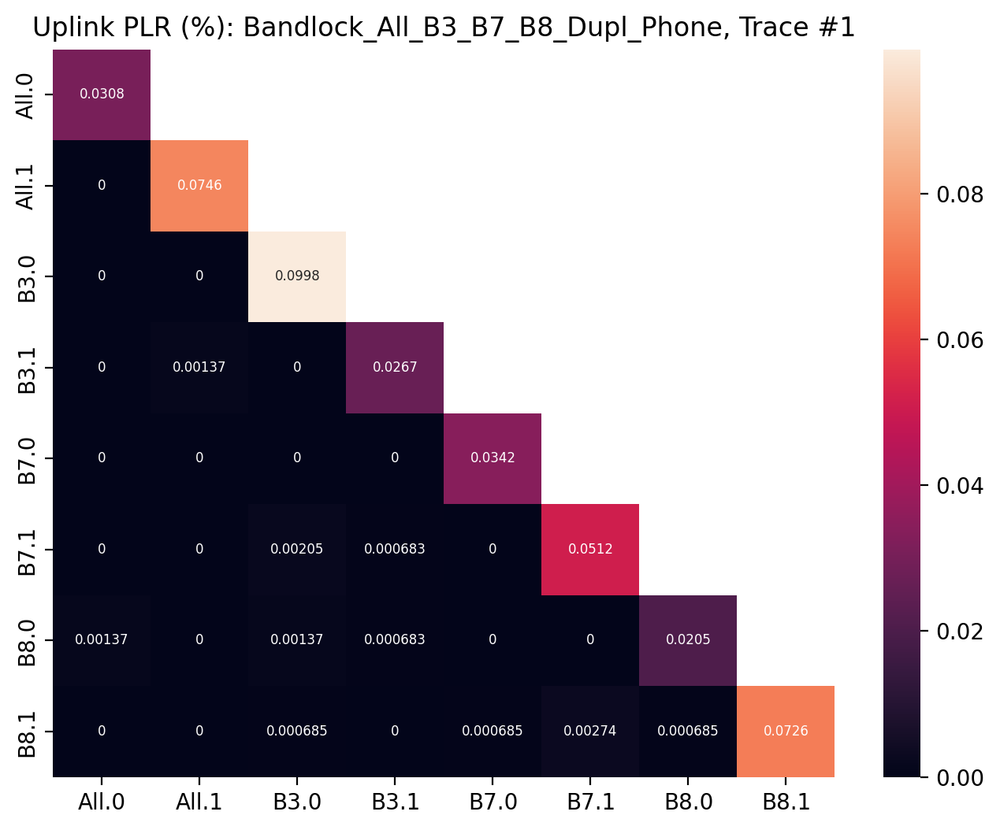

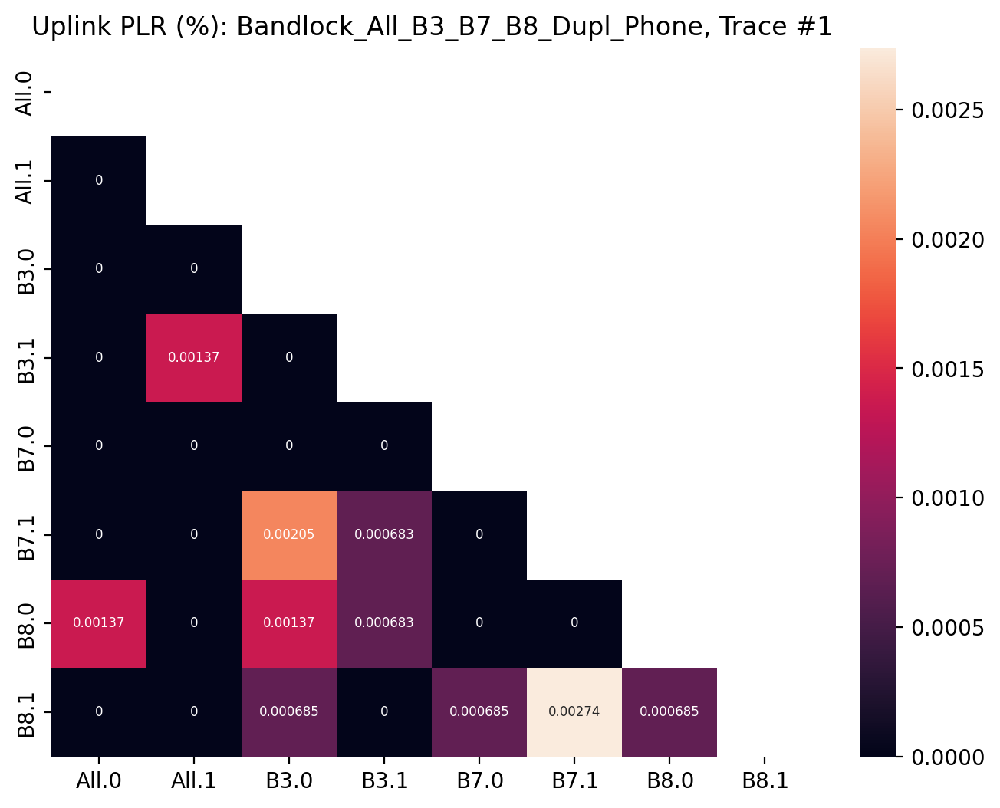

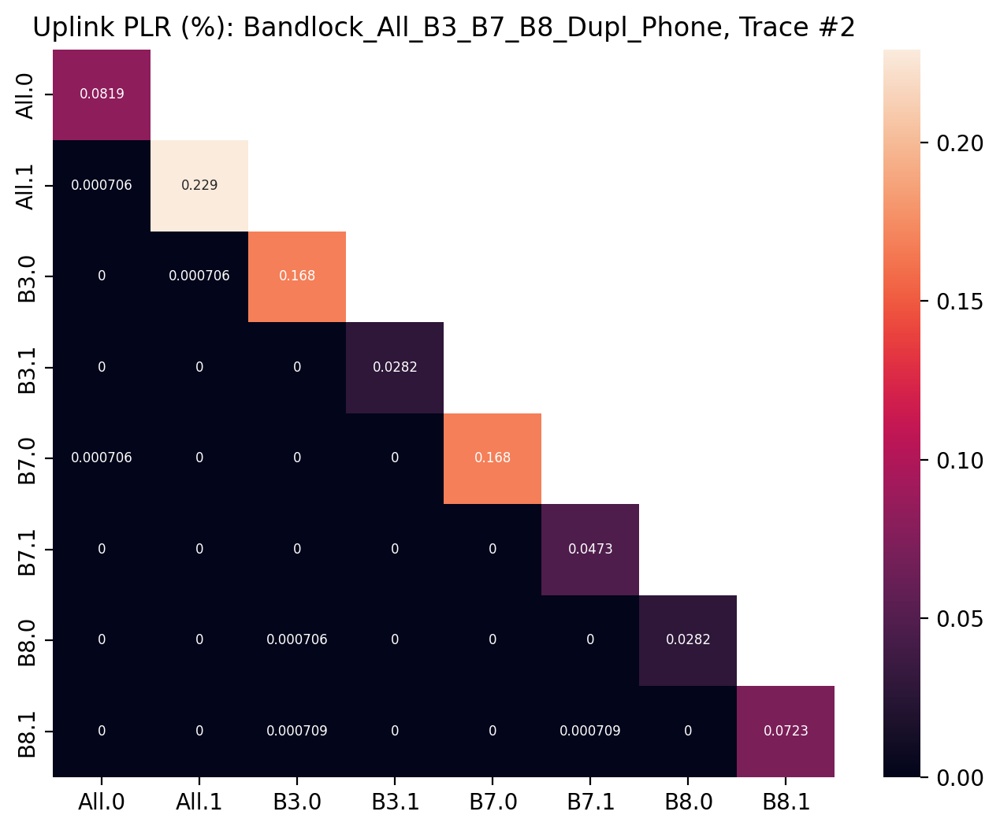

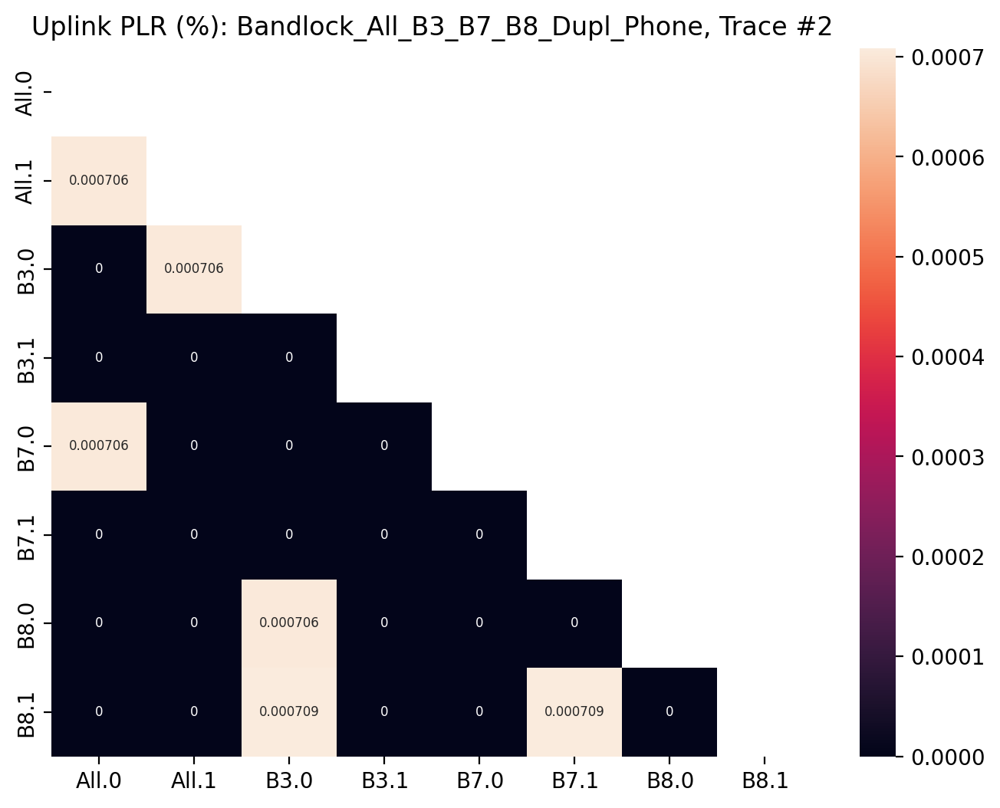

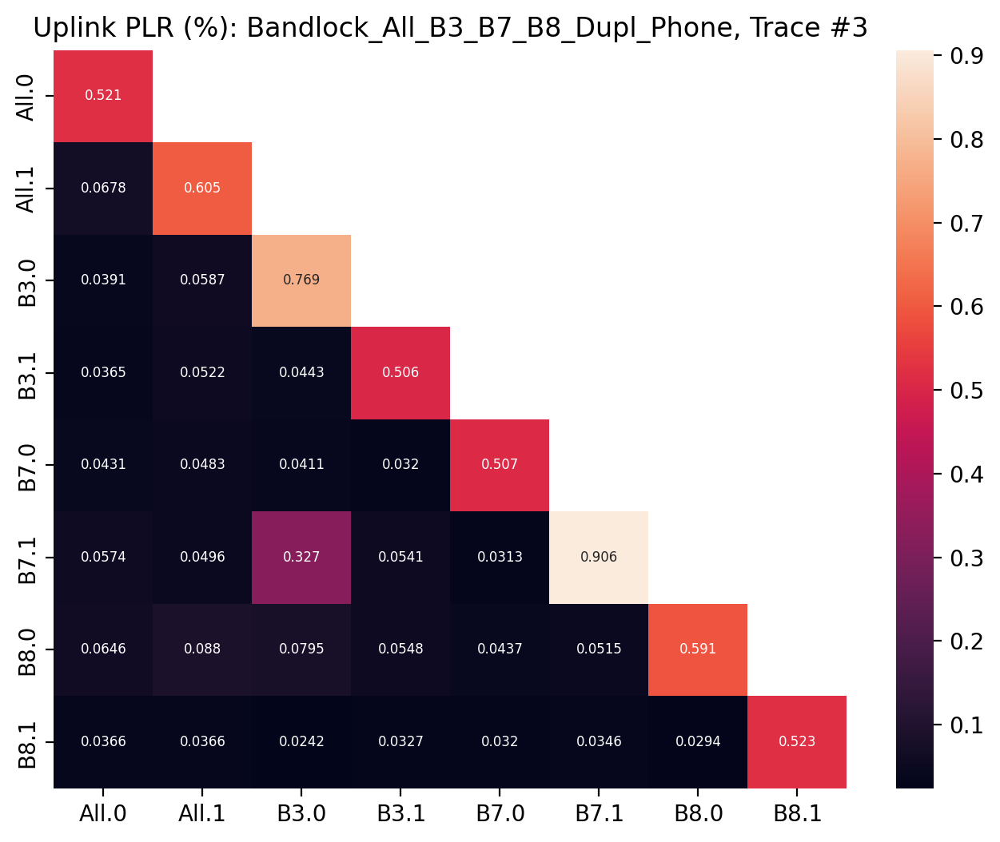

...

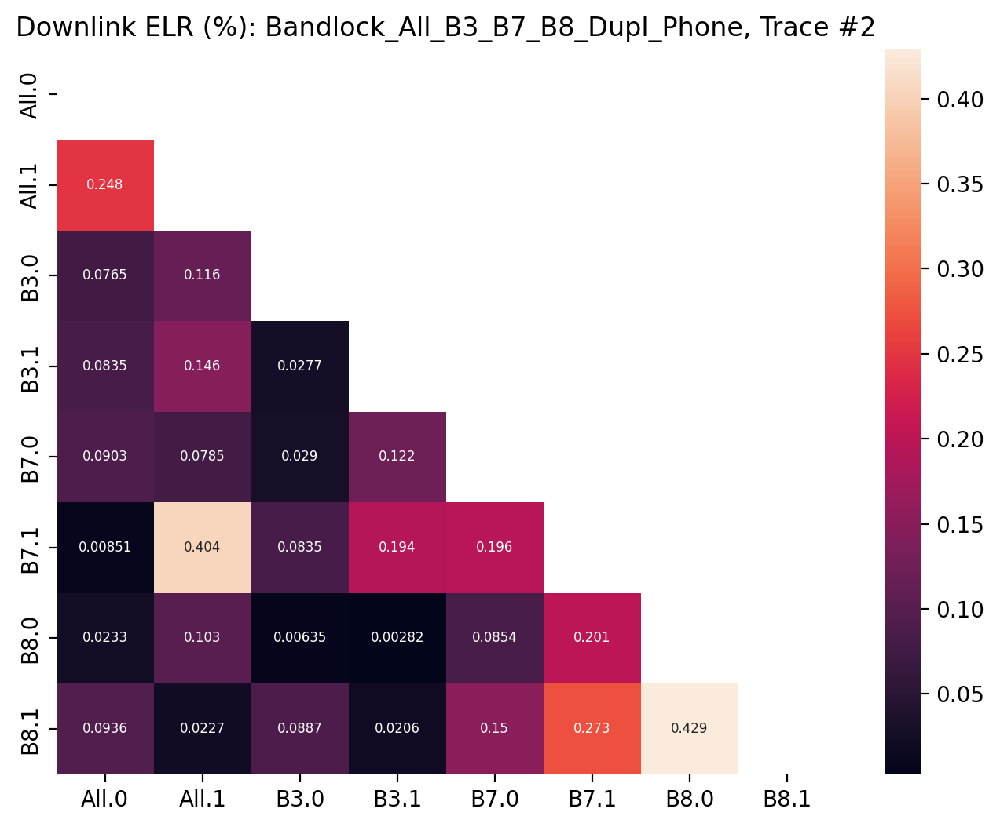

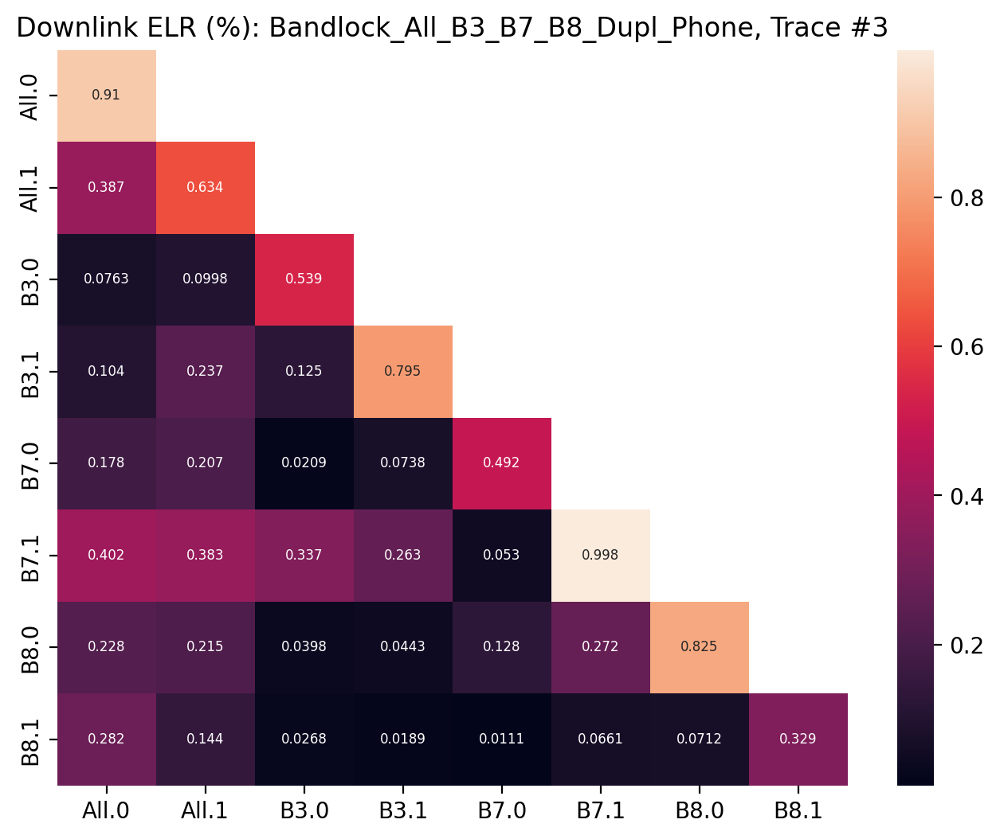

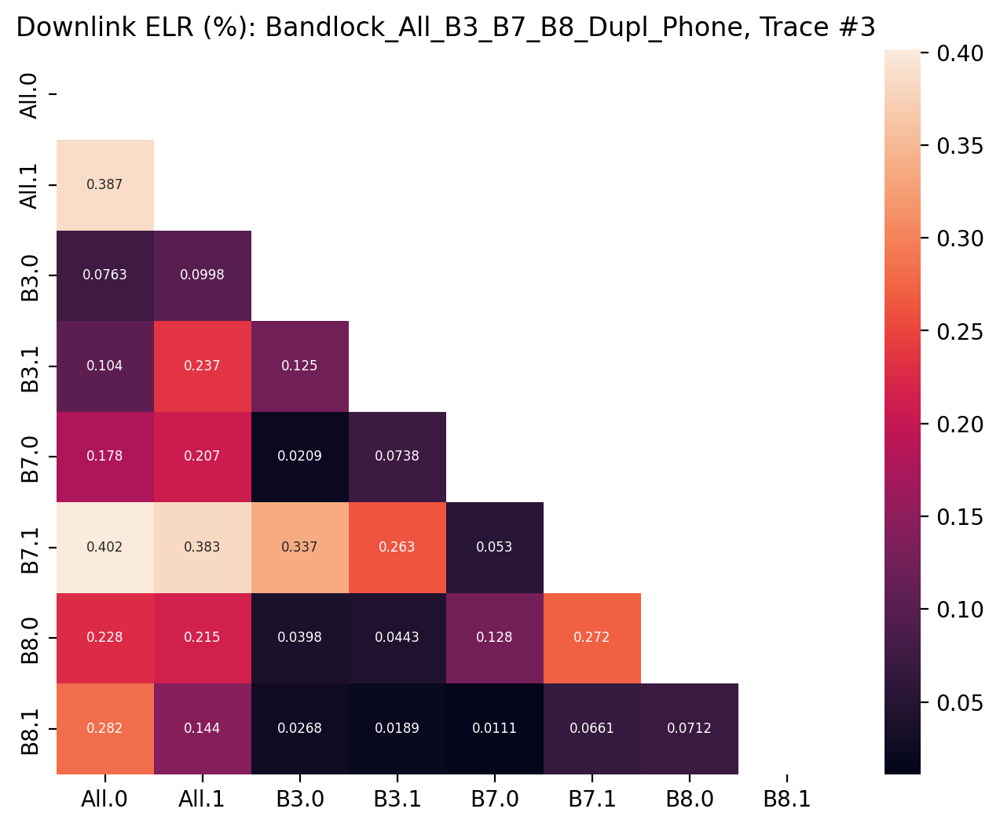

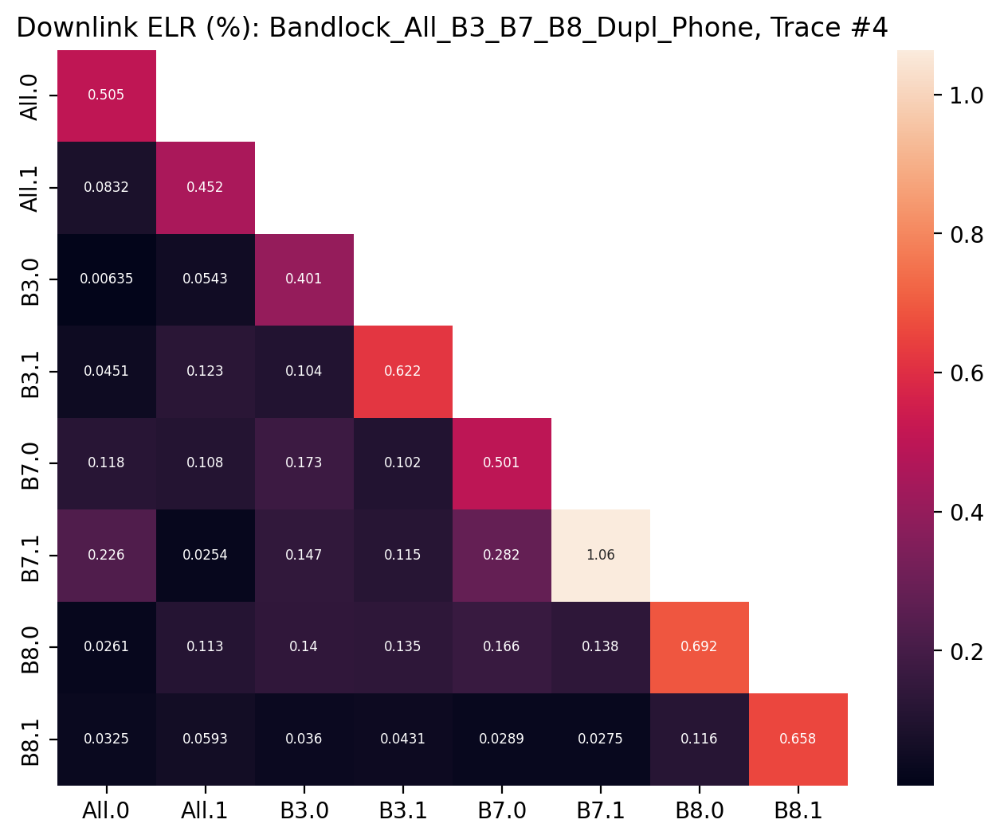

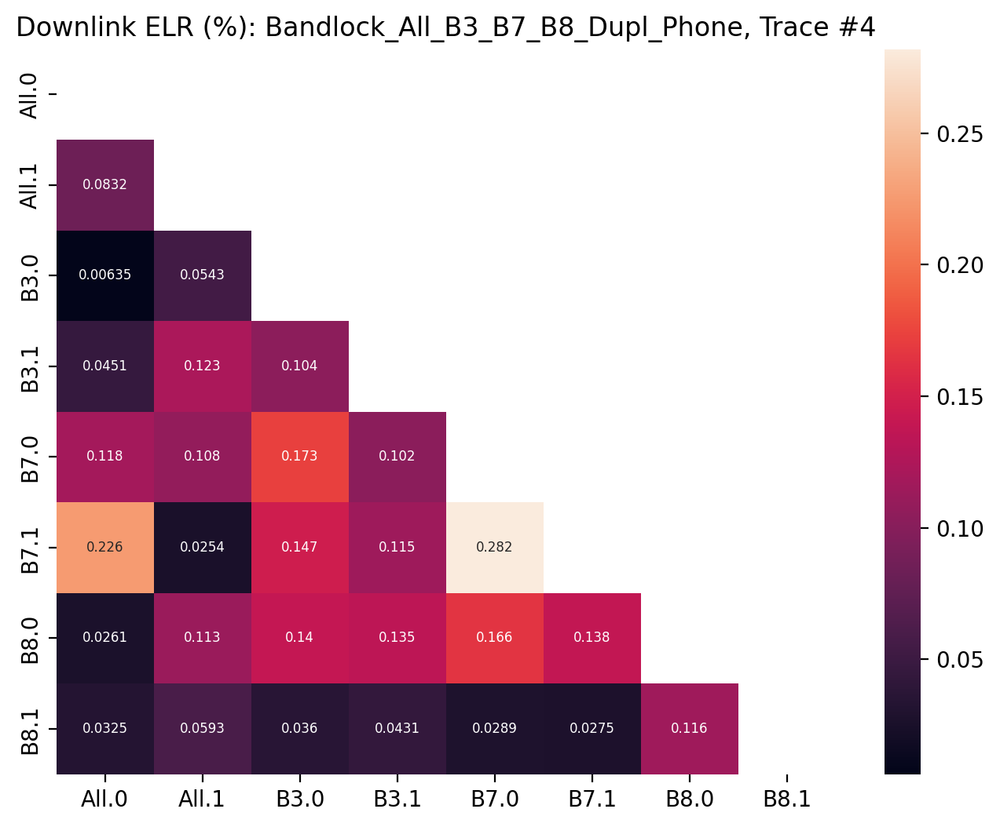

Bandlock_LTE_B3_B7_B8_Dupl_Phone


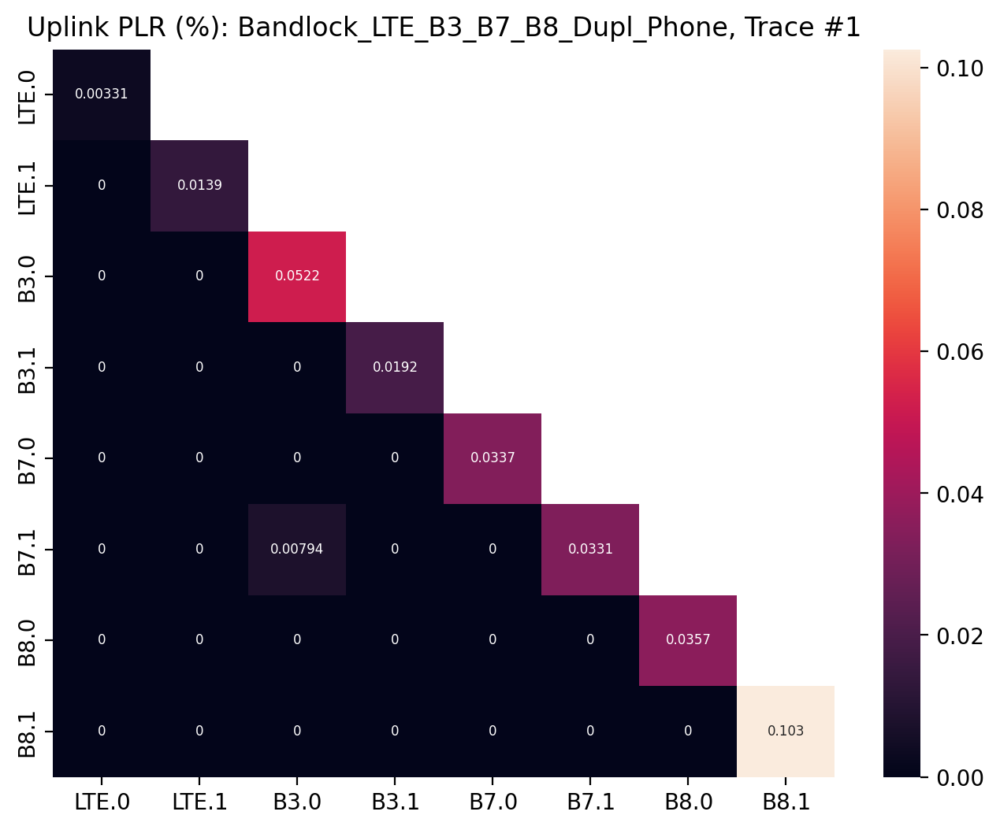

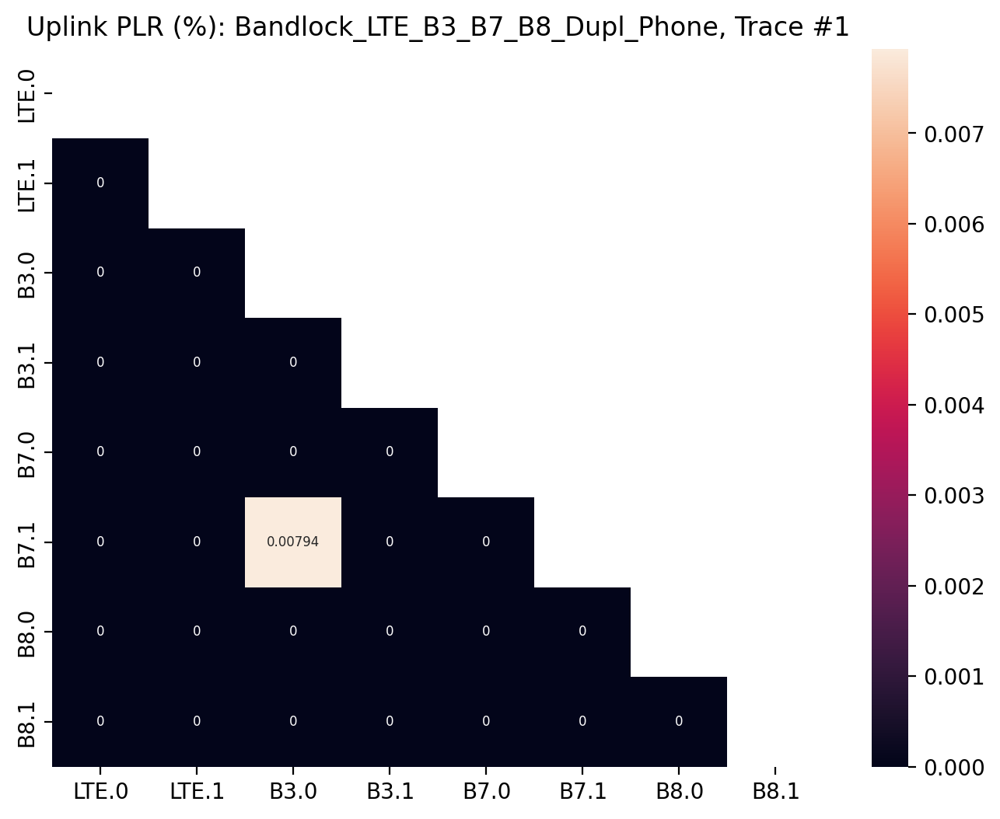

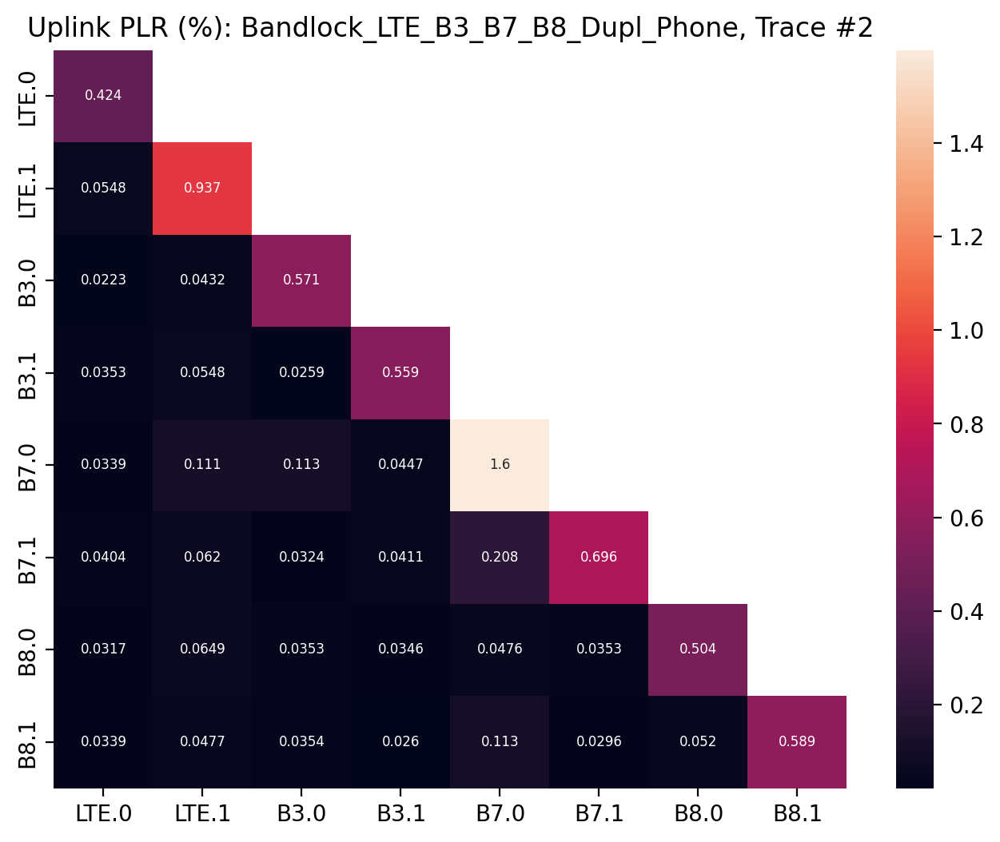

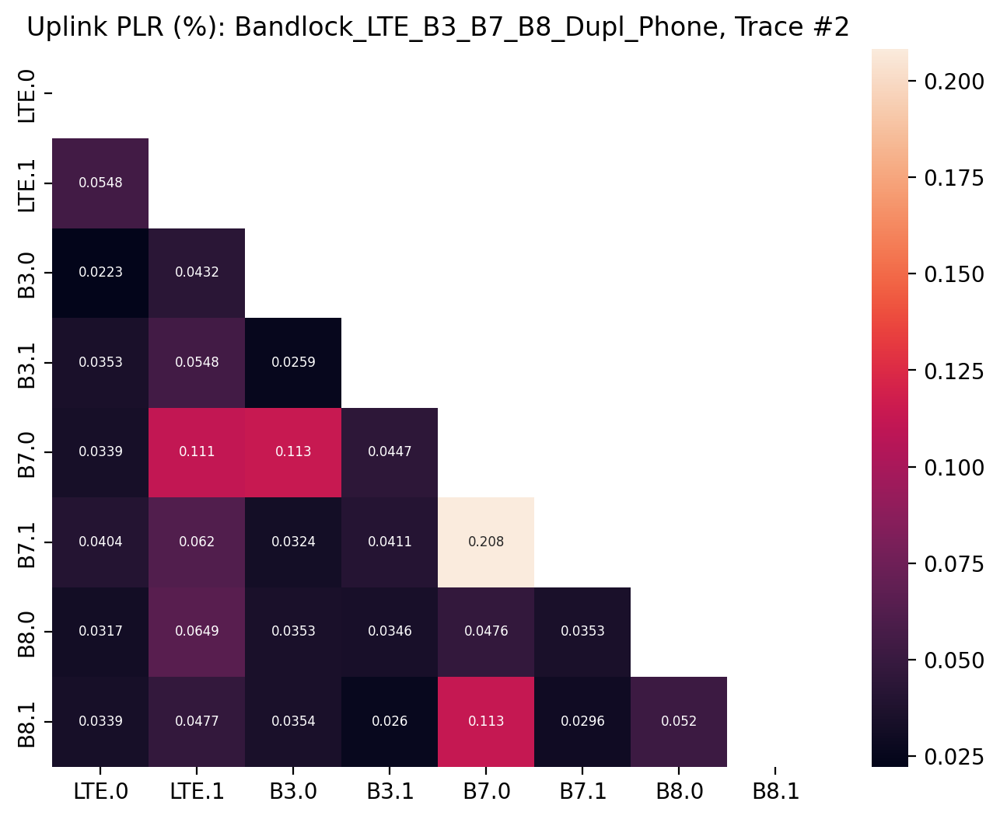

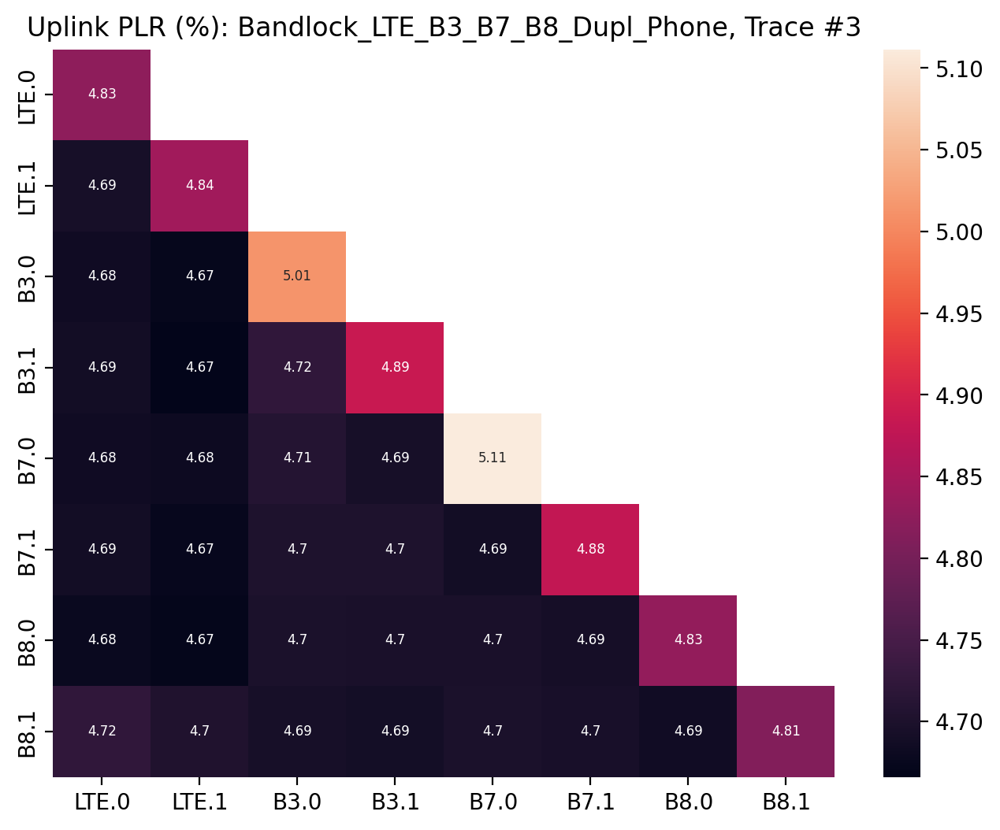

...

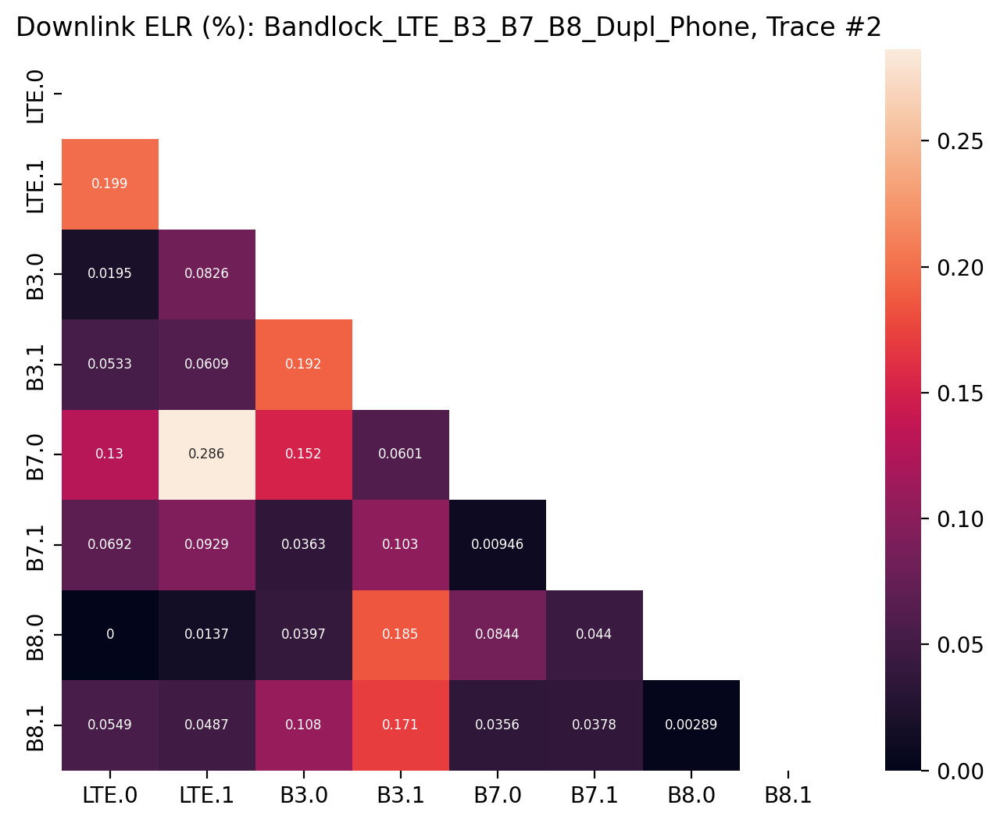

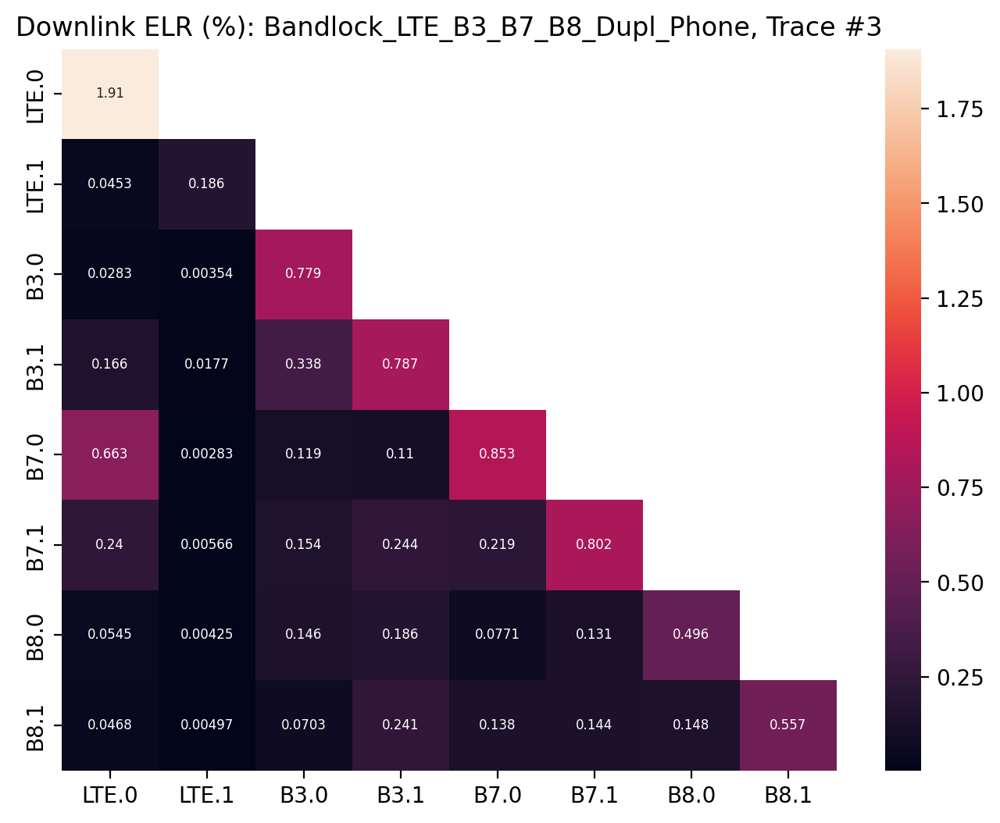

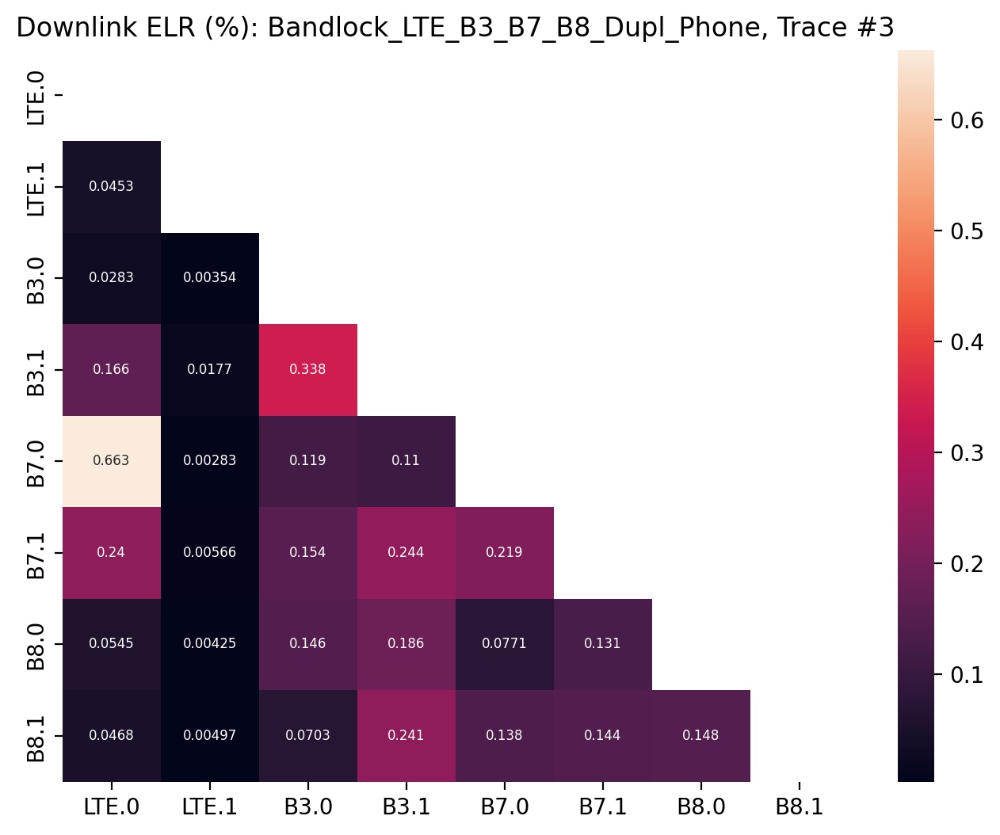

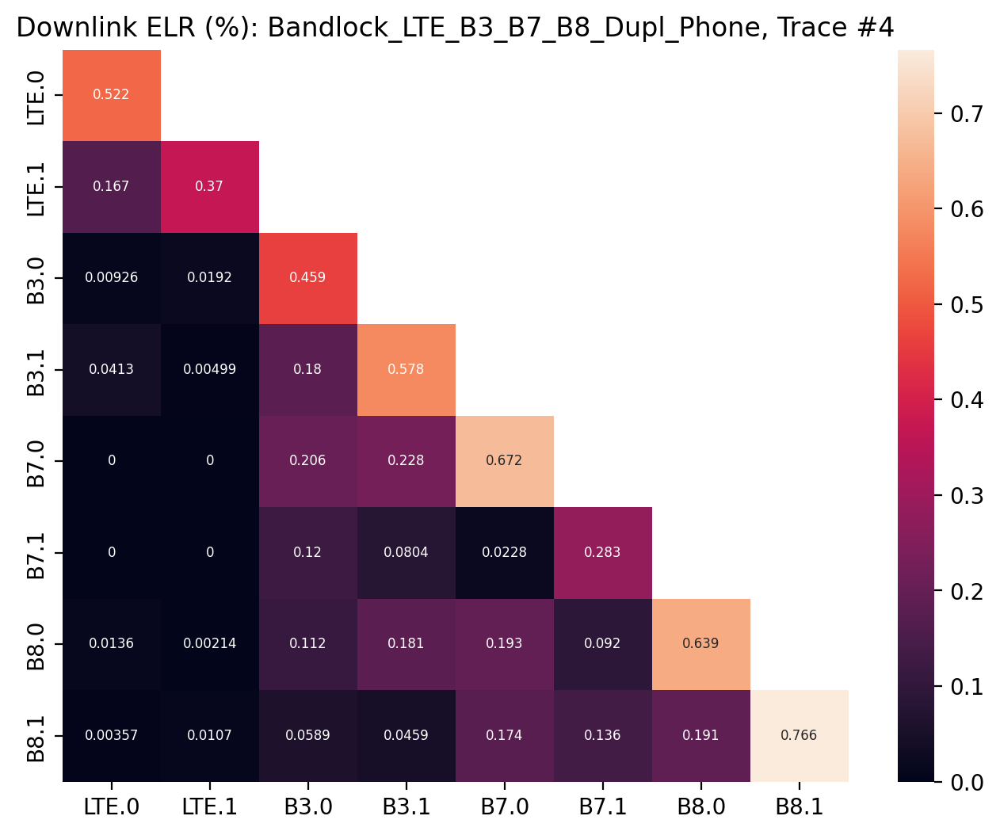

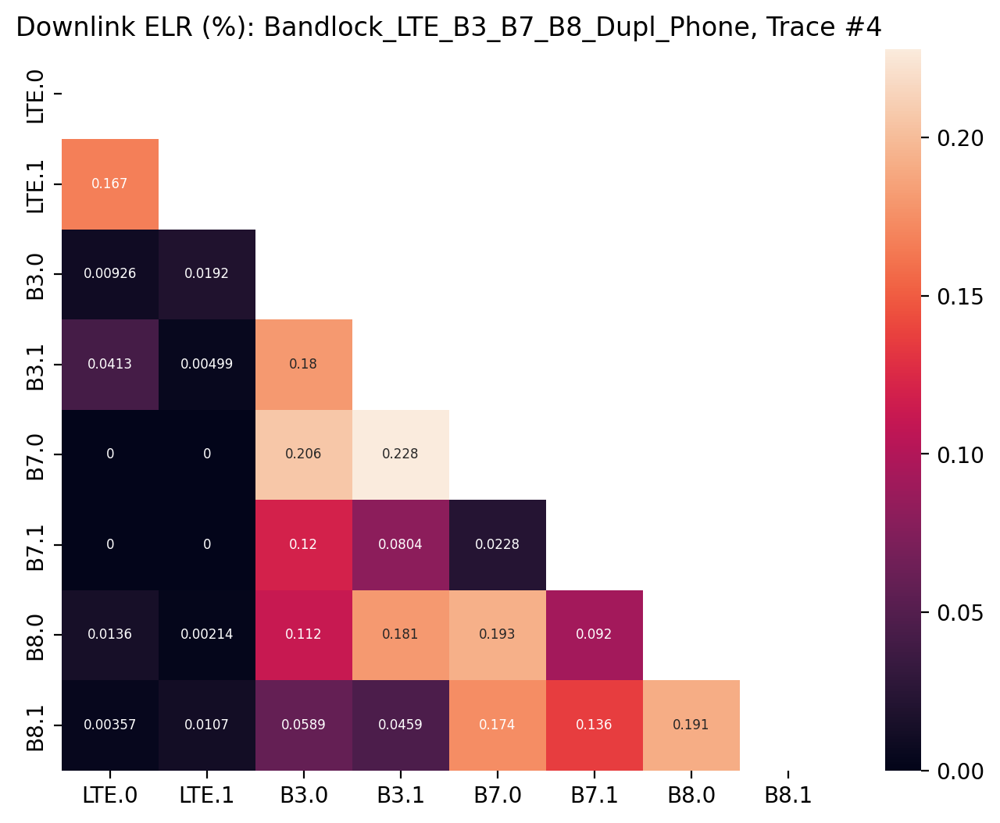

Bandlock_LTE_LTEb3_LTEb7_LTEb8_Dupl_Phone


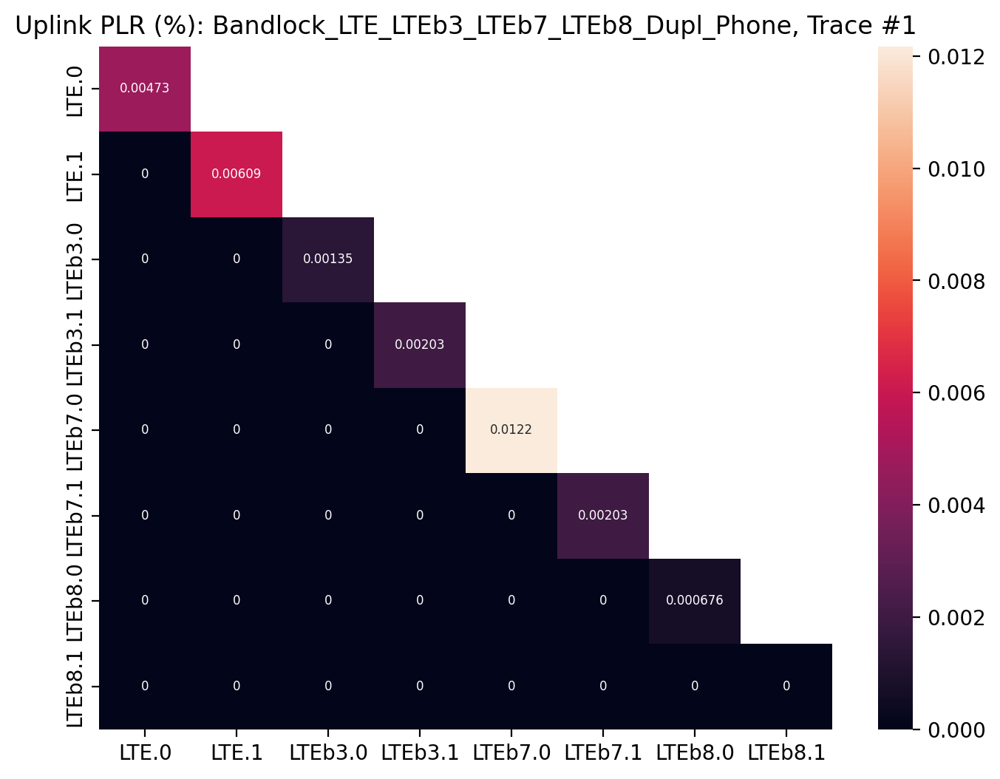

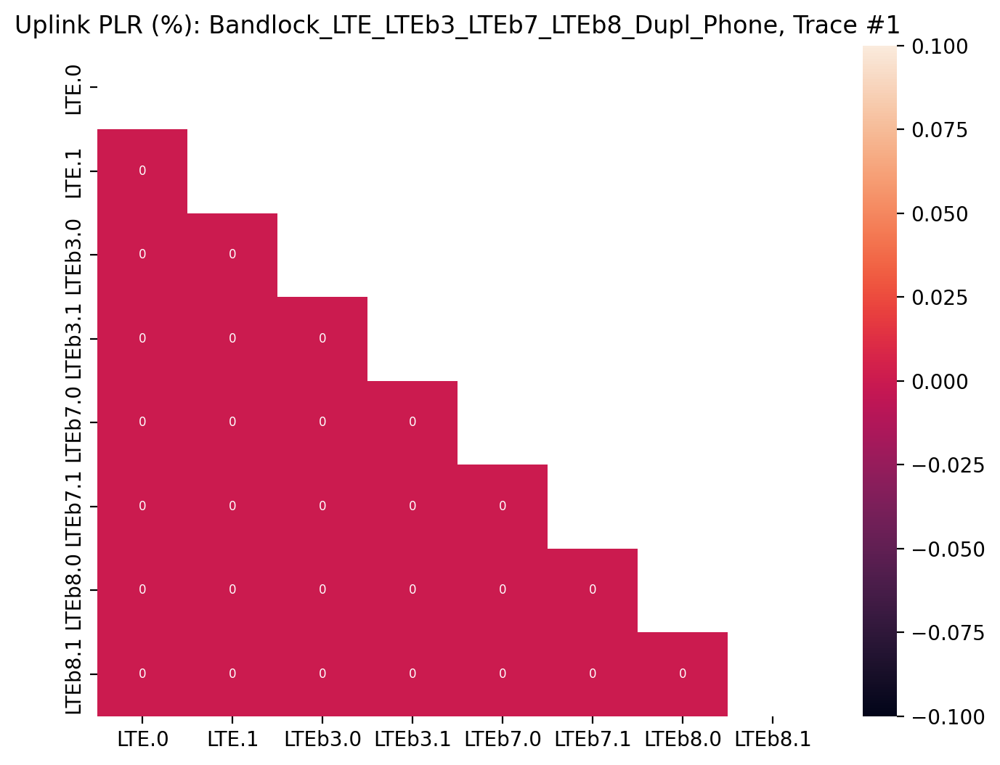

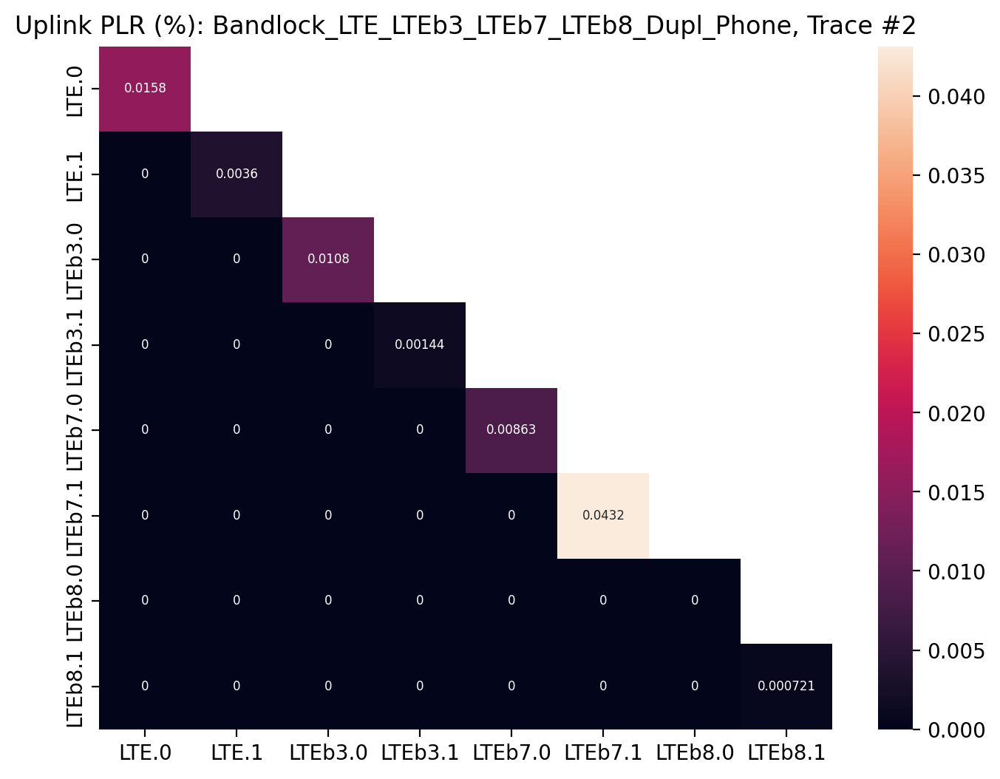

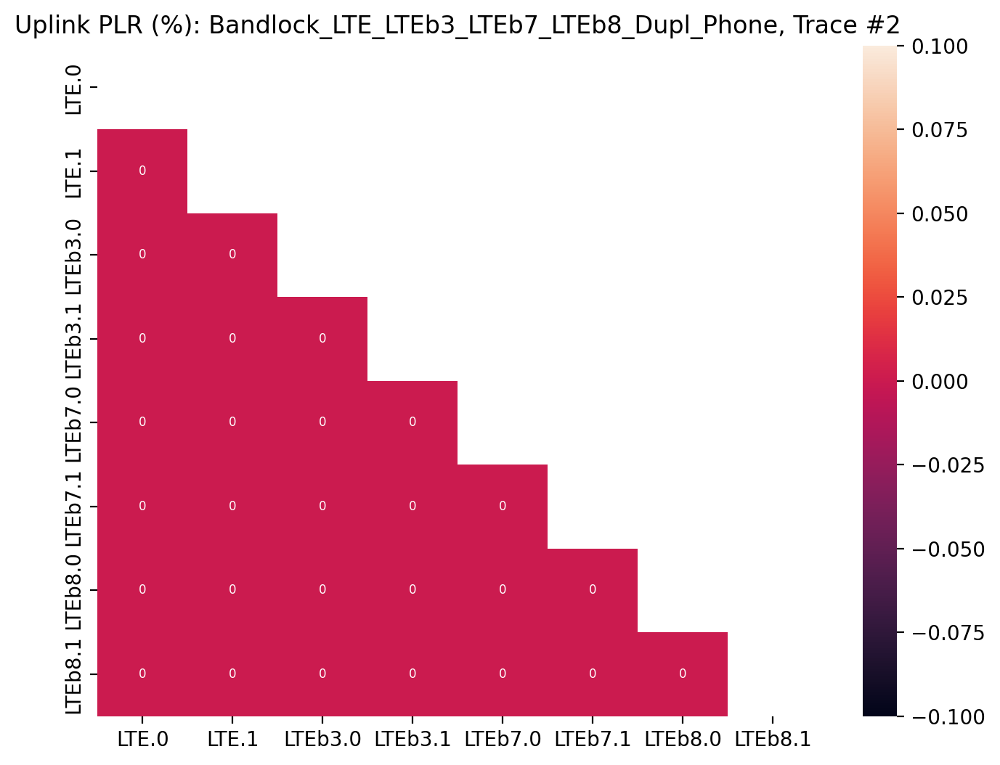

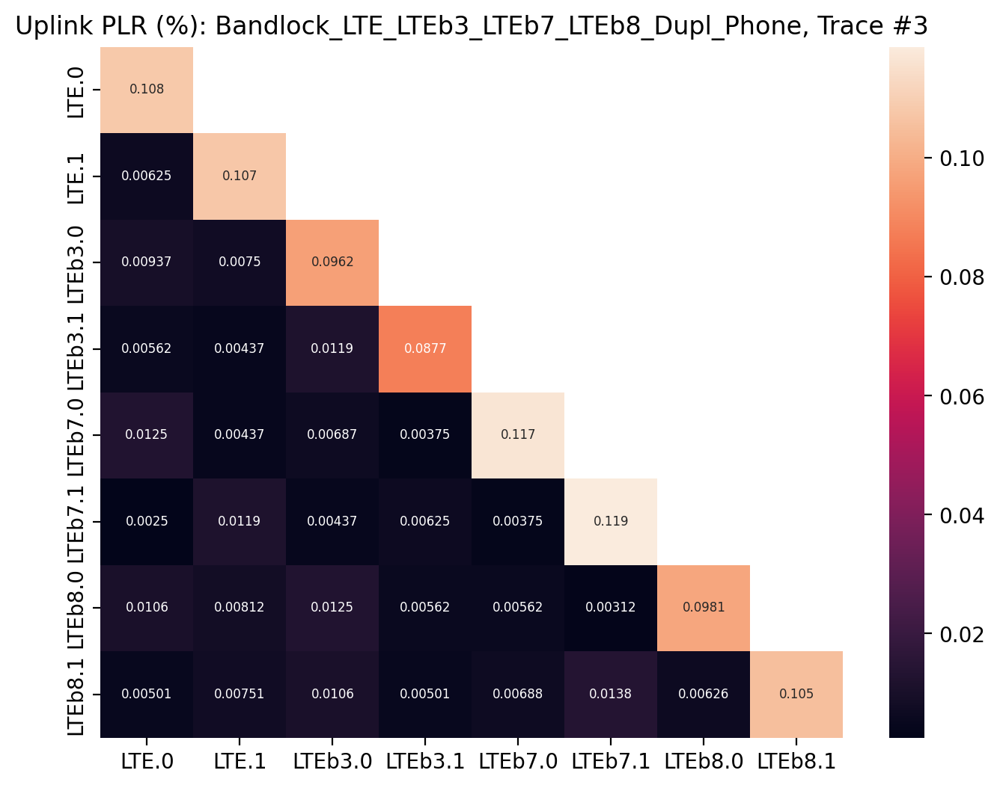

...

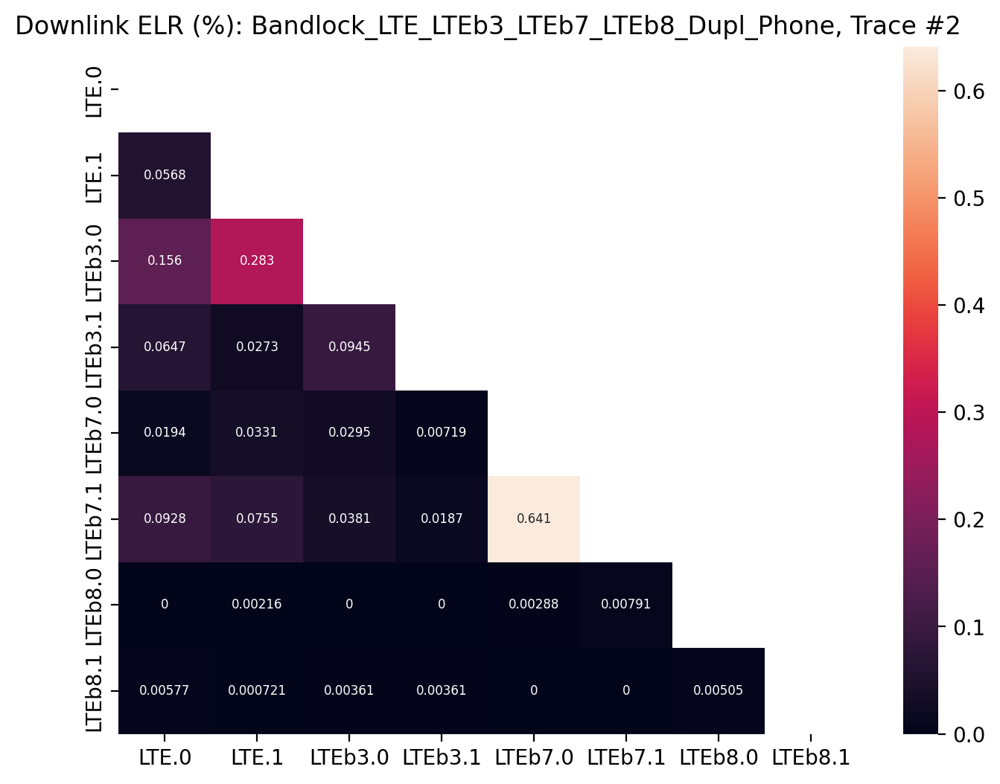

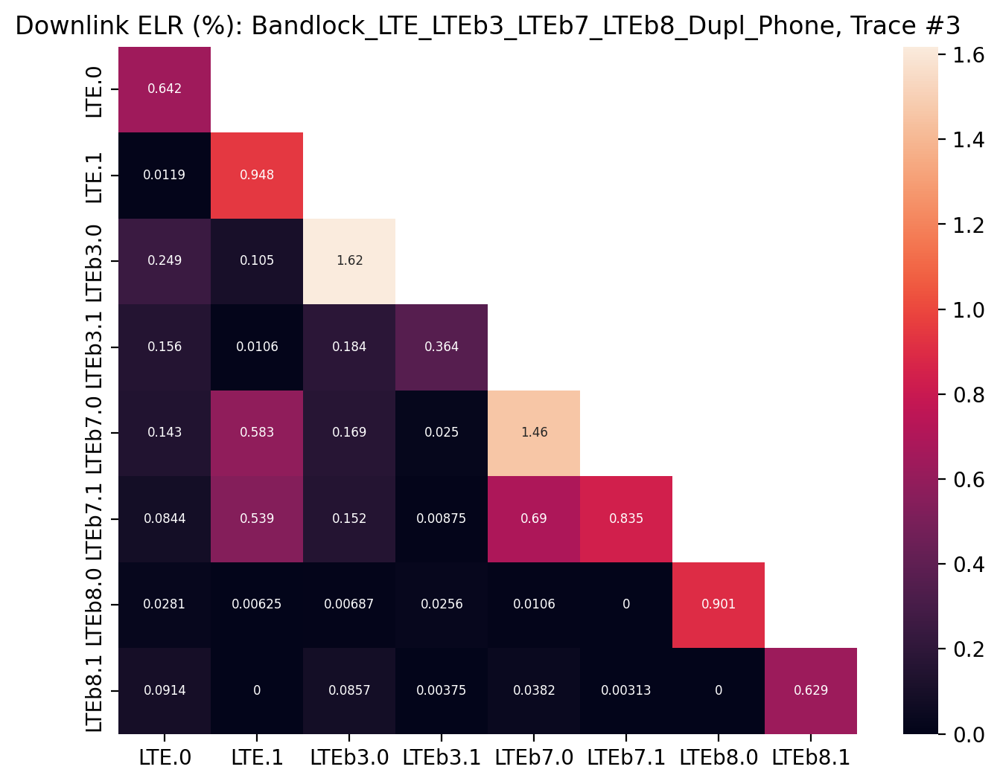

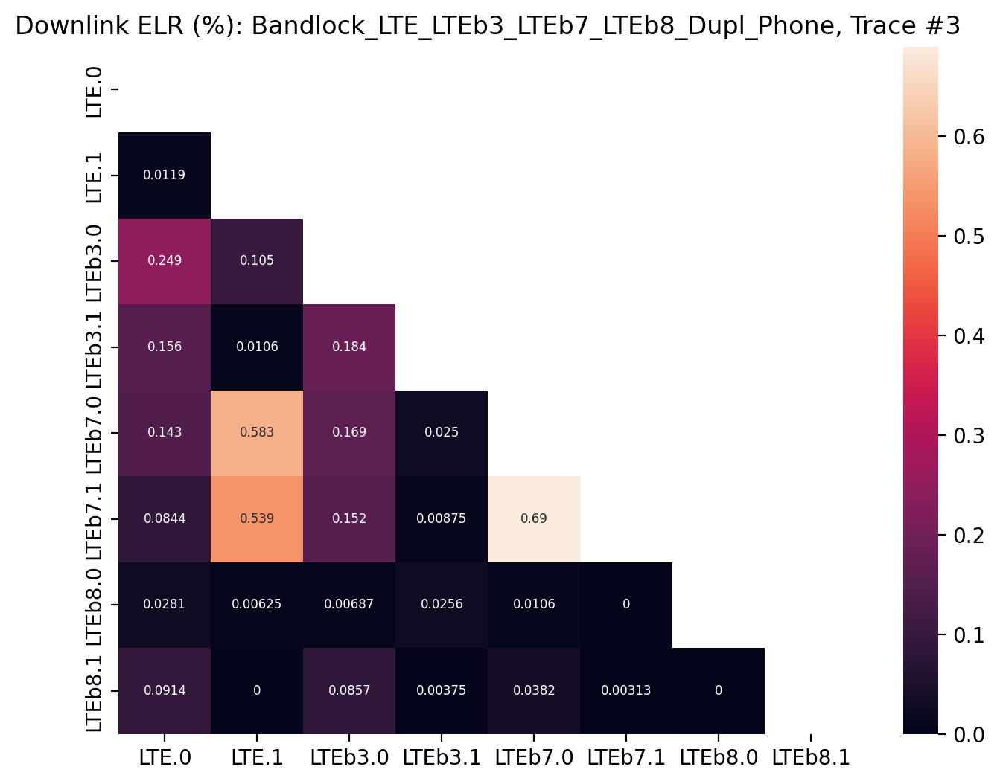

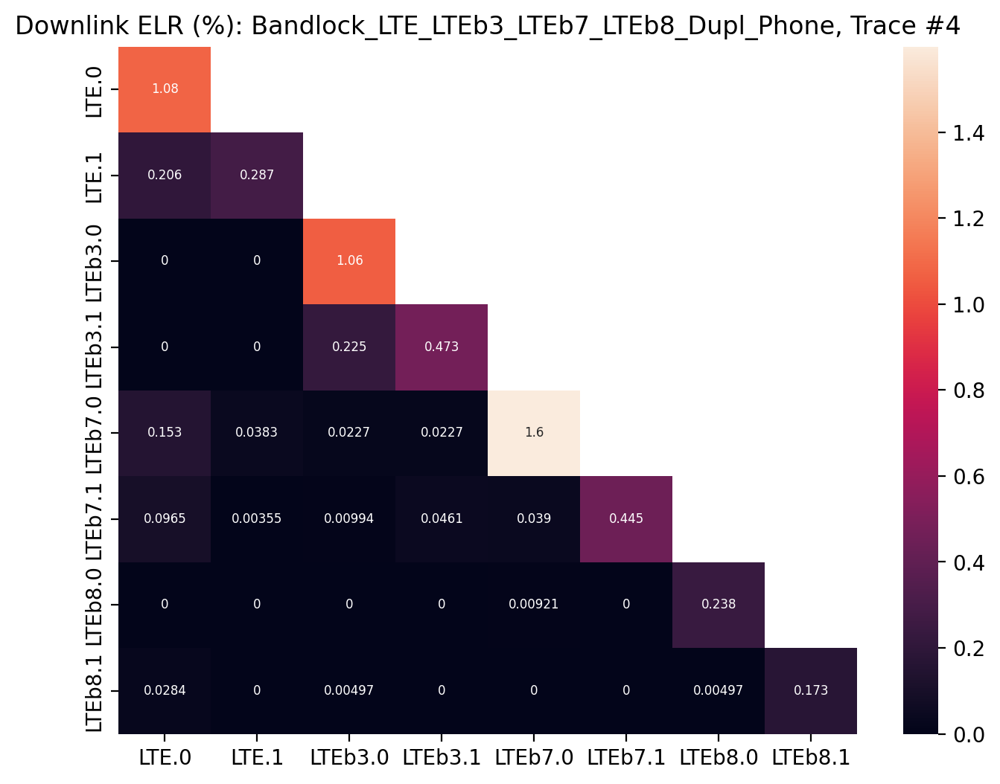

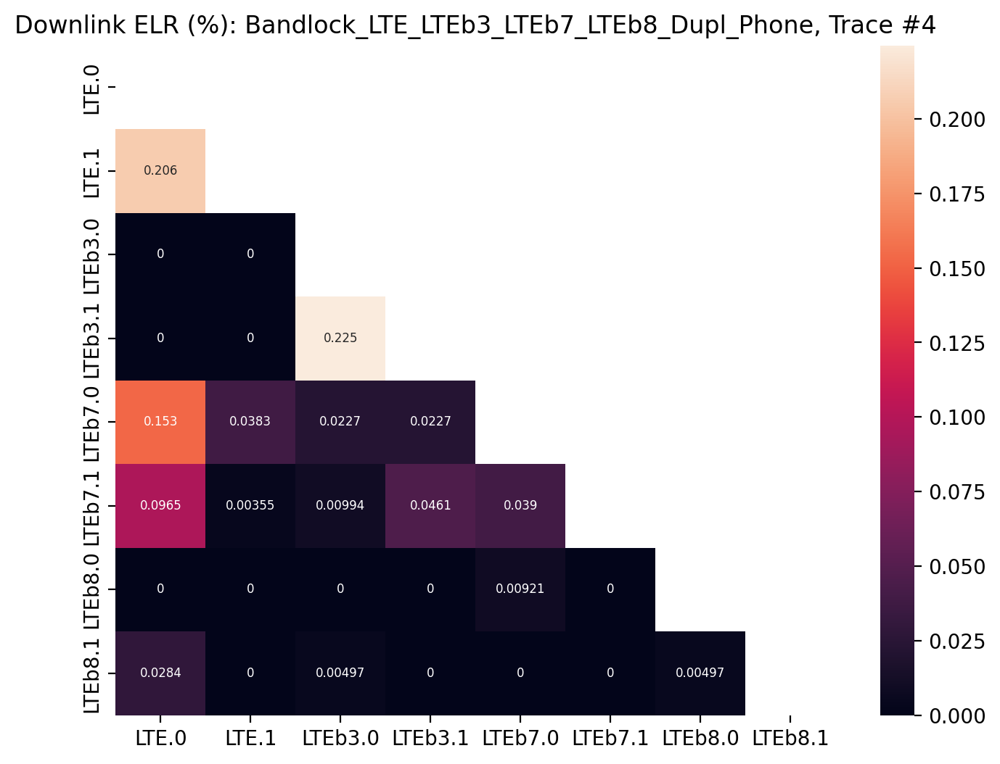

Bandlock_LTEb1_LTEb3_LTEb7_LTEb8_Dupl_Phone


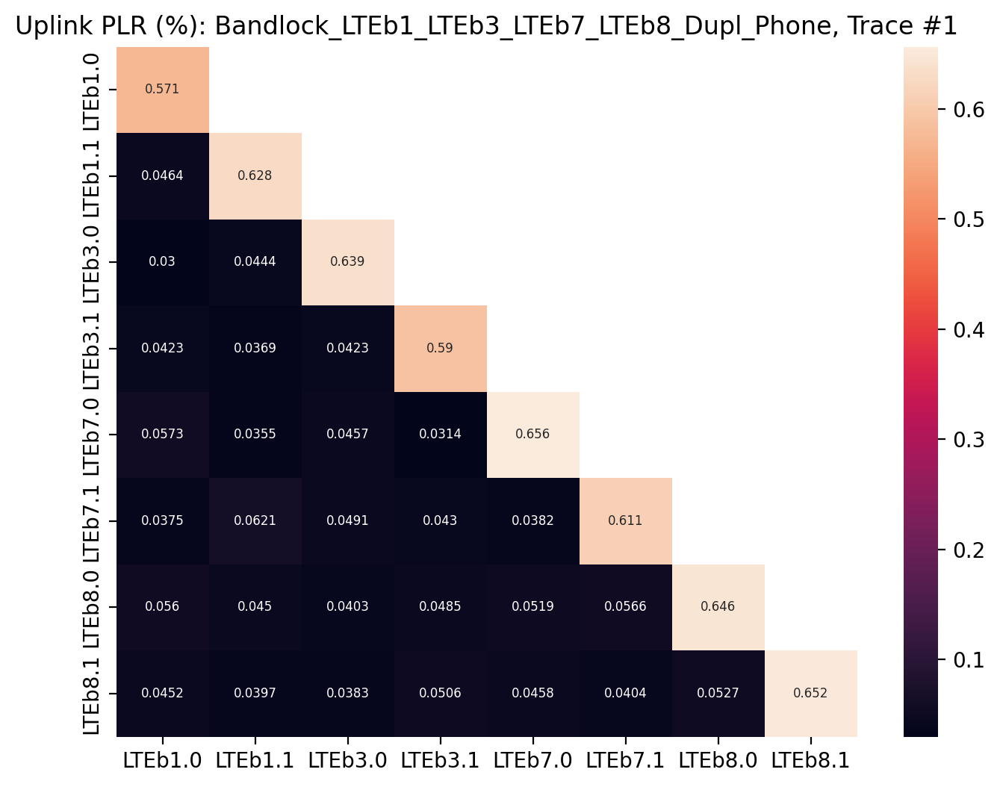

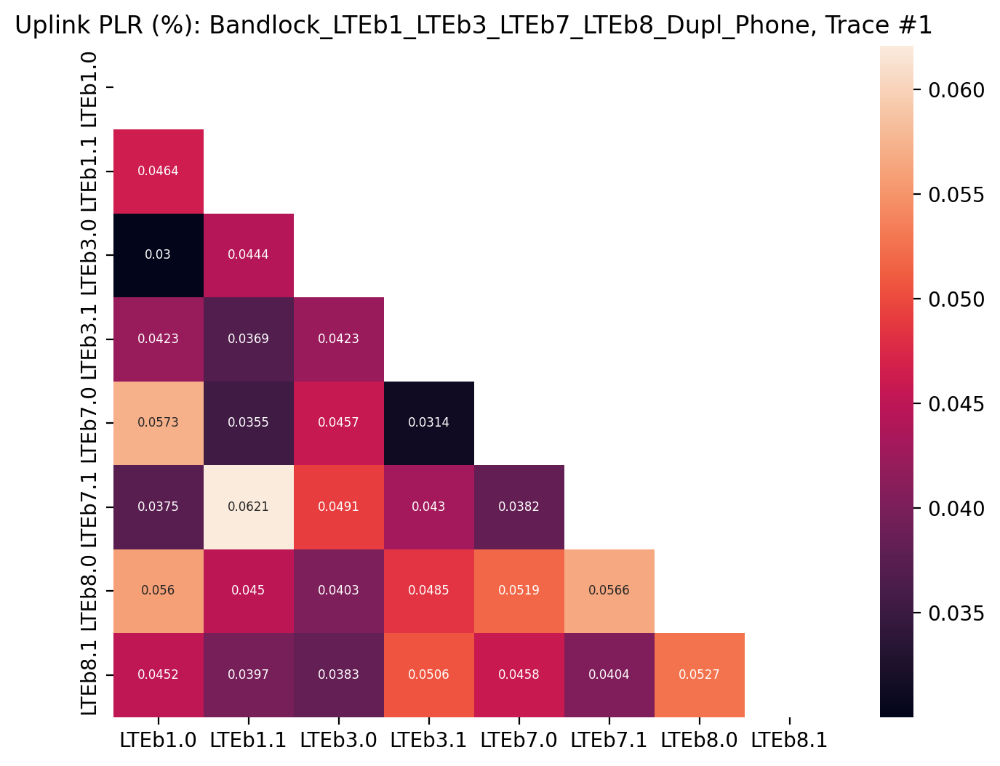

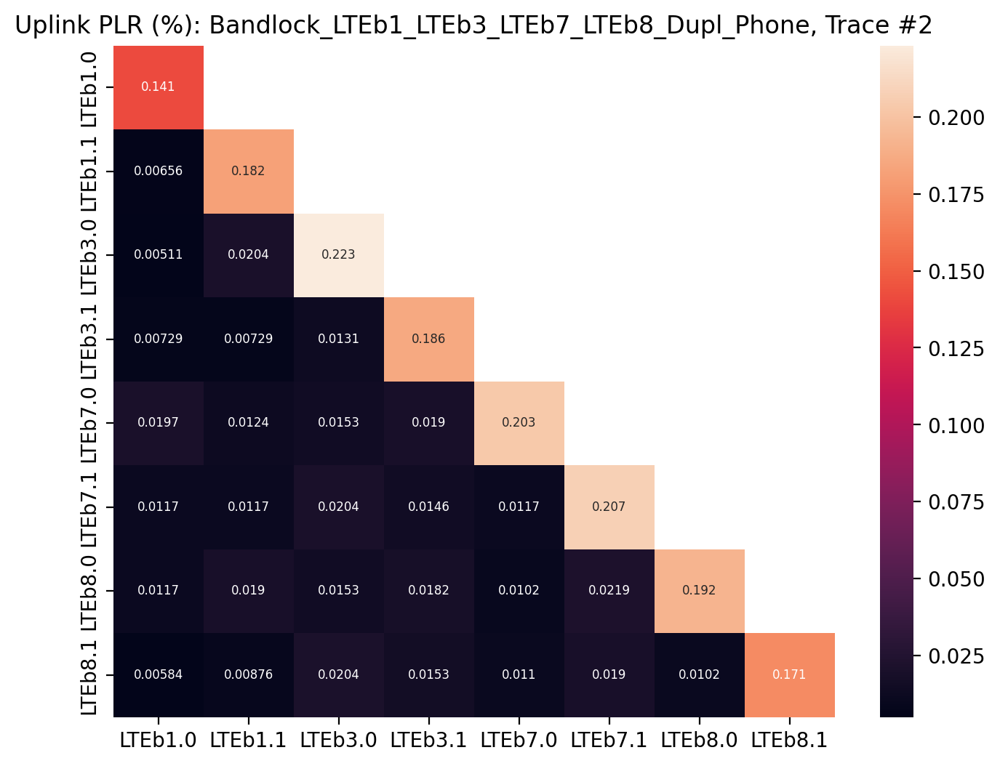

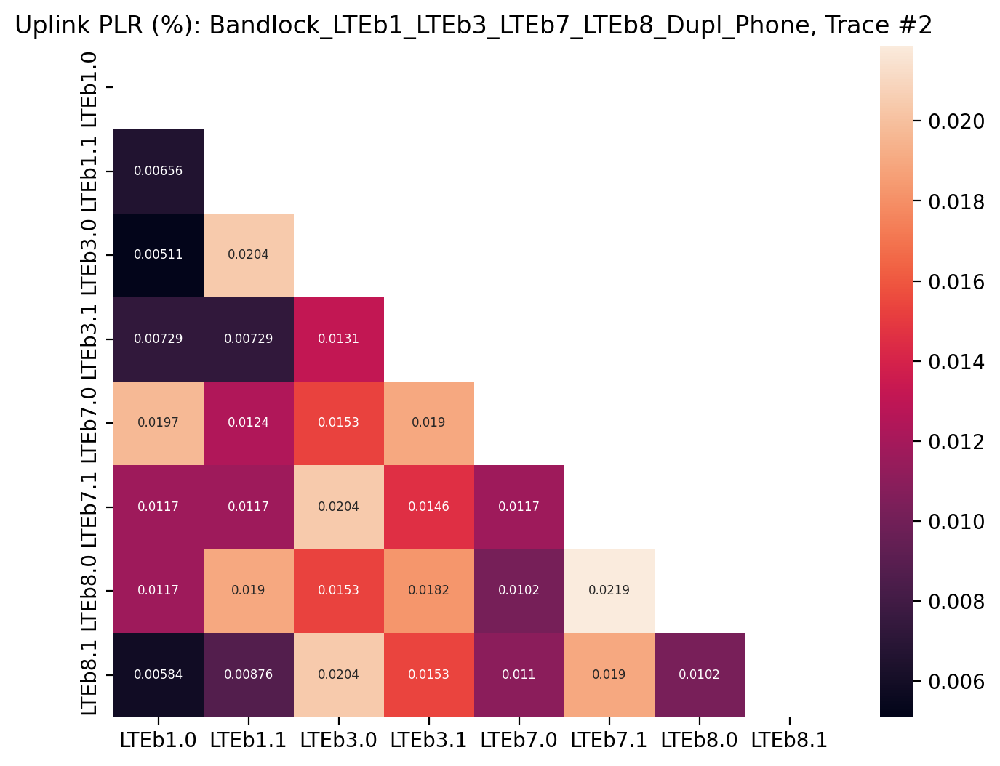

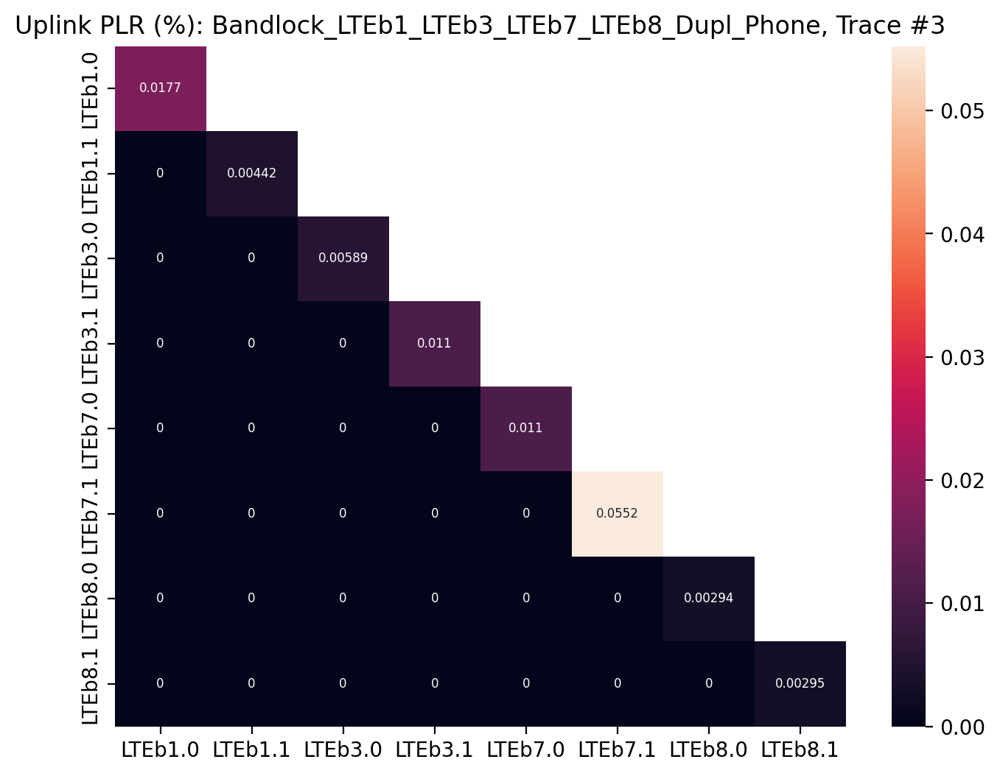

...

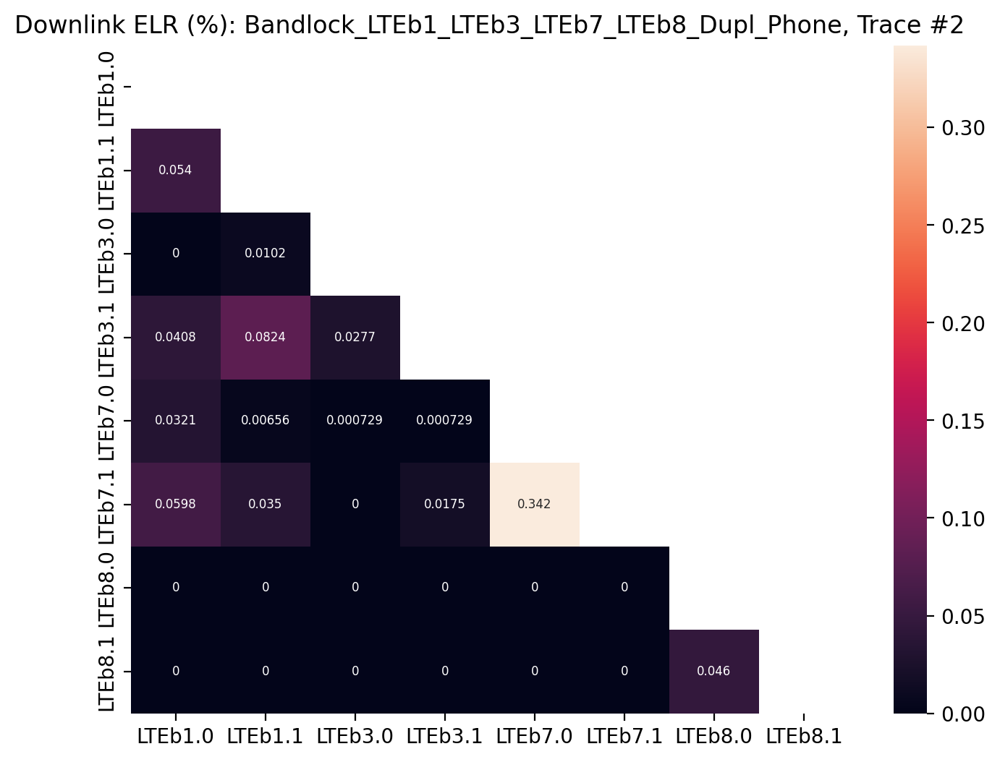

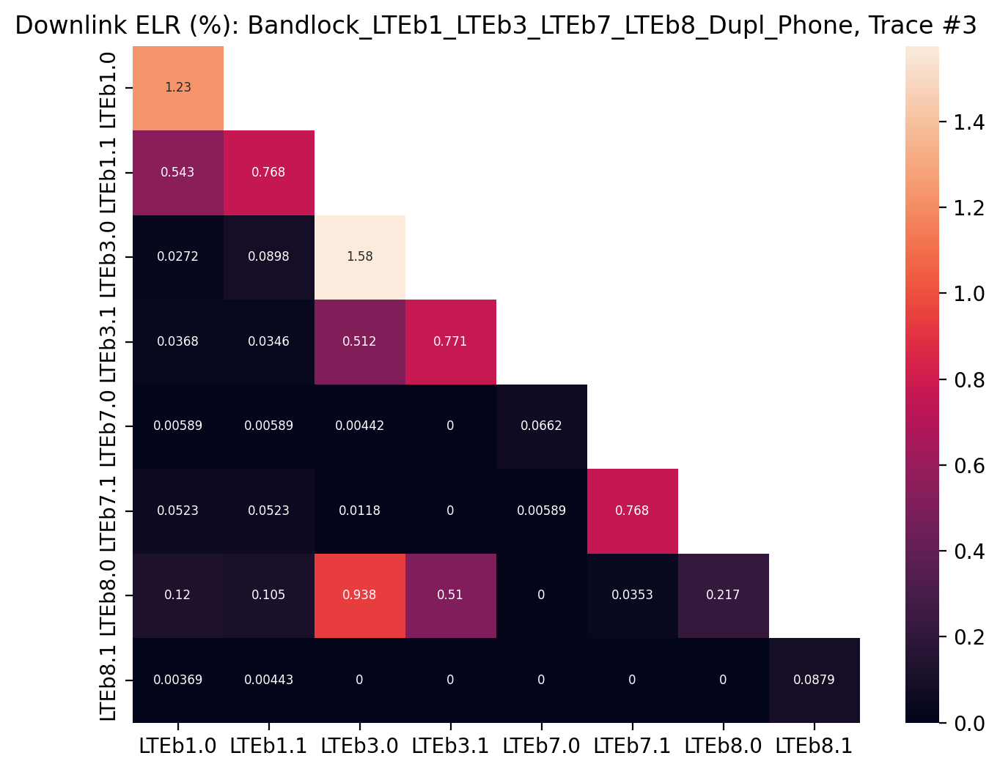

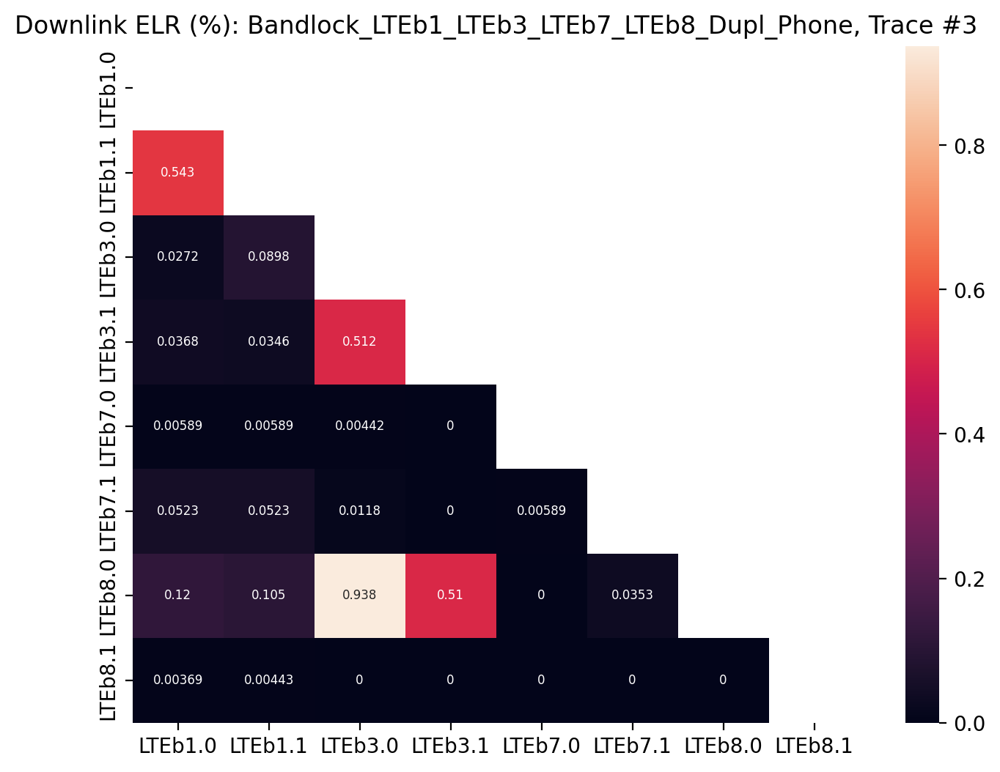

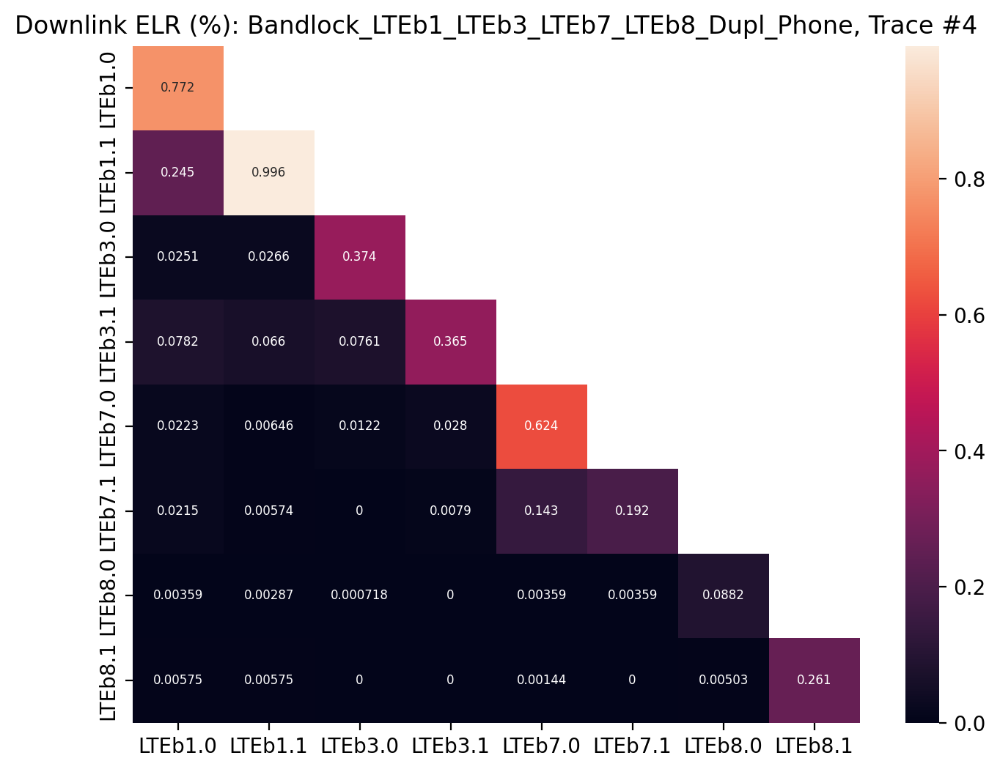

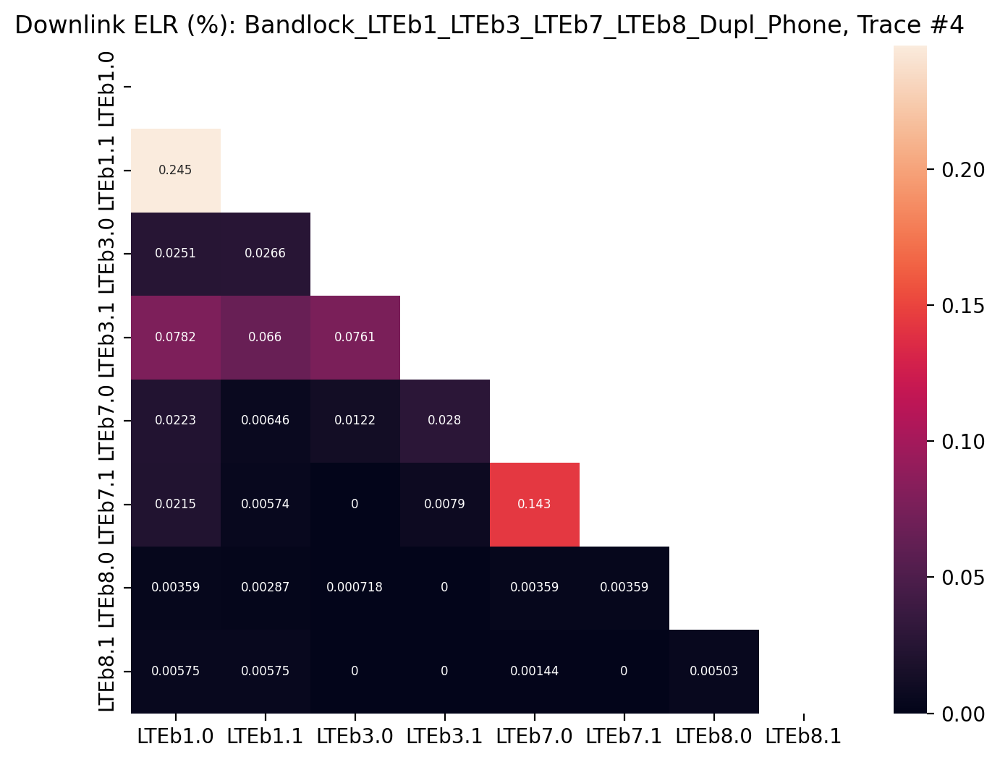

In [9]:
output_path = './heatmaps1'

for exp in exp_list:
    dirname = exp.dirname
    devices = list(exp.setting.keys())
    schemes = list(exp.setting.values())
    traces = exp.traces
    print(os.path.basename(dirname))
    
    schemes = [f'{s}.0' if i % 2 == 0 else f'{s}.1' for i, s in enumerate(schemes)]
    # print(devices)
    # print(schemes)
    
    xs = list(it.product(schemes, repeat=2))
    xs = ['+'.join([s[0], s[1]]) if s[0] != s[1] else s[0] for s in xs]
    xs = np.reshape(xs, (len(schemes), len(schemes)))
    mtags = masked(xs.tolist(), mask(len(schemes), mode='upper'))
    mtags1 = masked(xs.tolist(), mask(len(schemes), mode='upper', diag=False))

    xs = list(it.combinations(schemes, 2))
    tags = [*schemes, *['+'.join([s[0], s[1]]) for s in xs]]

    xs = list(it.combinations(devices, 2))
    xs = [*devices, *xs]
    devices = xs
    
    tables = {}
    exp_name = os.path.basename(dirname)
    tables['Uplink_PLR'] = ul_plr_tables[exp_name].copy()
    tables['Uplink_ELR'] = ul_elr_tables[exp_name].copy()
    tables['Downlink_PLR'] = dl_plr_tables[exp_name].copy()
    tables['Downlink_ELR'] = dl_elr_tables[exp_name].copy()
        
    for pname in ['Uplink_PLR', 'Uplink_ELR', 'Downlink_PLR', 'Downlink_ELR']:
        table = tables[pname].copy()
        title = ' '.join(pname.split('_'))
        
        for i, trace in enumerate(traces):
            # draw heatmap for one trace
            fig, ax = plt.subplots(figsize=(8, 6))
            mat = fill_out_matrix(schemes, mtags, table.iloc[i].to_dict())
            ax = sns.heatmap(mat.T, annot=True, fmt='.3g', mask=mask(len(schemes)), annot_kws={"size": 6})
            ax.set_title(f'{title} (%): {exp_name}, Trace #{i+1}')
            fig.savefig(os.path.join(output_path, f'{pname}_{exp_name}_{i+1}.png'), bbox_inches='tight', dpi=300)
            plt.show()
            
            # draw heatmap for one trace without diag
            fig, ax = plt.subplots(figsize=(8, 6))
            mat = fill_out_matrix(schemes, mtags, table.iloc[i].to_dict())
            ax = sns.heatmap(mat.T, annot=True, fmt='.3g', mask=mask(len(schemes), diag=False), annot_kws={"size": 6})
            ax.set_title(f'{title} (%): {exp_name}, Trace #{i+1}')
            fig.savefig(os.path.join(output_path, f'{pname}_{exp_name}_{i+1}_ndiag.png'), bbox_inches='tight', dpi=300)
            plt.show()

## Average

Bandlock_B1_B3_B7_B8_Dupl_Phone


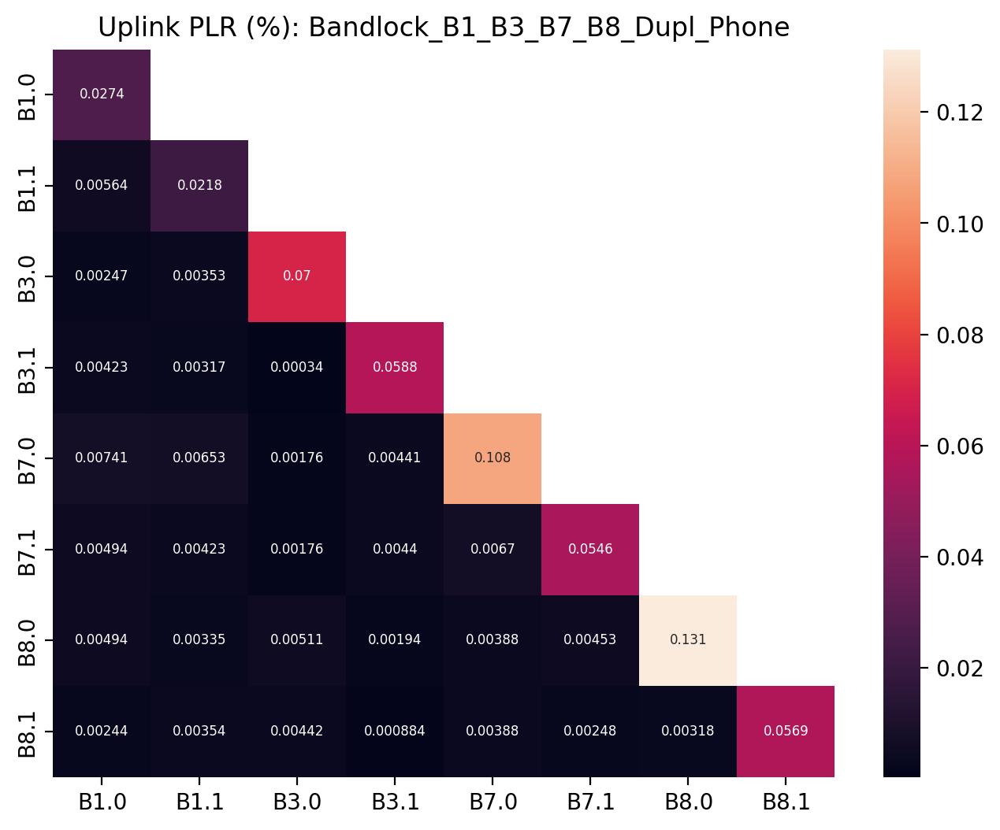

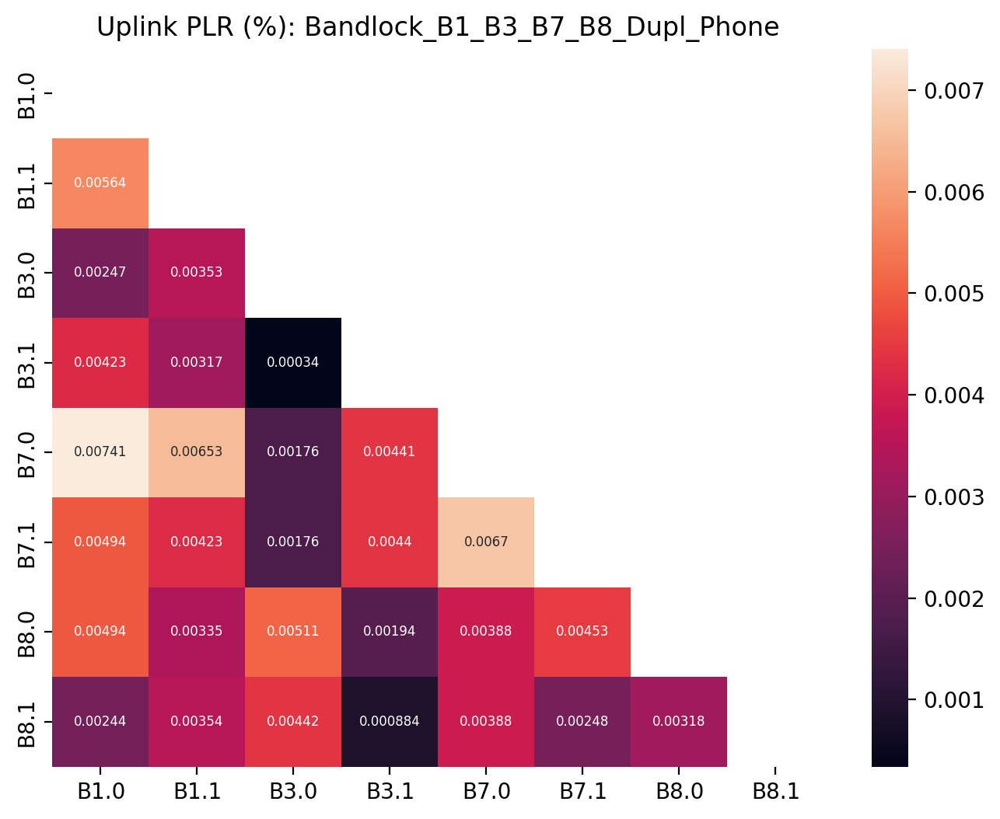

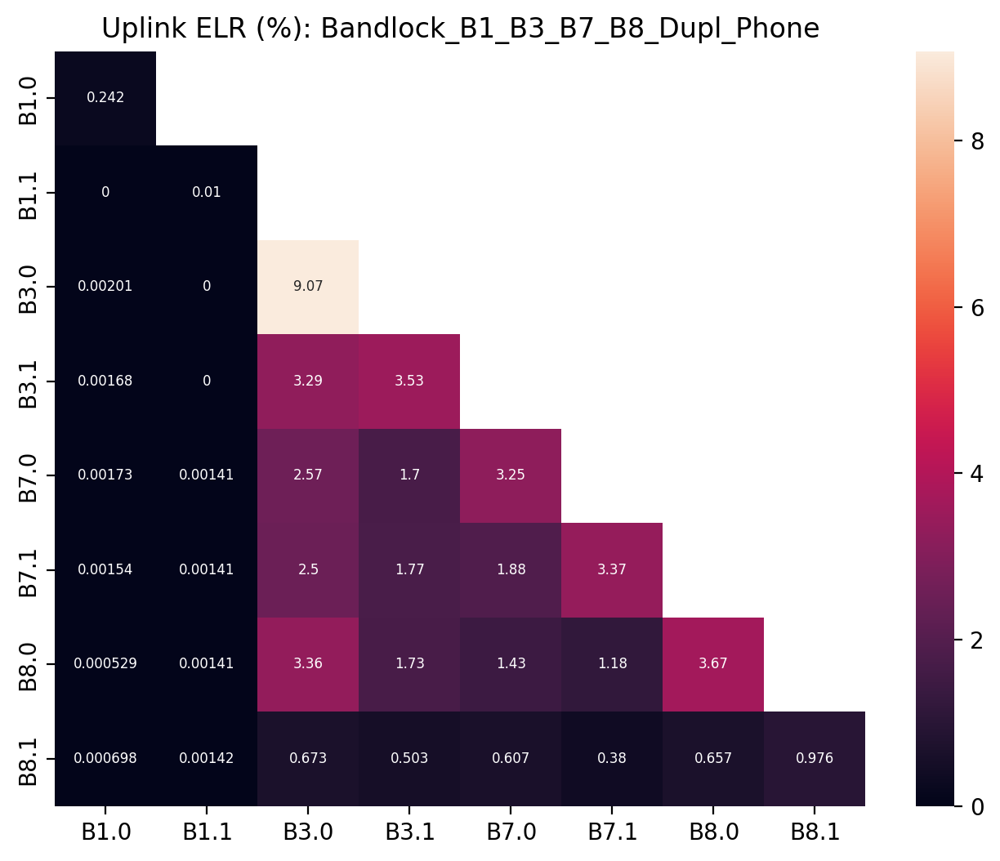

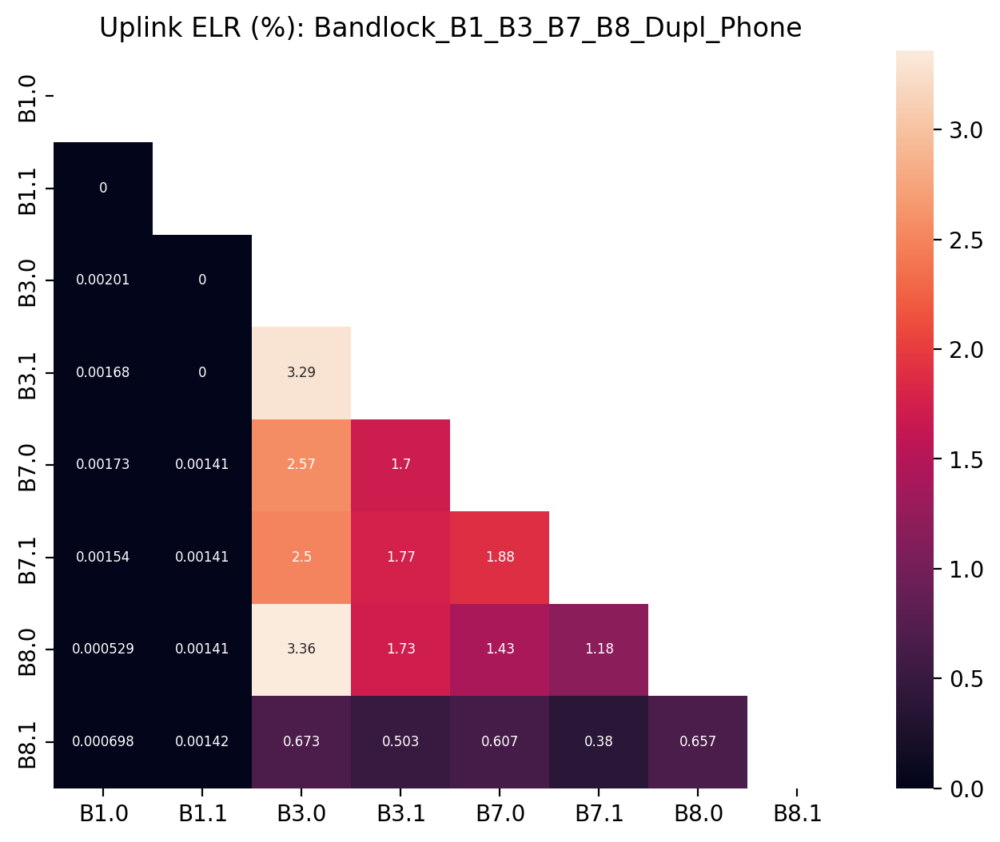

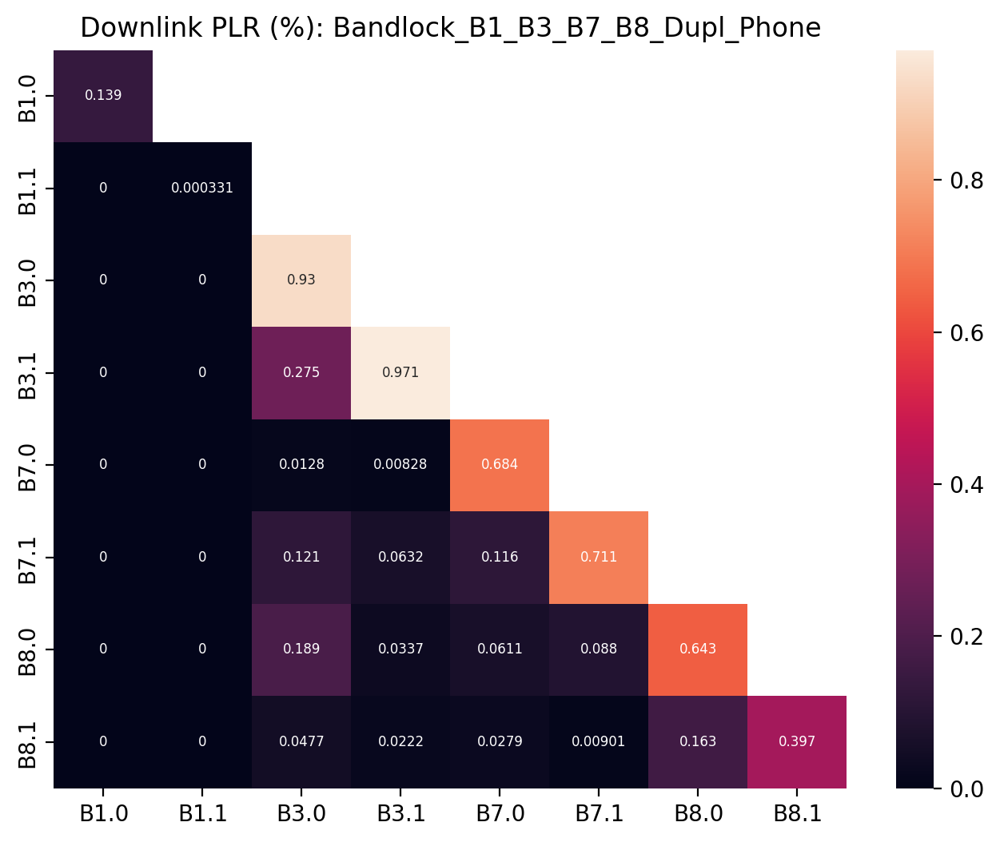

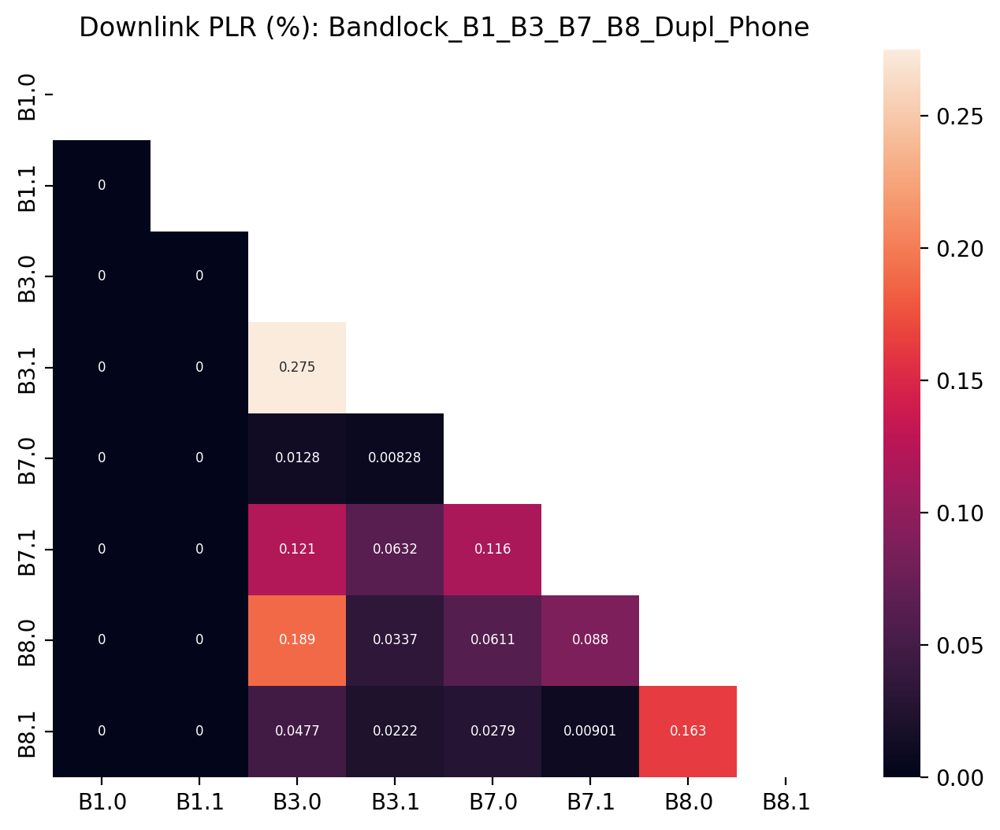

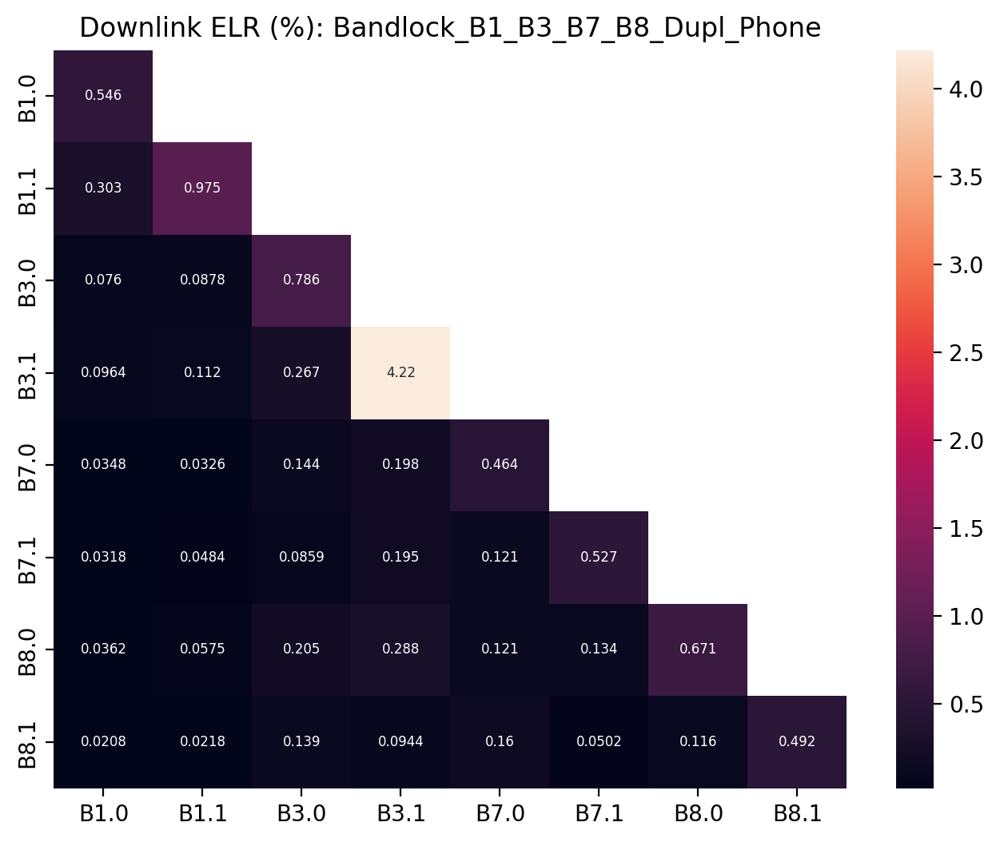

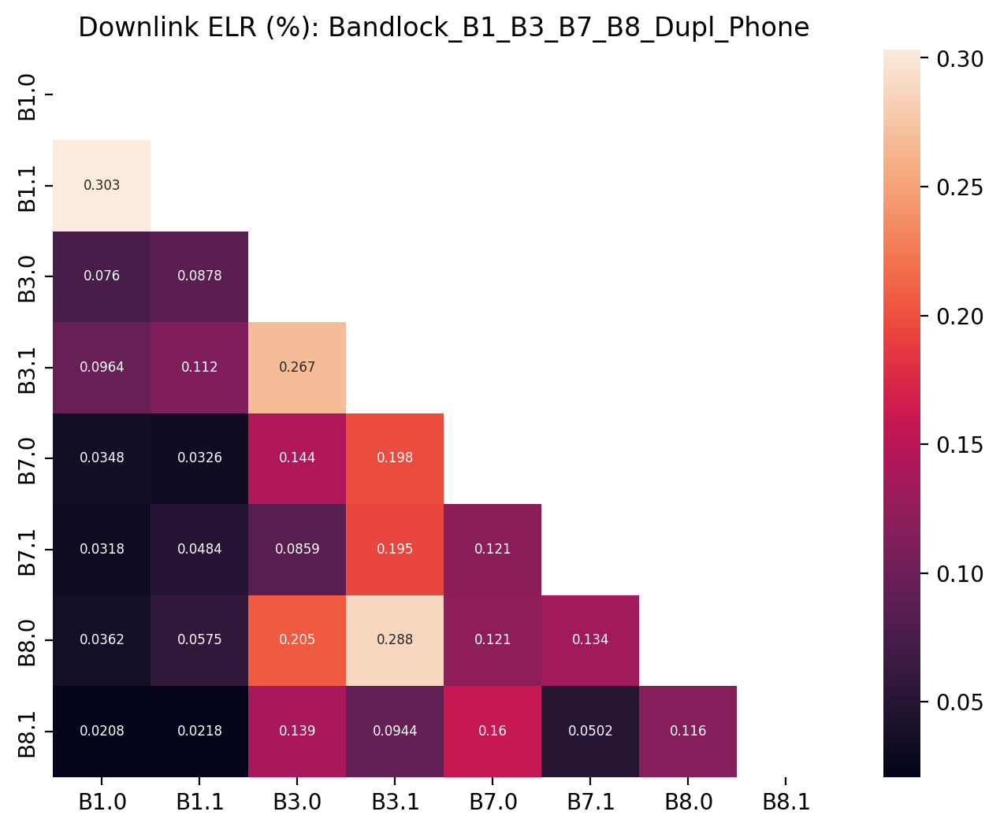

Bandlock_All_B3_B7_B8_Dupl_Phone


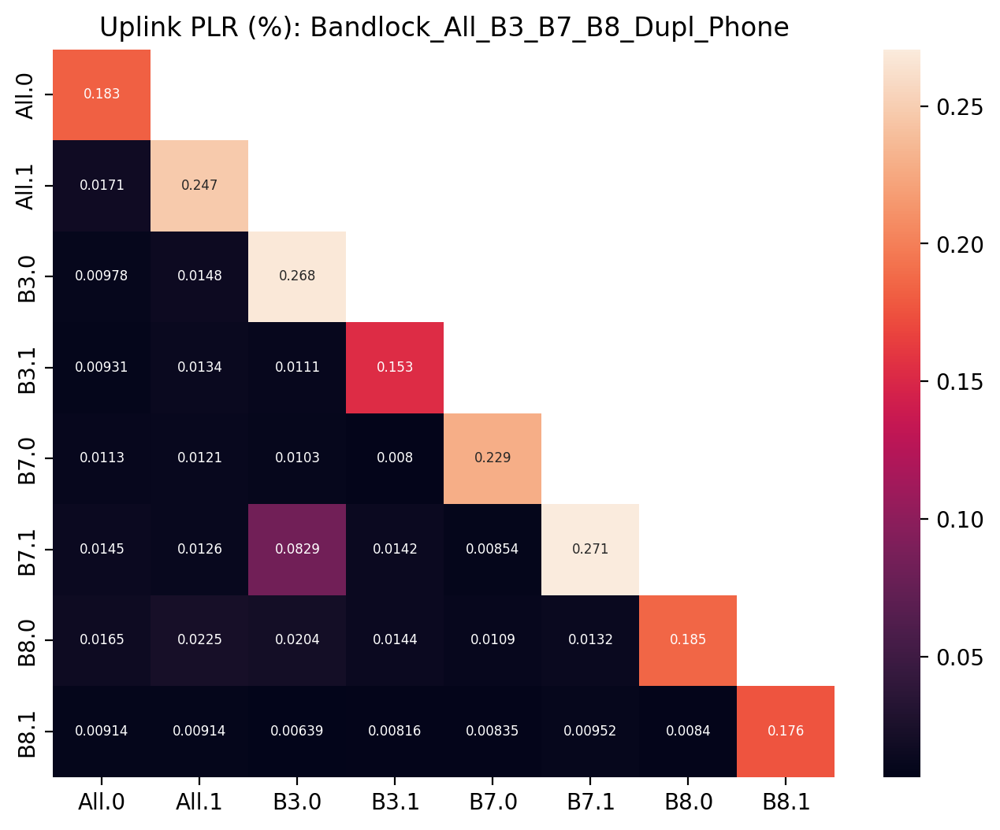

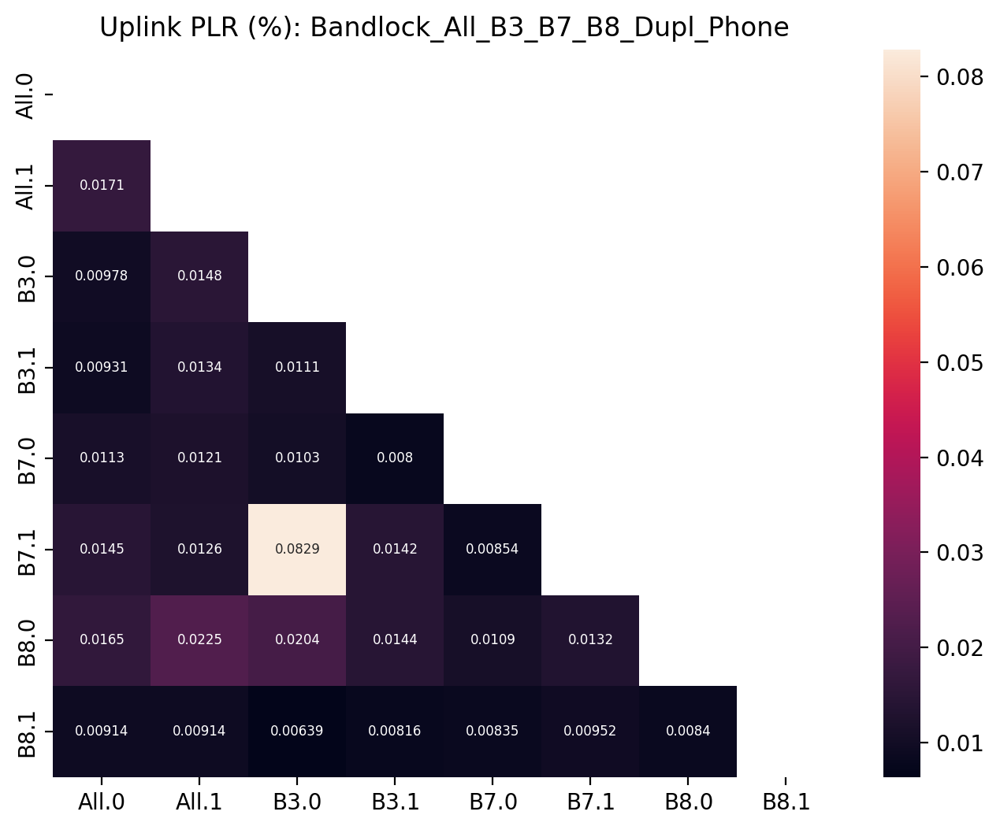

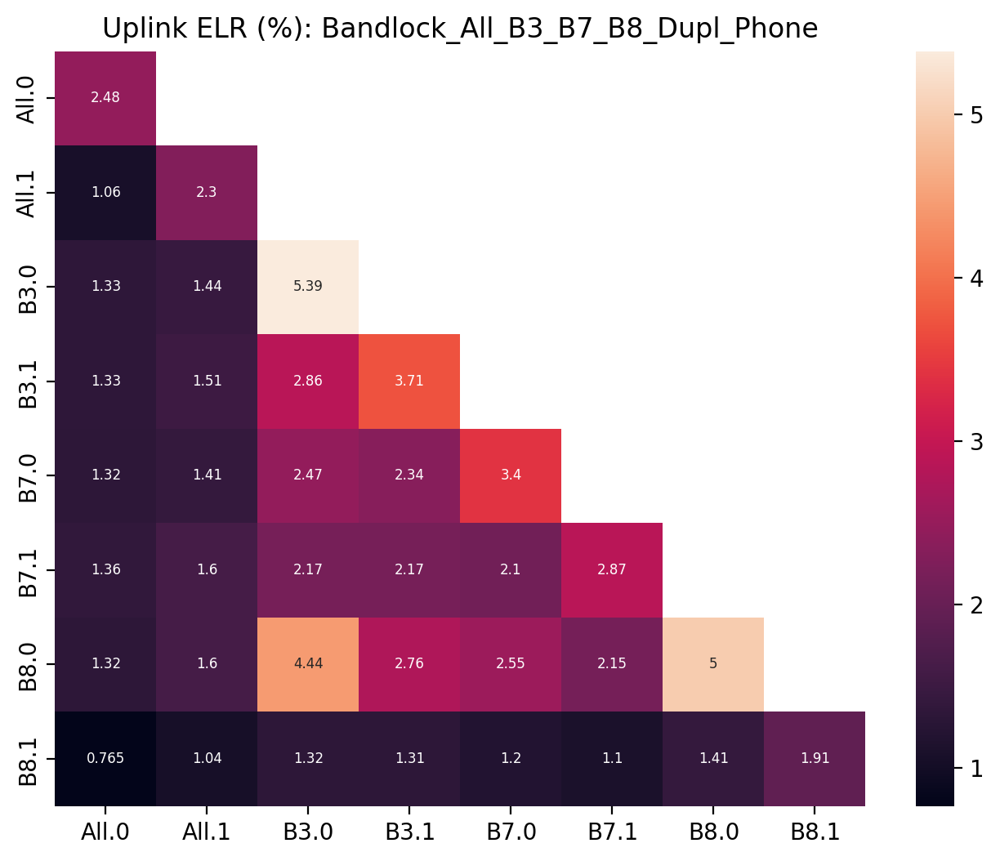

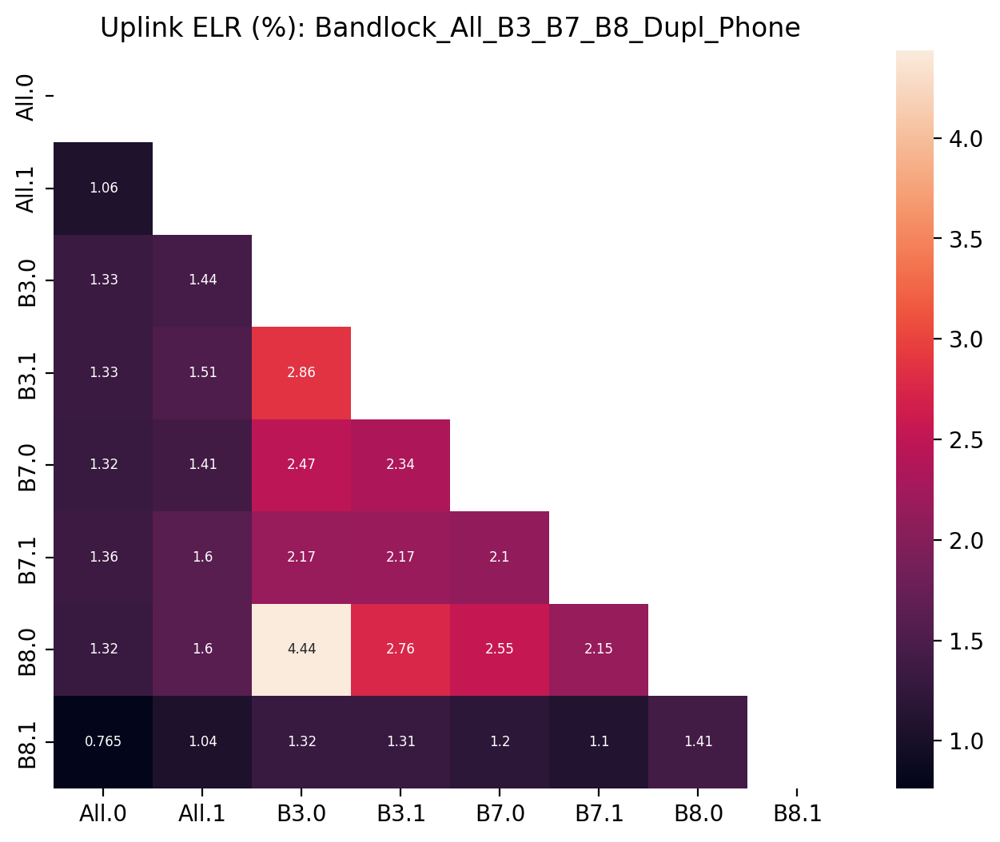

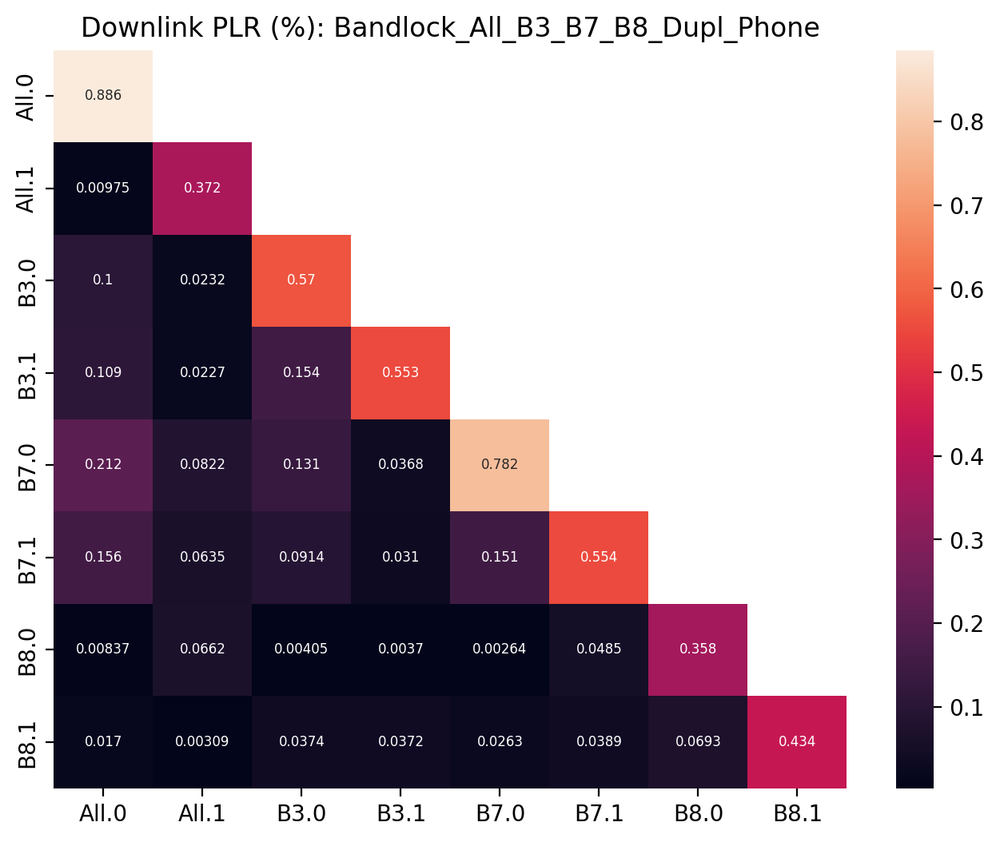

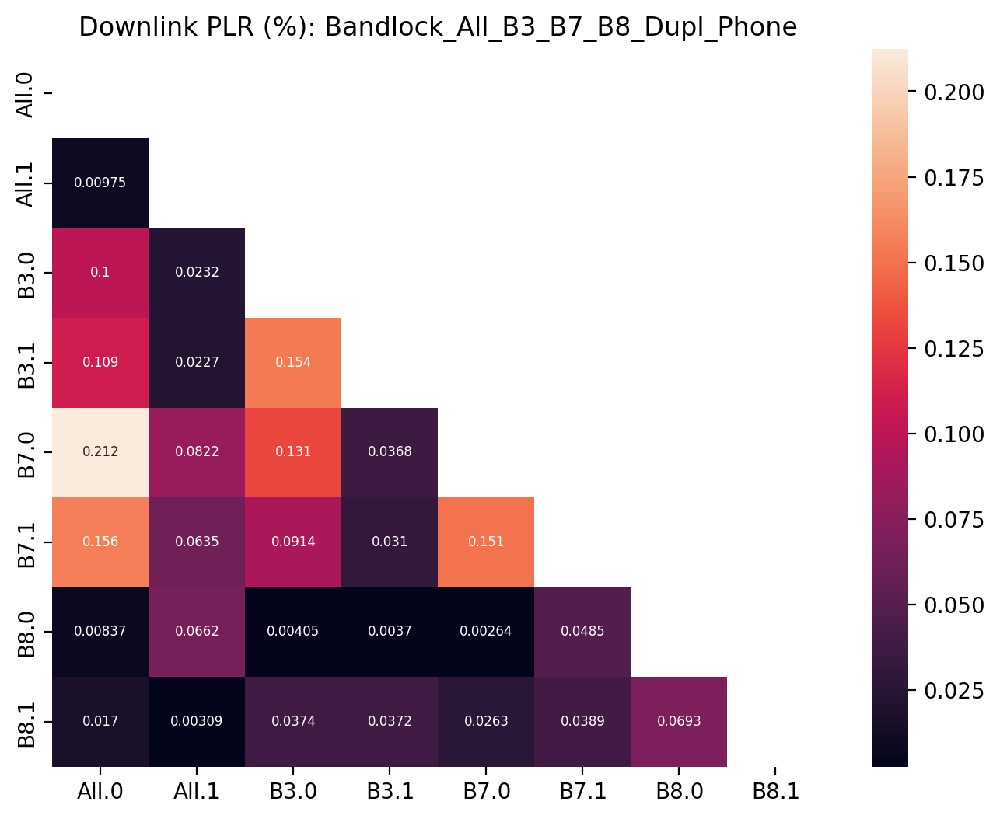

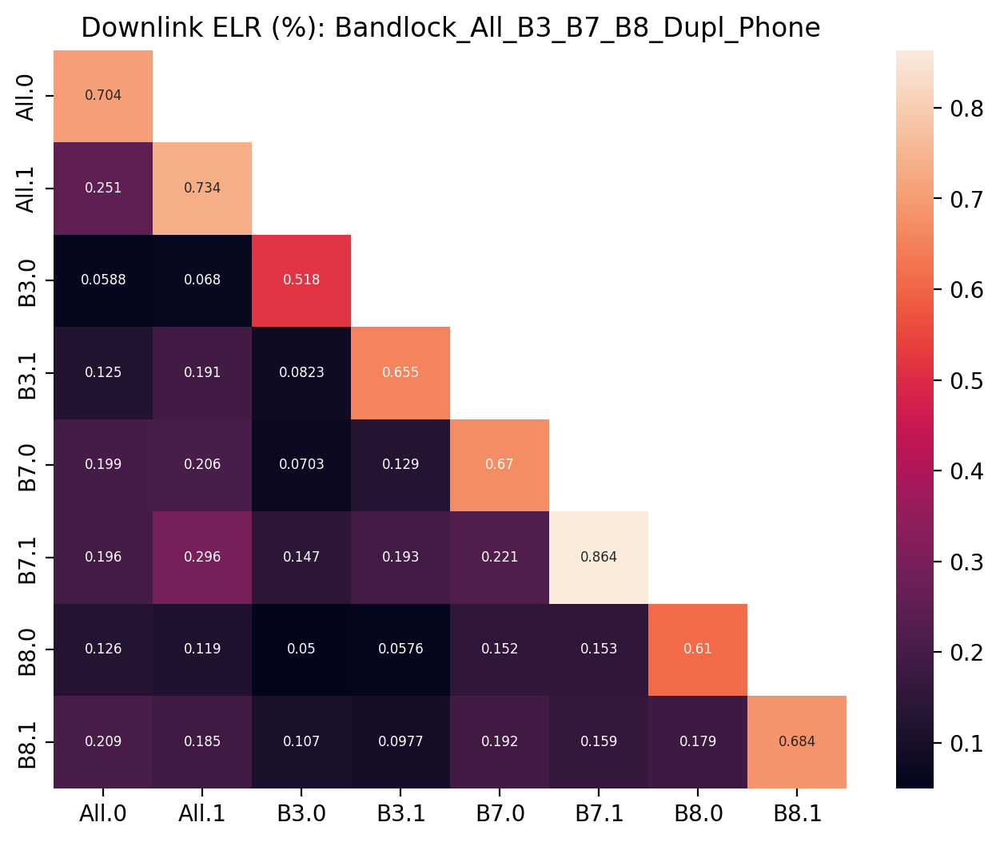

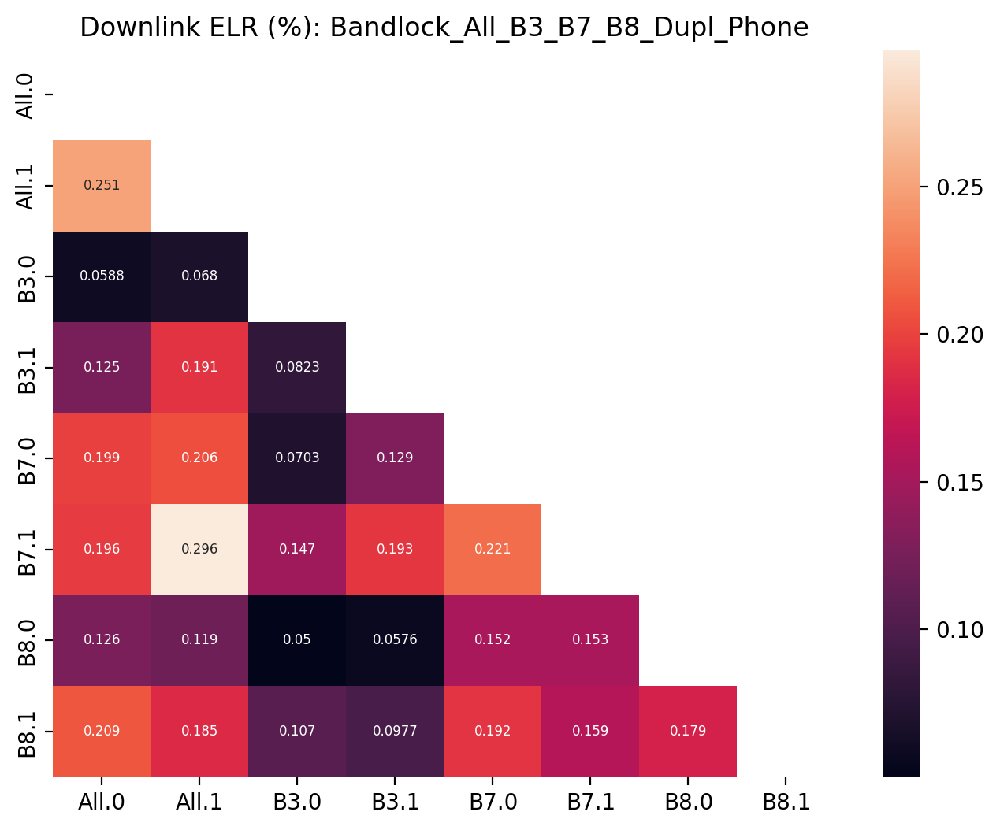

Bandlock_LTE_B3_B7_B8_Dupl_Phone


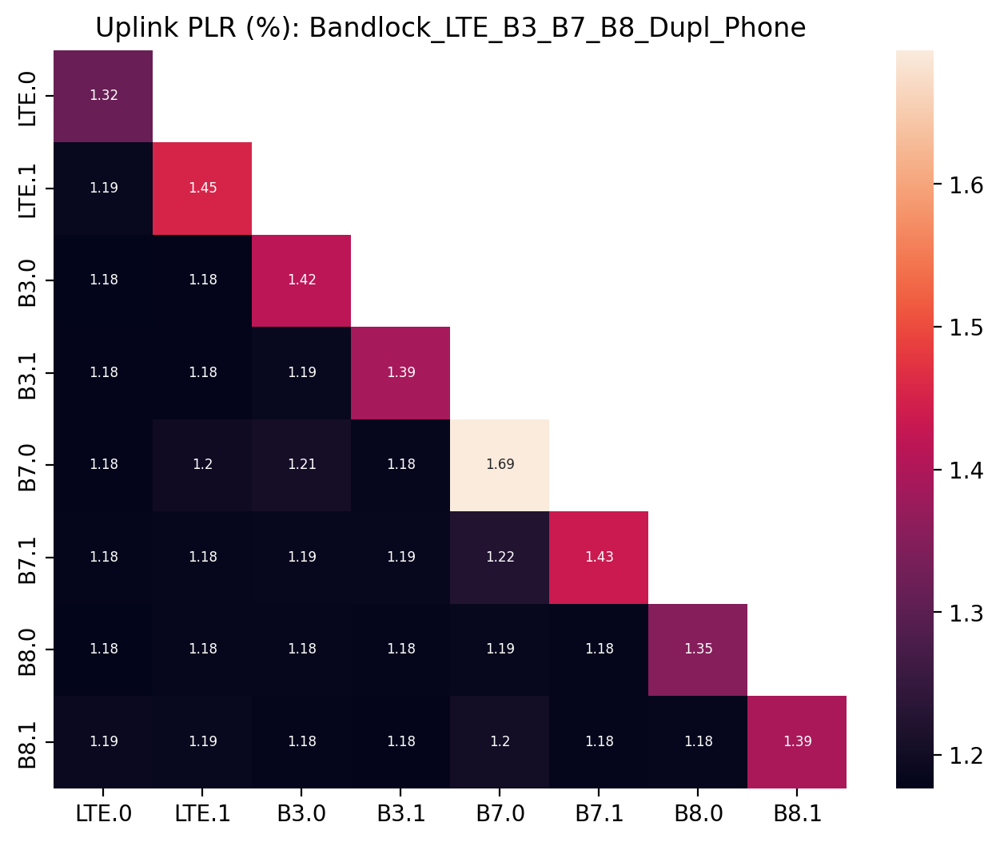

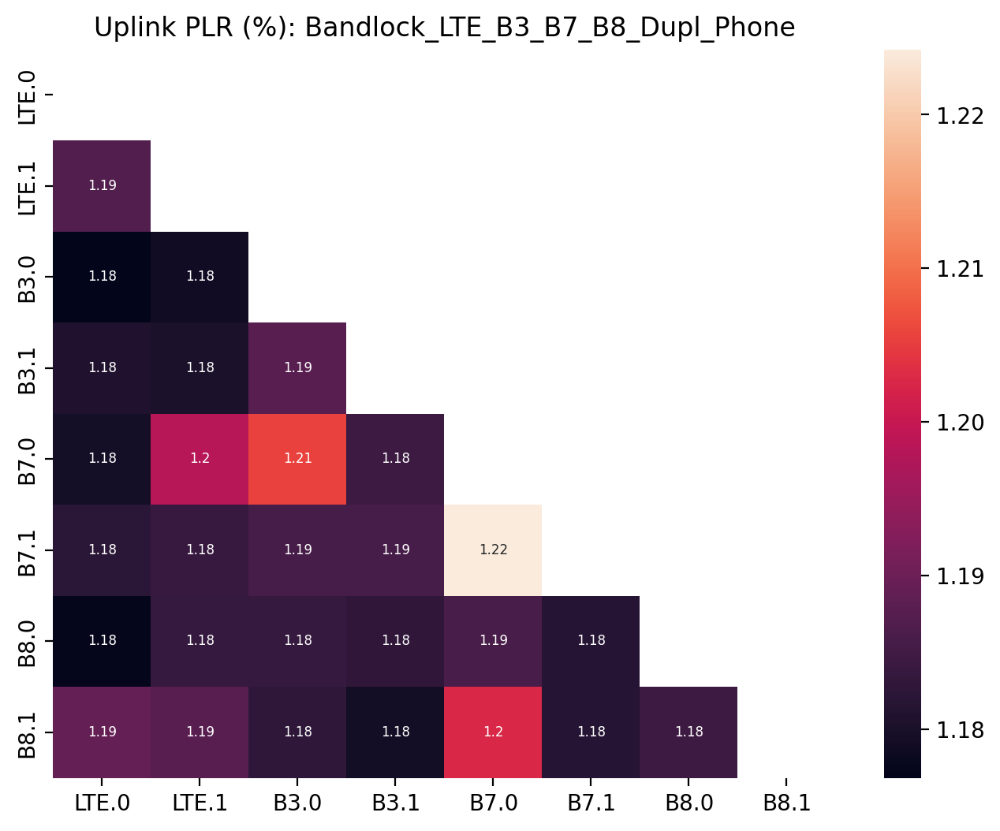

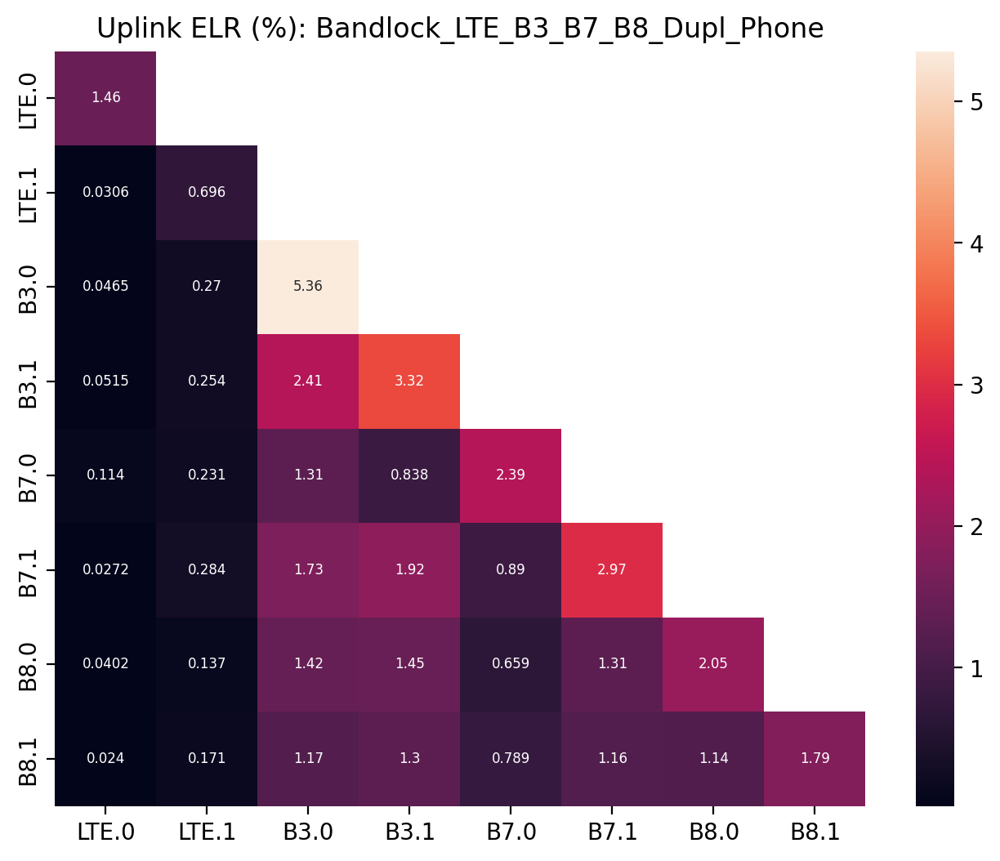

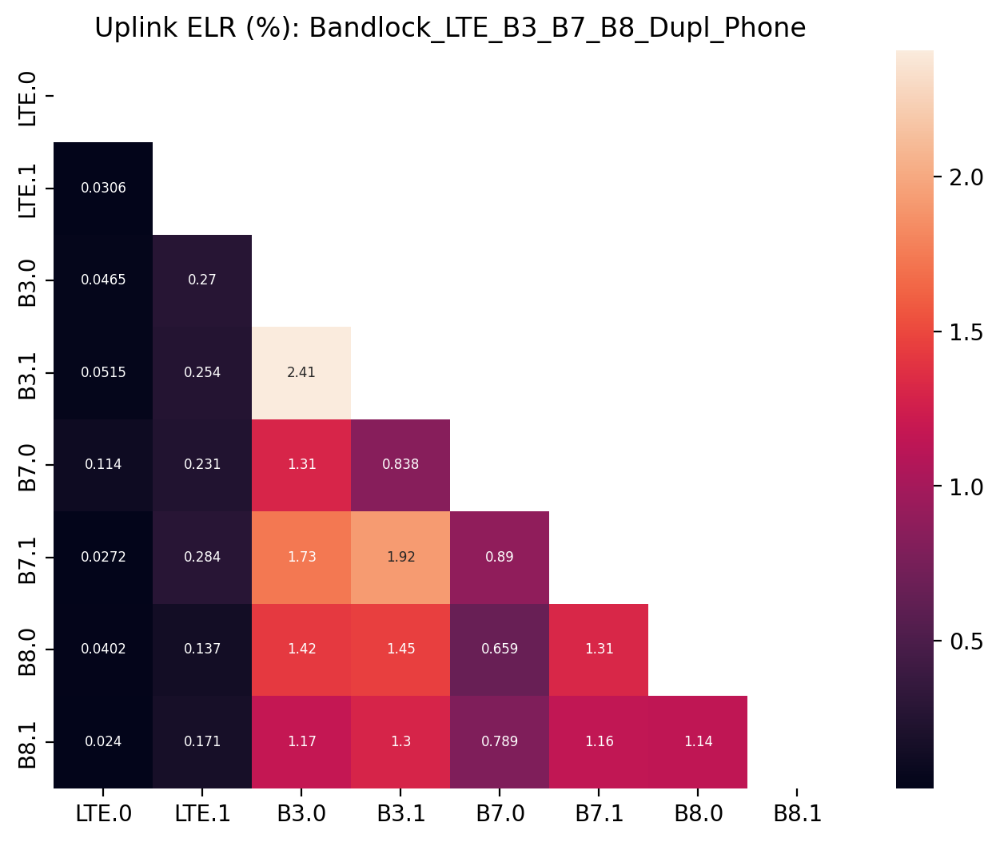

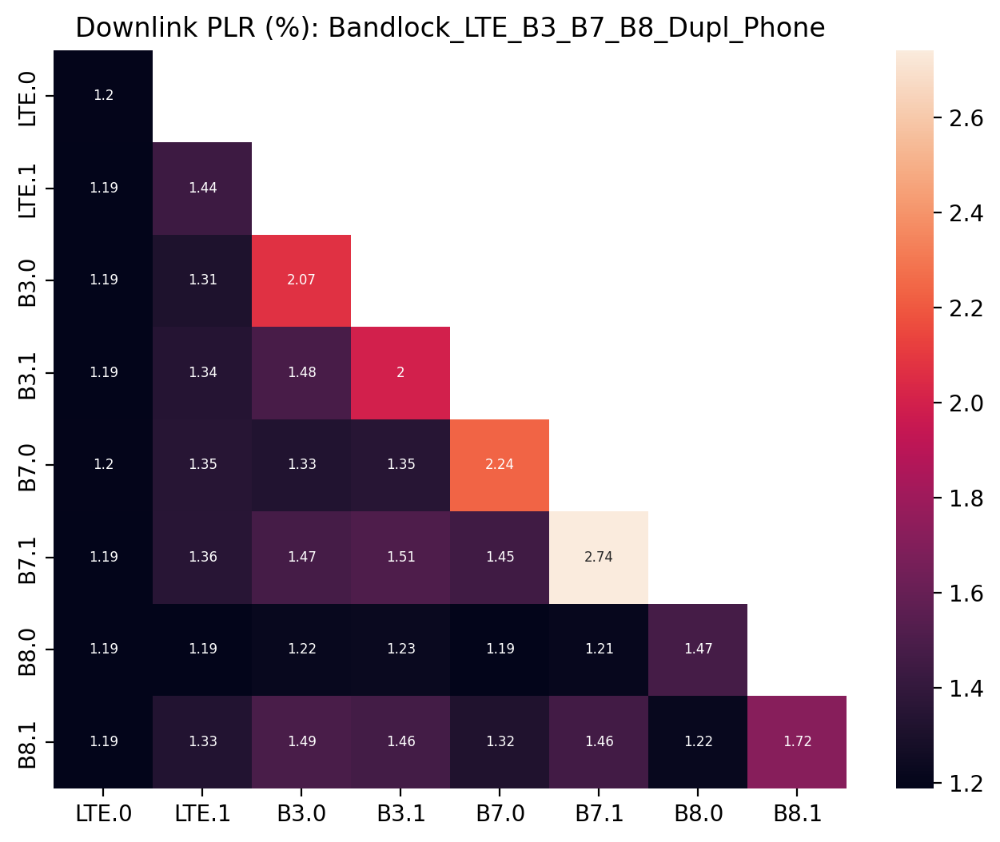

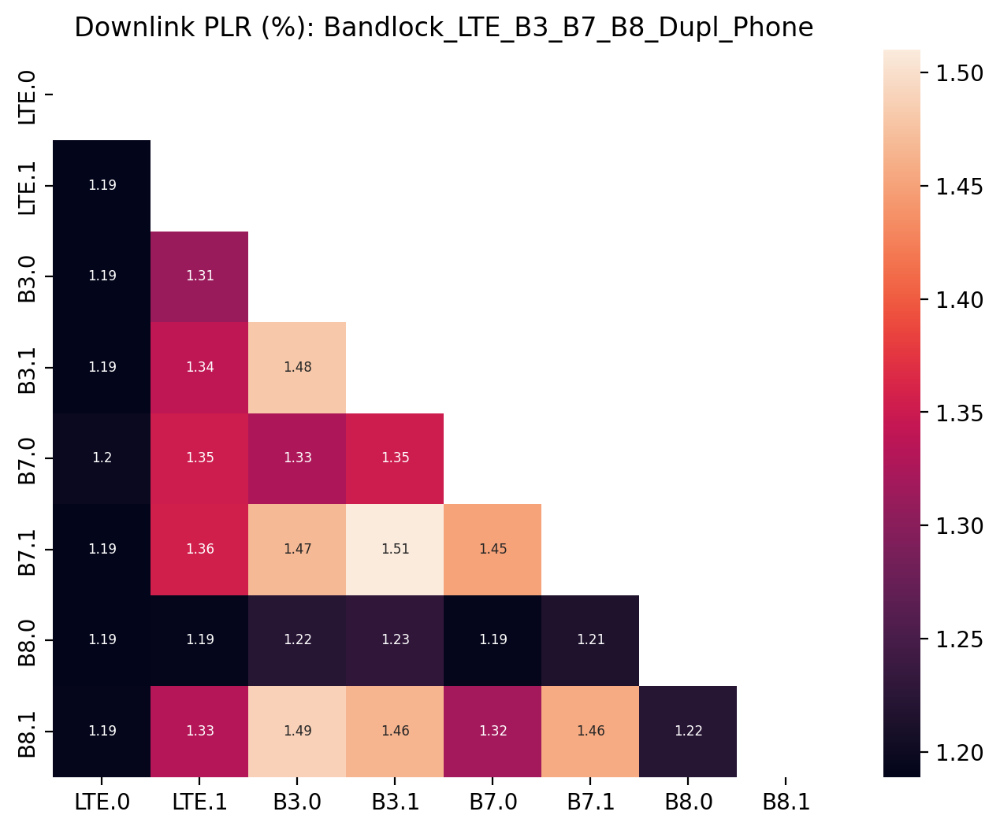

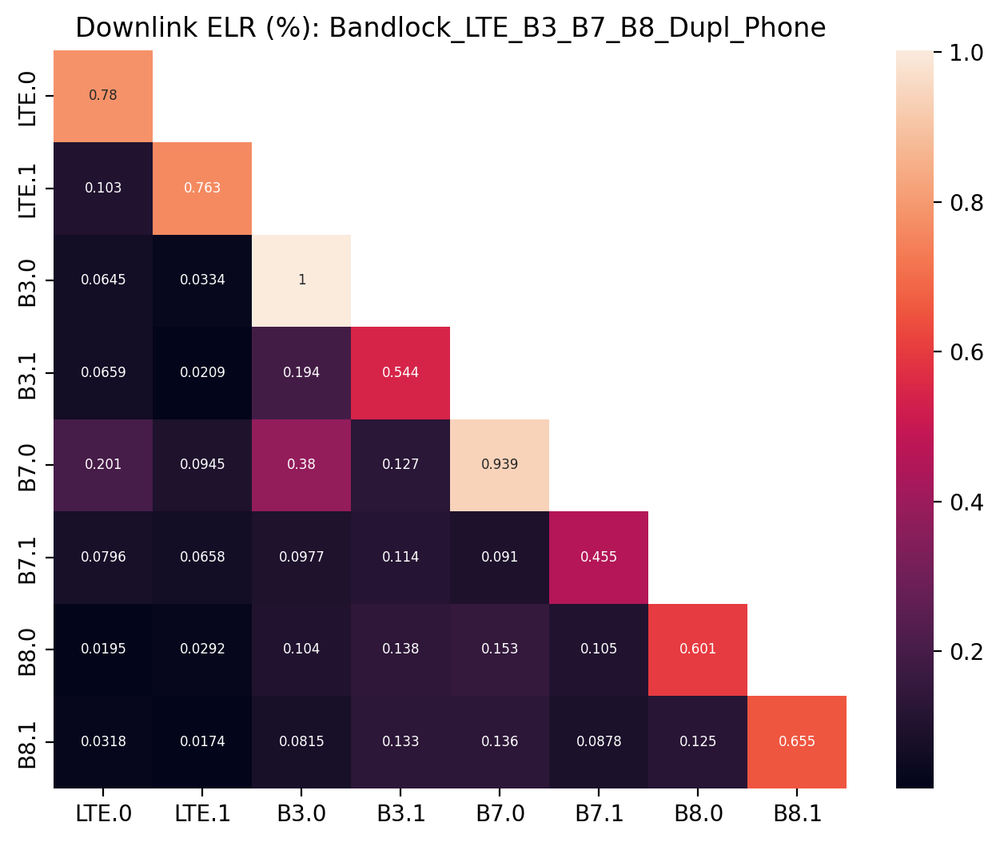

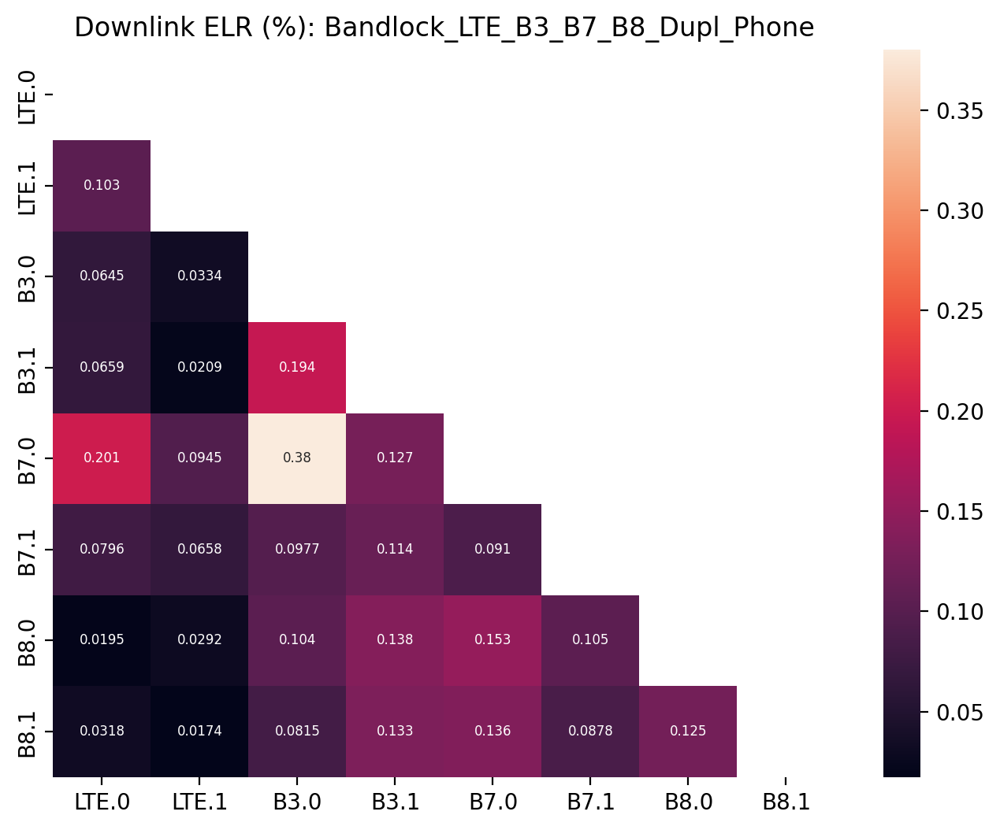

Bandlock_LTE_LTEb3_LTEb7_LTEb8_Dupl_Phone


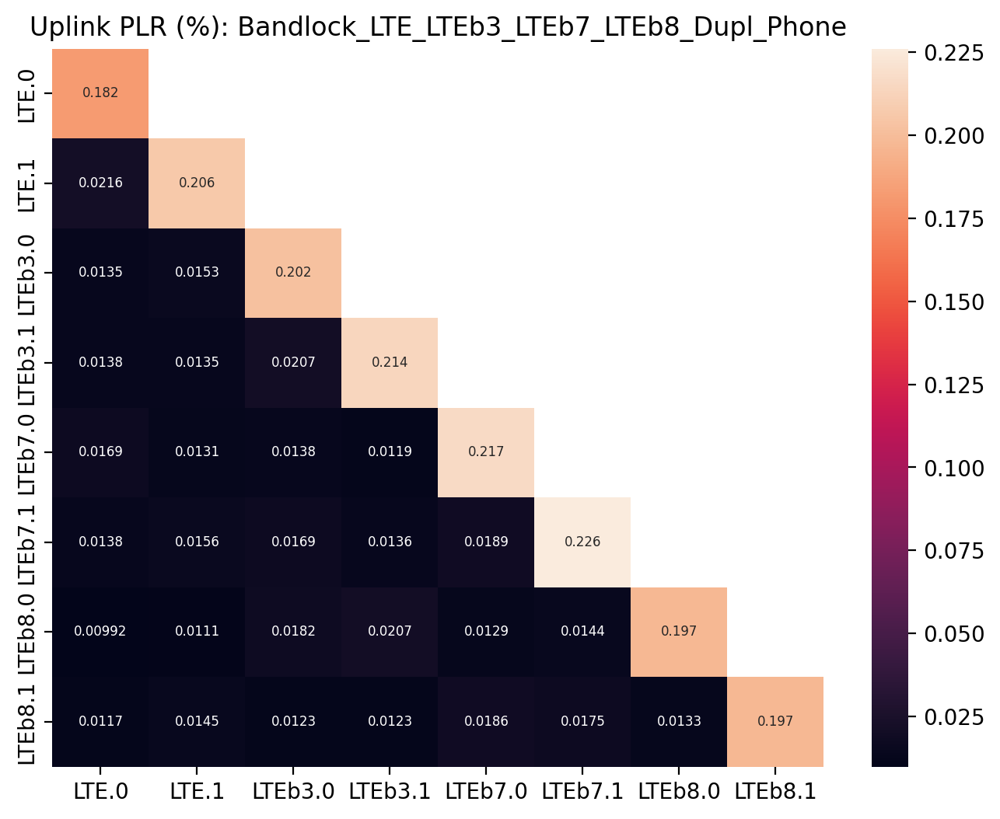

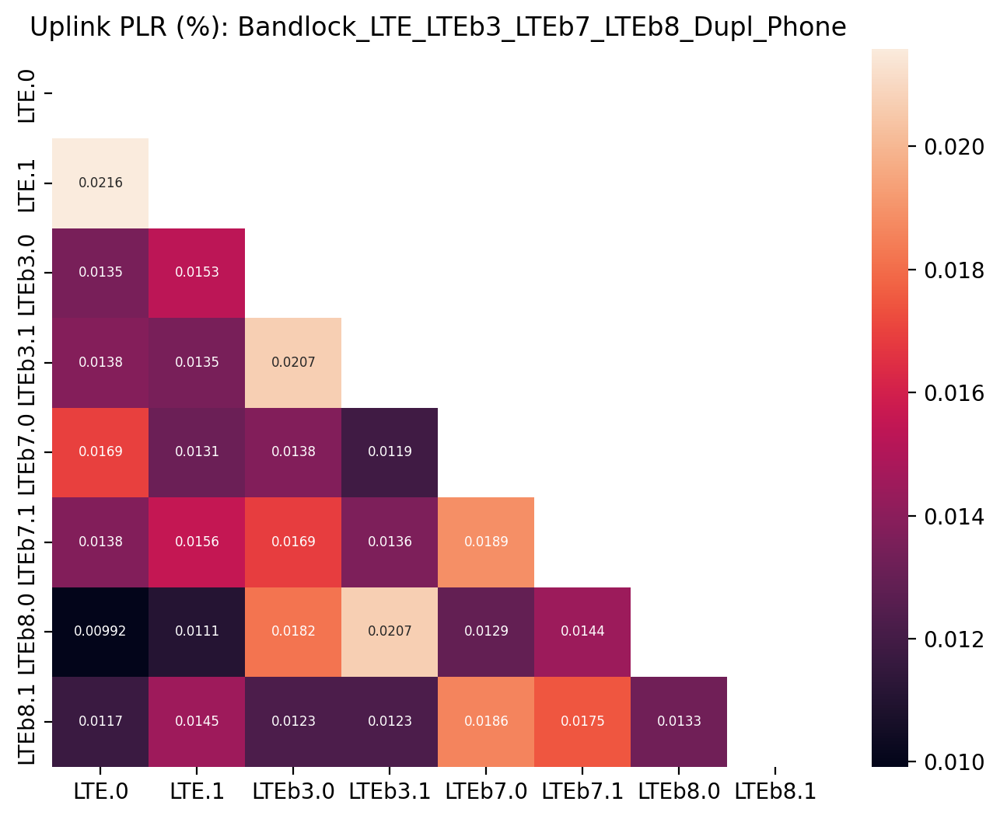

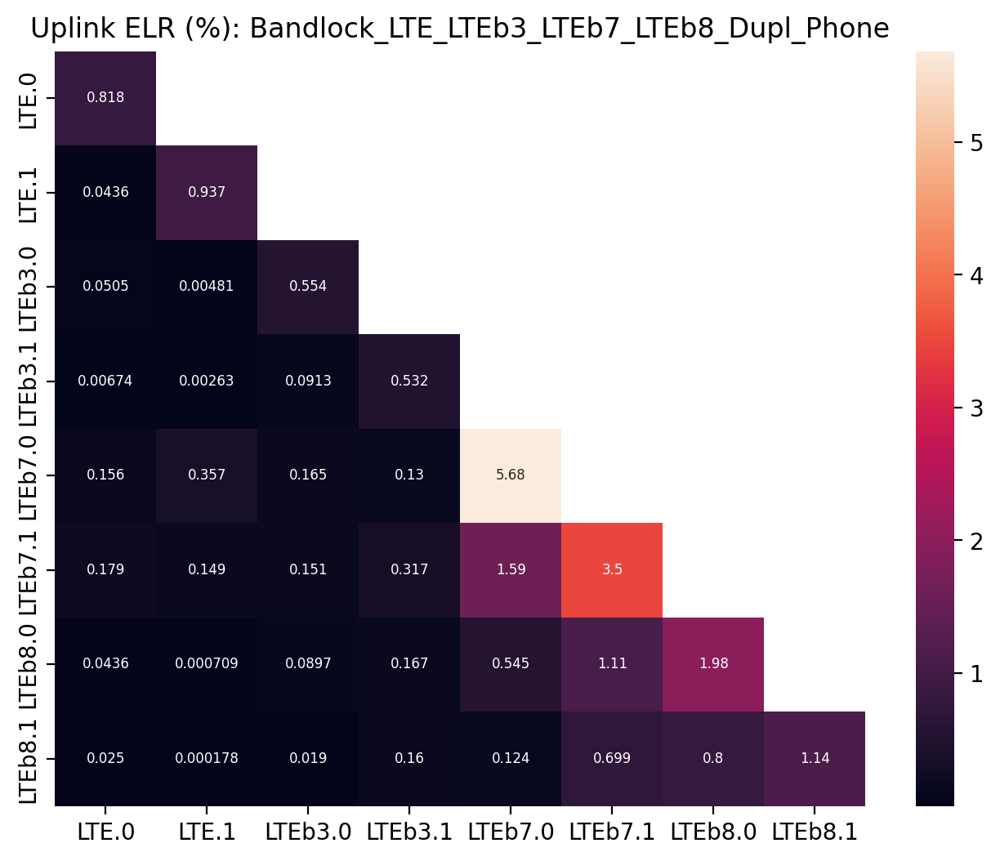

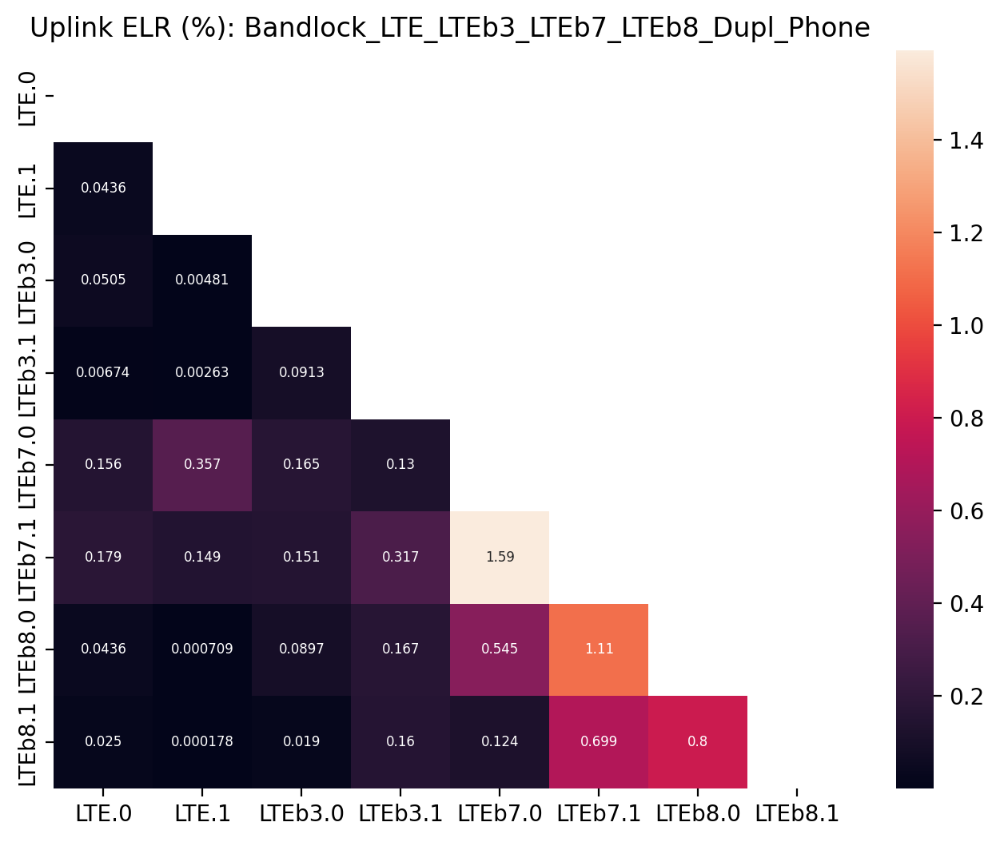

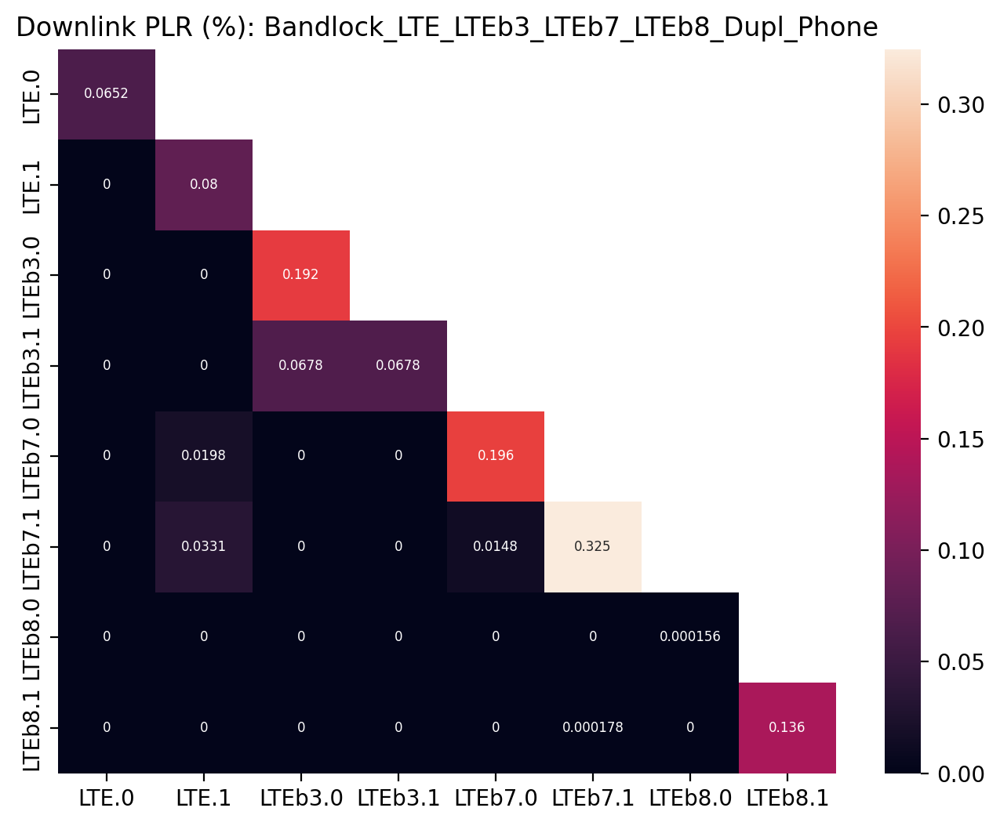

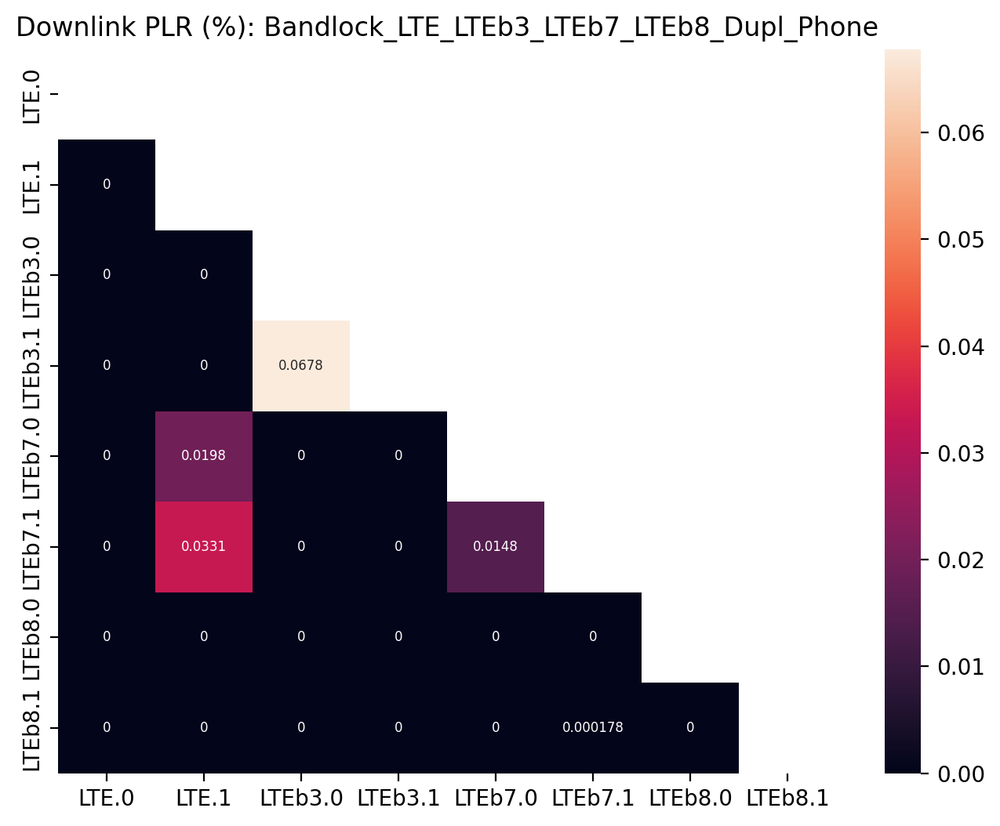

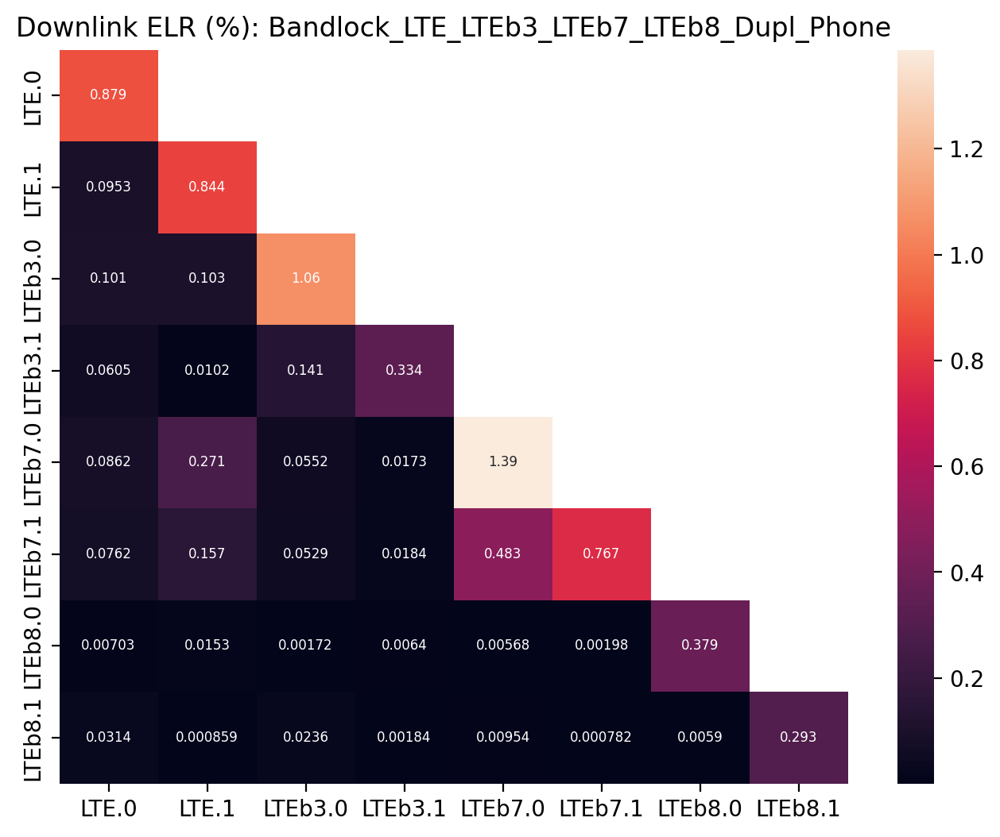

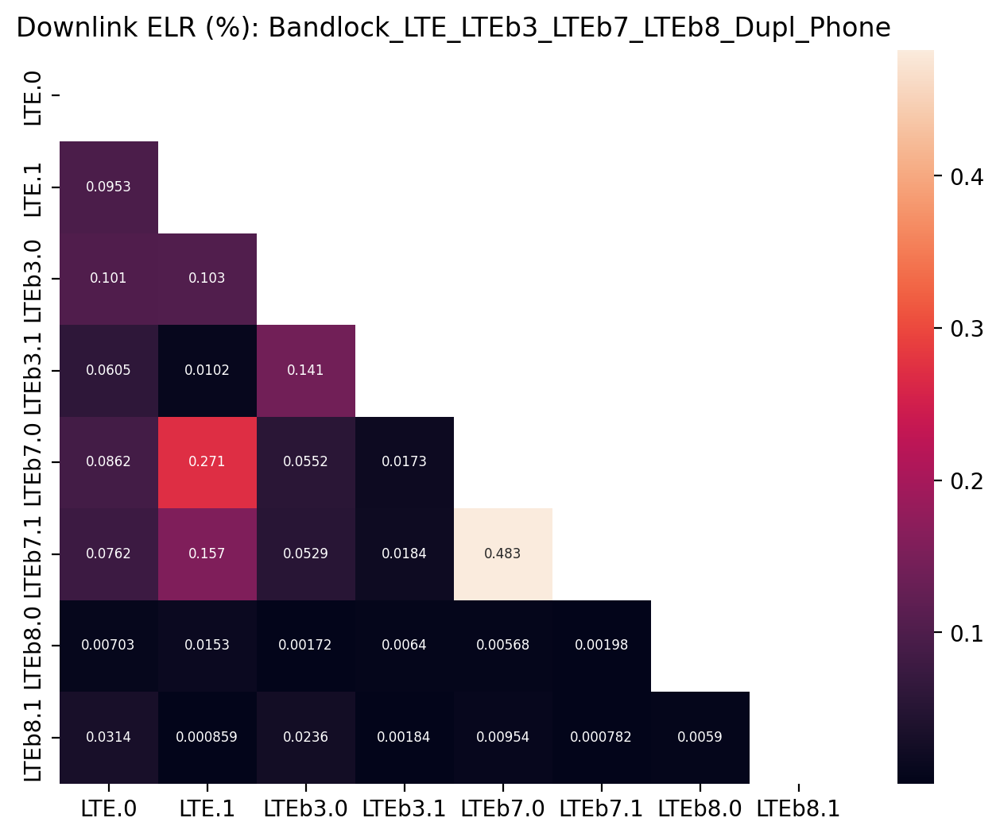

Bandlock_LTEb1_LTEb3_LTEb7_LTEb8_Dupl_Phone


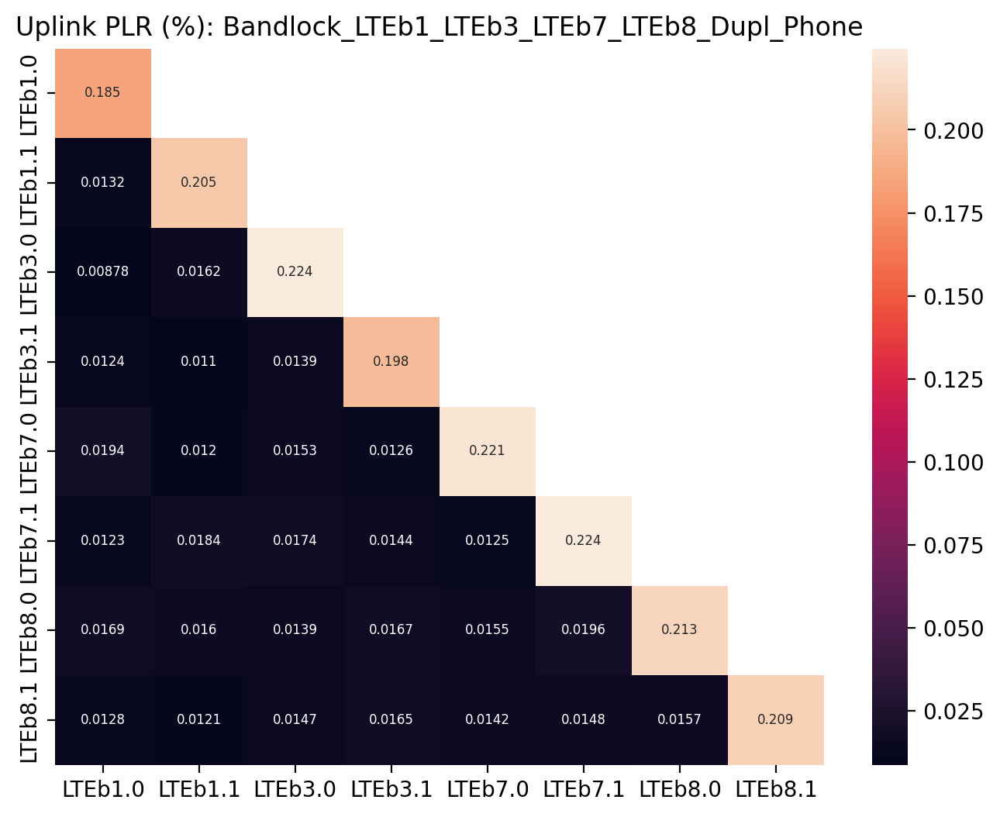

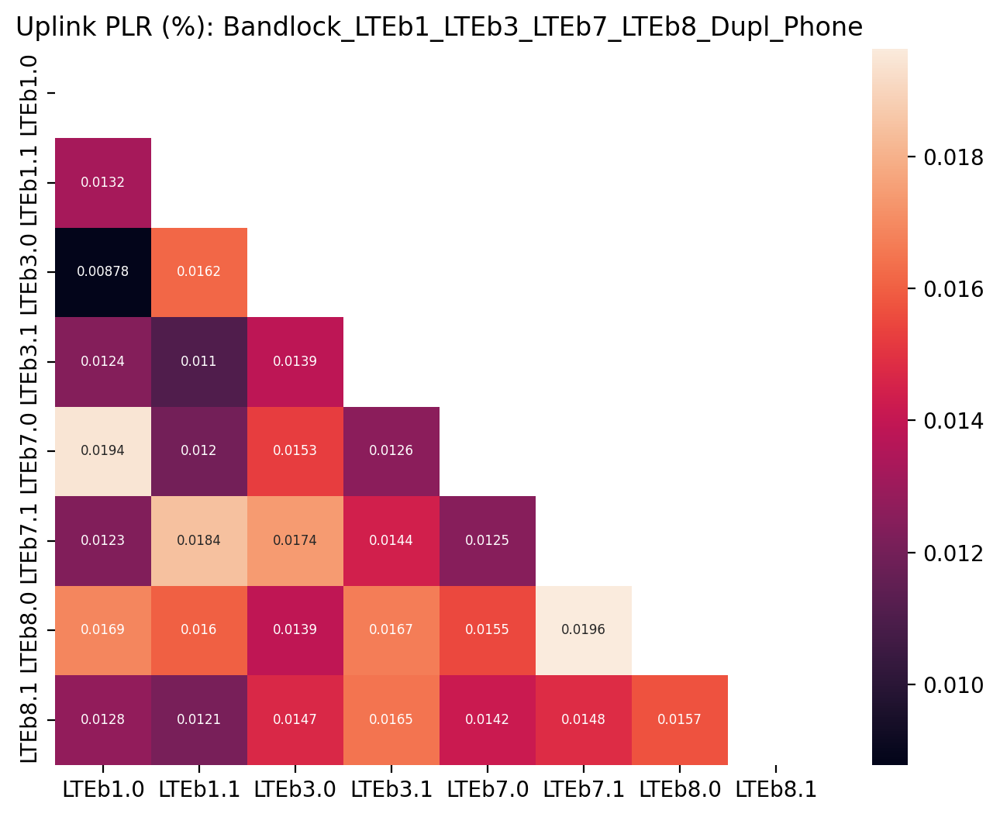

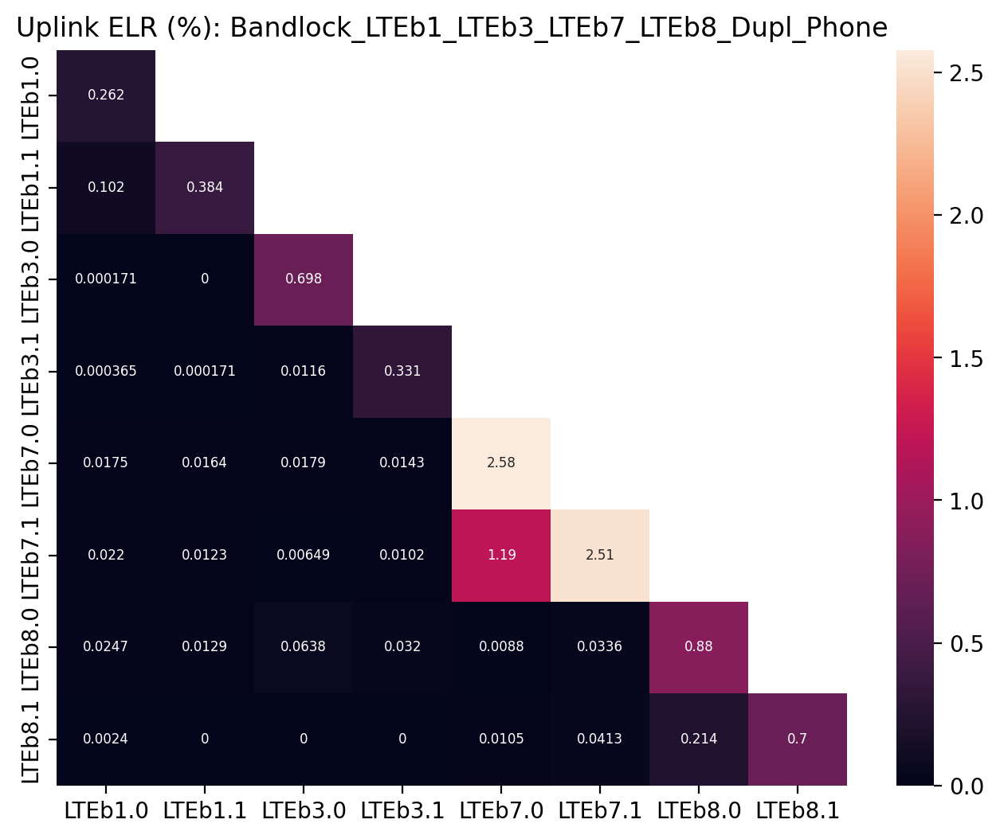

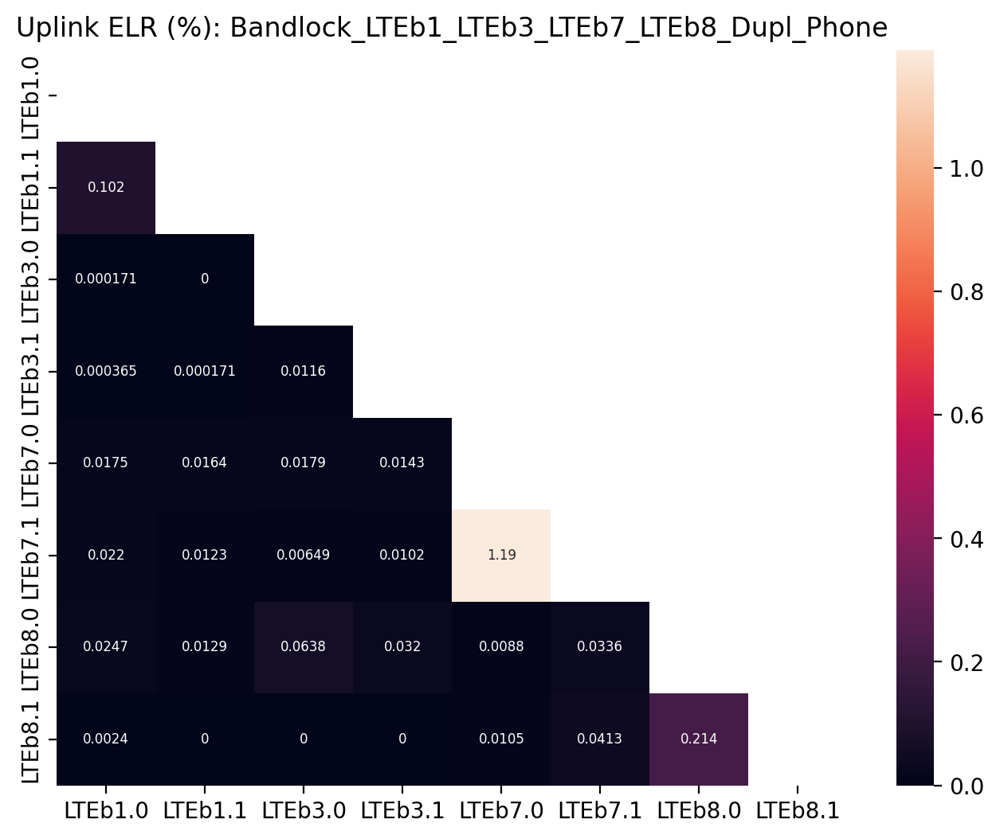

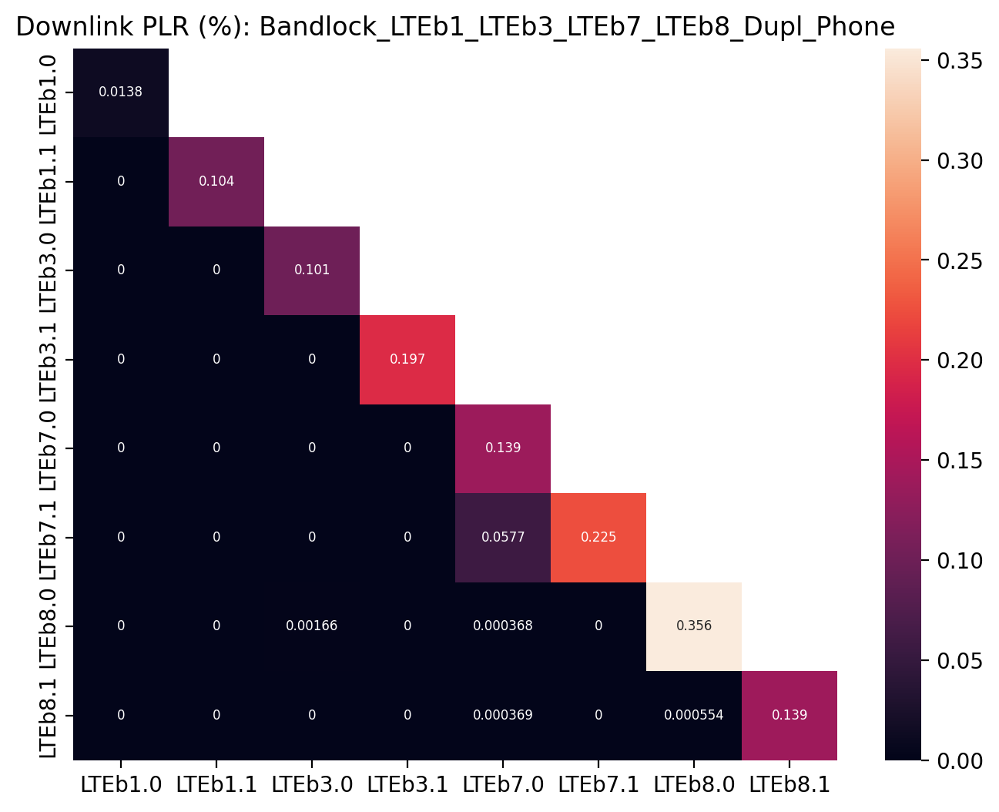

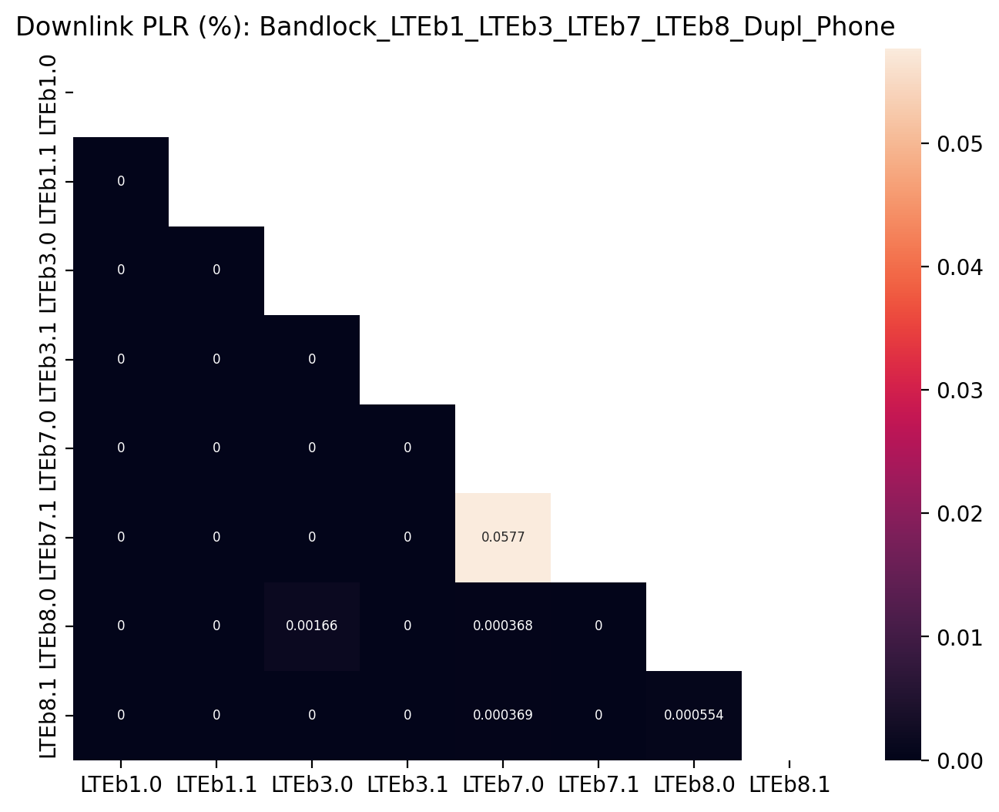

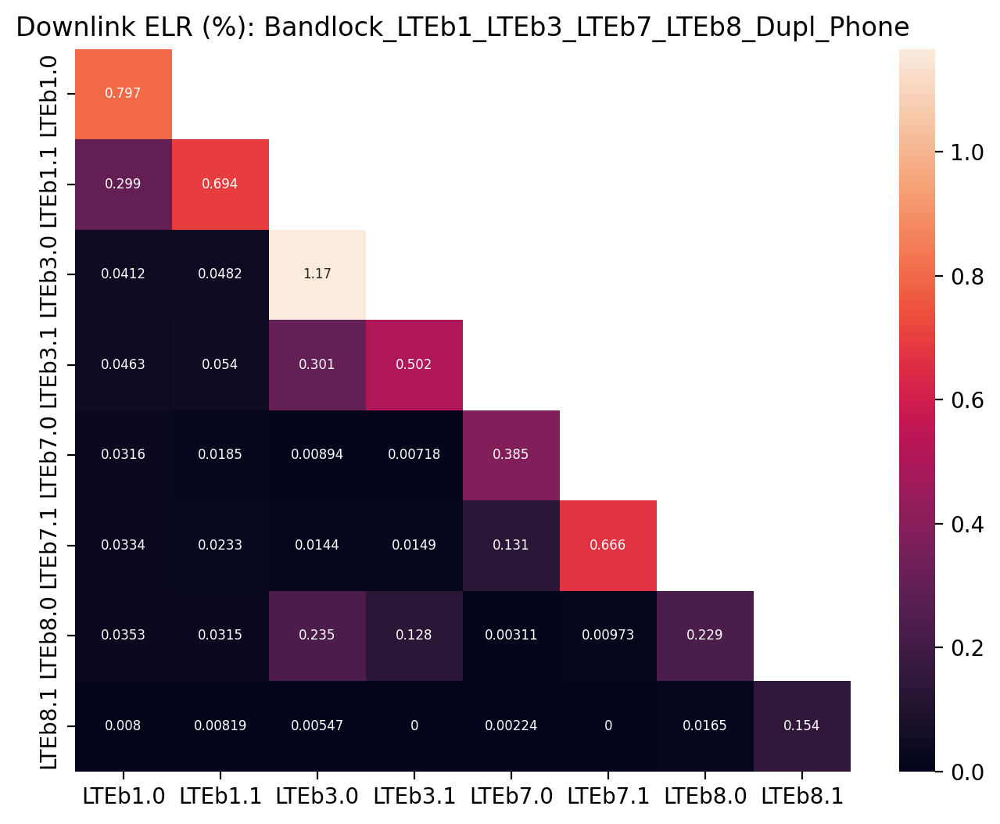

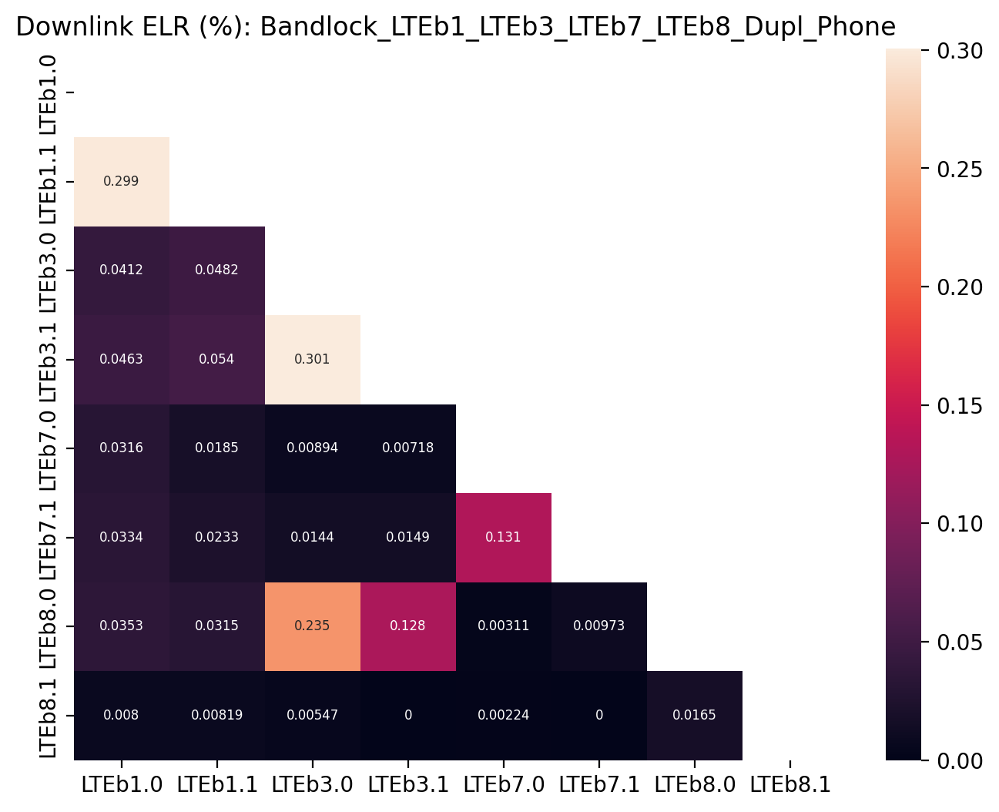

In [10]:
output_path = './heatmaps'

for exp in exp_list:
    dirname = exp.dirname
    devices = list(exp.setting.keys())
    schemes = list(exp.setting.values())
    traces = exp.traces
    print(os.path.basename(dirname))
    
    schemes = [f'{s}.0' if i % 2 == 0 else f'{s}.1' for i, s in enumerate(schemes)]
    # print(devices)
    # print(schemes)
    
    xs = list(it.product(schemes, repeat=2))
    xs = ['+'.join([s[0], s[1]]) if s[0] != s[1] else s[0] for s in xs]
    xs = np.reshape(xs, (len(schemes), len(schemes)))
    mtags = masked(xs.tolist(), mask(len(schemes), mode='upper'))
    mtags1 = masked(xs.tolist(), mask(len(schemes), mode='upper', diag=False))

    xs = list(it.combinations(schemes, 2))
    tags = [*schemes, *['+'.join([s[0], s[1]]) for s in xs]]

    xs = list(it.combinations(devices, 2))
    xs = [*devices, *xs]
    devices = xs
    
    tables = {}
    exp_name = os.path.basename(dirname)
    tables['Uplink_PLR'] = ul_plr_tables[exp_name].copy()
    tables['Uplink_ELR'] = ul_elr_tables[exp_name].copy()
    tables['Downlink_PLR'] = dl_plr_tables[exp_name].copy()
    tables['Downlink_ELR'] = dl_elr_tables[exp_name].copy()
        
    for pname in ['Uplink_PLR', 'Uplink_ELR', 'Downlink_PLR', 'Downlink_ELR']:
        table = tables[pname].copy()
        title = ' '.join(pname.split('_'))
        
        # draw heatmap for average of multiple traces
        fig, ax = plt.subplots(figsize=(8, 6))
        mat = fill_out_matrix(schemes, mtags, table.mean().to_dict())
        ax = sns.heatmap(mat.T, annot=True, fmt='.3g', mask=mask(len(schemes)), annot_kws={"size": 6})
        ax.set_title(f'{title} (%): {exp_name}')
        fig.savefig(os.path.join(output_path, f'{pname}_{exp_name}.png'), bbox_inches='tight', dpi=300)
        plt.show()
        
        # draw heatmap for average of multiple traces without diag
        fig, ax = plt.subplots(figsize=(8, 6))
        mat = fill_out_matrix(schemes, mtags1, table.mean().to_dict())
        ax = sns.heatmap(mat.T, annot=True, fmt='.3g', mask=mask(len(schemes), diag=False), annot_kws={"size": 6})
        ax.set_title(f'{title} (%): {exp_name}')
        fig.savefig(os.path.join(output_path, f'{pname}_{exp_name}_ndiag.png'), bbox_inches='tight', dpi=300)
        plt.show()

# Collect Data: Similarity

In [37]:
def get_length(intervals):
    """
    Get total length of a set of intervals.
    """
    if intervals.empty:
        return 0
    sum = 0
    for s in intervals:
        sum += (s.upper - s.lower) / dt.timedelta(seconds=1)
    return round(sum, 3)

def interp(x, y, ratio):
    """
    Interpolation

    Args:
        x, y (datetime.datetime): x < y
        ratio (float): a decimal numeral in a range [0, 1]; 0 means break at x, 1 means break at y.
    Returns:
        (datetime.datetime): breakpoint of interpolation
    """
    return x + (y - x) * ratio

In [45]:
sim_tables = {}

for exp in exp_list:
    dirname = exp.dirname
    devices = list(exp.setting.keys())
    schemes = list(exp.setting.values())
    traces = exp.traces
    print(os.path.basename(dirname))
    
    schemes = [f'{s}.0' if i % 2 == 0 else f'{s}.1' for i, s in enumerate(schemes)]
    # print(devices)
    # print(schemes)
    
    xs = list(it.product(schemes, repeat=2))
    xs = ['+'.join([s[0], s[1]]) if s[0] != s[1] else s[0] for s in xs]
    xs = np.reshape(xs, (len(schemes), len(schemes)))
    mtags = masked(xs.tolist(), mask(len(schemes), mode='upper'))

    xs = list(it.combinations(schemes, 2))
    tags = [*schemes, *['+'.join([s[0], s[1]]) for s in xs]]

    xs = list(it.combinations(devices, 2))
    xs = [*devices, *xs]
    devices = xs

    # print(devices)
    # print(tags)
    # display(pd.DataFrame(mtags))
    
    sim_table = pd.DataFrame(columns=tags)
    
    for i, trace in enumerate(traces):
        sim_row = []
        print(trace)

        handoff_intvs = {}
        for dev, schm in zip(devices, tags):
            print(dev)
            
            if type(dev) is not tuple: # Single Radio
                
                path = os.path.join(dirname, dev, trace, 'data', 'diag_handover_info.pkl')
                df = pd.read_pickle(path)
                df = df[~np.in1d(df['ho_type'], ['Conn_Setup', 'Conn_Rel'])].copy().reset_index(drop=True)
                
                handoff_intv = P.empty()
                for i, row in df.iterrows():
                    if pd.isna(row.end):
                        handoff_intv = handoff_intv | P.singleton(row.start)
                    else:
                        handoff_intv = handoff_intv | P.closed(row.start, row.end)
                print(handoff_intv)
                handoff_intvs[dev] = handoff_intv
                
                similarity = 100 # (%)
            else: # Dual Radio
                union_intv = handoff_intvs[dev[0]] | handoff_intvs[dev[1]]
                intersect_intv = handoff_intvs[dev[0]] & handoff_intvs[dev[1]]
                print(intersect_intv)
                
                similarity = get_length(intersect_intv) / get_length(union_intv) * 100
            
            print(similarity)
            sim_row.append(similarity)
        
        sim_table = pd.concat([sim_table, pd.DataFrame(sim_row, index=sim_table.columns).T])
    
    sim_table = sim_table.reset_index(drop=True).copy()
    display(sim_table)
    sim_tables[os.path.basename(dirname)] = sim_table

Bandlock_B1_B3_B7_B8_Dupl_Phone
#01
sm00
[Timestamp('2023-06-15 15:00:51.430200'),Timestamp('2023-06-15 15:00:51.443229')] | [Timestamp('2023-06-15 15:00:58.885391'),Timestamp('2023-06-15 15:00:58.900281')] | [Timestamp('2023-06-15 15:01:18.981850'),Timestamp('2023-06-15 15:01:18.995205')] | [Timestamp('2023-06-15 15:01:20.071851'),Timestamp('2023-06-15 15:01:20.084126')] | [Timestamp('2023-06-15 15:01:29.924127'),Timestamp('2023-06-15 15:01:29.938058')] | [Timestamp('2023-06-15 15:01:32.508957'),Timestamp('2023-06-15 15:01:32.523157')] | [Timestamp('2023-06-15 15:01:36.571718'),Timestamp('2023-06-15 15:01:36.585421')] | [Timestamp('2023-06-15 15:02:00.142713'),Timestamp('2023-06-15 15:02:00.155770')] | [Timestamp('2023-06-15 15:02:19.909415'),Timestamp('2023-06-15 15:02:19.923869')] | [Timestamp('2023-06-15 15:02:26.998379'),Timestamp('2023-06-15 15:02:27.011703')] | [Timestamp('2023-06-15 15:03:22.453217'),Timestamp('2023-06-15 15:03:22.467509')] | [Timestamp('2023-06-15 15:03:22.941

,B1.0,B1.1,B3.0,B3.1,B7.0,B7.1,B8.0,B8.1,B1.0+B1.1,B1.0+B3.0,B1.0+B3.1,B1.0+B7.0,B1.0+B7.1,B1.0+B8.0,B1.0+B8.1,B1.1+B3.0,B1.1+B3.1,B1.1+B7.0,B1.1+B7.1,B1.1+B8.0,B1.1+B8.1,B3.0+B3.1,B3.0+B7.0,B3.0+B7.1,B3.0+B8.0,B3.0+B8.1,B3.1+B7.0,B3.1+B7.1,B3.1+B8.0,B3.1+B8.1,B7.0+B7.1,B7.0+B8.0,B7.0+B8.1,B7.1+B8.0,B7.1+B8.1,B8.0+B8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.259516,0.000000,0.000000,0.920952,0.000000,0.0,0.0,0.000000,1.051709,0.0,0.0,1.344364,0.646831,1.670507,0.916380,0.000000,0.0,0.000000,0.764706,0.000000,0.000000,0.000000,0.000000,0.0,0.174622,0.057241,0.388853
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.000000,1.111111,0.000000,1.365924,1.127493,0.0,0.0,0.984252,0.000000,0.0,0.0,0.000000,0.485437,0.822820,0.239693,1.876380,0.0,1.422387,1.774194,0.000000,1.049383,0.160858,0.000000,0.0,1.790559,0.756348,0.934579
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.000000,0.000000,0.000000,1.161563,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,1.643489,0.000000,0.000000,0.000000,0.077882,0.0,0.000000,1.381910,0.722022,0.000000,0.000000,0.000000,0.0,0.000000,0.486787,0.000000
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.000000,0.000000,0.745573,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.863382,1.284916,0.000000,1.089045,0.0,1.697531,0.000000,0.694043,0.915332,0.452261,0.835476,0.0,0.000000,0.393479,0.000000


Bandlock_All_B3_B7_B8_Dupl_Phone
#01
sm00
[Timestamp('2023-06-15 15:31:13.460368'),Timestamp('2023-06-15 15:31:13.477119')] | [Timestamp('2023-06-15 15:31:19.372697'),Timestamp('2023-06-15 15:31:19.387889')] | [Timestamp('2023-06-15 15:31:23.221698'),Timestamp('2023-06-15 15:31:23.237751')] | [Timestamp('2023-06-15 15:31:24.728092'),Timestamp('2023-06-15 15:31:24.769551')] | [Timestamp('2023-06-15 15:31:25.504477'),Timestamp('2023-06-15 15:31:25.545124')] | [Timestamp('2023-06-15 15:31:29.503840'),Timestamp('2023-06-15 15:31:29.519528')] | [Timestamp('2023-06-15 15:31:29.606302'),Timestamp('2023-06-15 15:31:29.645174')] | [Timestamp('2023-06-15 15:31:30.046824'),Timestamp('2023-06-15 15:31:30.085787')] | [Timestamp('2023-06-15 15:31:33.439231'),Timestamp('2023-06-15 15:31:33.516402')] | [Timestamp('2023-06-15 15:31:34.243304'),Timestamp('2023-06-15 15:31:34.280810')] | [Timestamp('2023-06-15 15:31:36.267757'),Timestamp('2023-06-15 15:31:36.283410')] | [Timestamp('2023-06-15 15:31:41.86

,All.0,All.1,B3.0,B3.1,B7.0,B7.1,B8.0,B8.1,All.0+All.1,All.0+B3.0,All.0+B3.1,All.0+B7.0,All.0+B7.1,All.0+B8.0,All.0+B8.1,All.1+B3.0,All.1+B3.1,All.1+B7.0,All.1+B7.1,All.1+B8.0,All.1+B8.1,B3.0+B3.1,B3.0+B7.0,B3.0+B7.1,B3.0+B8.0,B3.0+B8.1,B3.1+B7.0,B3.1+B7.1,B3.1+B8.0,B3.1+B8.1,B7.0+B7.1,B7.0+B8.0,B7.0+B8.1,B7.1+B8.0,B7.1+B8.1,B8.0+B8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.000000,0.000000,0.000000,0.339312,0.152983,1.445783,0.583864,0.000000,0.183150,1.462622,1.028571,0.000000,1.131626,4.874920,0.755124,0.916380,0.270636,0.000000,0.000000,0.000000,0.000000,0.661058,1.854714,0.000000,0.157563,0.505370,1.009534,0.000000
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.000000,0.412201,0.966651,1.522140,0.727934,0.000000,0.000000,0.739130,1.026167,1.860010,0.721848,0.450197,0.000000,1.634535,3.131354,0.750988,2.002731,1.678005,1.813953,0.000000,1.283422,0.851517,2.661934,0.905433,0.000000,0.148957,1.101652,0.469759
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.299222,0.000000,0.200100,0.495050,0.000000,0.936220,0.000000,0.779844,0.732601,0.575043,0.000000,0.243605,0.000000,0.349825,0.000000,1.952663,0.000000,0.403497,0.776699,0.613811,0.152284,1.518692,0.844595,0.898372,0.000000,0.595948,0.414651,0.621118
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.000000,0.000000,1.045752,1.517911,0.000000,0.449775,0.000000,1.432665,0.398860,0.855158,1.585437,0.000000,2.321083,2.637749,1.790559,0.644028,1.312336,2.140078,0.429876,0.000000,0.000000,0.255754,0.000000,2.151199,0.415184,0.000000,0.000000,0.000000


Bandlock_LTE_B3_B7_B8_Dupl_Phone
#03
sm00
[Timestamp('2023-06-15 16:20:16.971852'),Timestamp('2023-06-15 16:20:16.995739')] | [Timestamp('2023-06-15 16:20:20.110895'),Timestamp('2023-06-15 16:20:20.137604')] | [Timestamp('2023-06-15 16:20:48.956896'),Timestamp('2023-06-15 16:20:48.974249')] | [Timestamp('2023-06-15 16:20:58.530641'),Timestamp('2023-06-15 16:20:58.550320')] | [Timestamp('2023-06-15 16:20:59.807683'),Timestamp('2023-06-15 16:20:59.827047')] | [Timestamp('2023-06-15 16:21:09.180480'),Timestamp('2023-06-15 16:21:09.204405')] | [Timestamp('2023-06-15 16:21:13.019353'),Timestamp('2023-06-15 16:21:13.046590')] | [Timestamp('2023-06-15 16:21:15.625601'),Timestamp('2023-06-15 16:21:15.649406')] | [Timestamp('2023-06-15 16:21:44.650447'),Timestamp('2023-06-15 16:21:44.677732')] | [Timestamp('2023-06-15 16:21:57.470904'),Timestamp('2023-06-15 16:21:57.485026')] | [Timestamp('2023-06-15 16:22:04.619235'),Timestamp('2023-06-15 16:22:04.644322')] | [Timestamp('2023-06-15 16:22:59.51

,LTE.0,LTE.1,B3.0,B3.1,B7.0,B7.1,B8.0,B8.1,LTE.0+LTE.1,LTE.0+B3.0,LTE.0+B3.1,LTE.0+B7.0,LTE.0+B7.1,LTE.0+B8.0,LTE.0+B8.1,LTE.1+B3.0,LTE.1+B3.1,LTE.1+B7.0,LTE.1+B7.1,LTE.1+B8.0,LTE.1+B8.1,B3.0+B3.1,B3.0+B7.0,B3.0+B7.1,B3.0+B8.0,B3.0+B8.1,B3.1+B7.0,B3.1+B7.1,B3.1+B8.0,B3.1+B8.1,B7.0+B7.1,B7.0+B8.0,B7.0+B8.1,B7.1+B8.0,B7.1+B8.1,B8.0+B8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.000000,0.000000,0.000000,1.988454,0.450450,0.000000,0.934034,0.000000,0.000000,0.000000,0.000000,0.236593,0.000000,0.000000,0.807823,0.000000,1.157524,1.033708,0.711744,0.464846,0.00000,0.673534,2.233140,0.000000,0.000000,0.472689,0.423216
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.000000,0.000000,1.686578,0.000000,0.000000,1.513802,0.000000,1.213419,0.000000,0.000000,0.161290,0.000000,2.830189,0.000000,0.550055,0.000000,1.548541,0.744681,1.063201,2.039381,1.01846,1.590559,0.000000,0.000000,0.065147,0.541191,0.000000
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.409836,0.211864,1.173403,0.000000,2.137405,0.000000,1.314772,0.000000,0.723589,0.000000,1.376936,1.605288,1.506997,1.509054,2.050000,0.501114,1.128936,0.000000,0.000000,0.458453,0.00000,0.473261,0.212427,0.563698,0.000000,0.333333,0.000000
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.521286,1.468189,1.433121,0.267023,0.000000,1.690391,0.962773,0.881057,0.000000,0.719424,2.506964,0.956366,0.629591,0.000000,0.12837,0.828586,0.000000,1.793722,0.000000,0.386740,0.461133


Bandlock_LTE_LTEb3_LTEb7_LTEb8_Dupl_Phone
#01
sm00
[Timestamp('2023-06-15 16:56:37.540560'),Timestamp('2023-06-15 16:56:37.555178')] | [Timestamp('2023-06-15 16:56:49.474383'),Timestamp('2023-06-15 16:56:49.488041')] | [Timestamp('2023-06-15 16:56:59.529522'),Timestamp('2023-06-15 16:56:59.551874')] | [Timestamp('2023-06-15 16:57:00.875382'),Timestamp('2023-06-15 16:57:00.896875')] | [Timestamp('2023-06-15 16:57:04.777549'),Timestamp('2023-06-15 16:57:04.799020')] | [Timestamp('2023-06-15 16:57:31.110207'),Timestamp('2023-06-15 16:57:31.130675')] | [Timestamp('2023-06-15 16:57:44.552991'),Timestamp('2023-06-15 16:57:44.566665')] | [Timestamp('2023-06-15 16:57:51.140898'),Timestamp('2023-06-15 16:57:51.158777')] | [Timestamp('2023-06-15 16:58:47.831782'),Timestamp('2023-06-15 16:58:47.846330')] | [Timestamp('2023-06-15 17:00:00.285162'),Timestamp('2023-06-15 17:00:00.304554')] | [Timestamp('2023-06-15 17:00:03.884196'),Timestamp('2023-06-15 17:00:03.906654')] | [Timestamp('2023-06-15 17

,LTE.0,LTE.1,LTEb3.0,LTEb3.1,LTEb7.0,LTEb7.1,LTEb8.0,LTEb8.1,LTE.0+LTE.1,LTE.0+LTEb3.0,LTE.0+LTEb3.1,LTE.0+LTEb7.0,LTE.0+LTEb7.1,LTE.0+LTEb8.0,LTE.0+LTEb8.1,LTE.1+LTEb3.0,LTE.1+LTEb3.1,LTE.1+LTEb7.0,LTE.1+LTEb7.1,LTE.1+LTEb8.0,LTE.1+LTEb8.1,LTEb3.0+LTEb3.1,LTEb3.0+LTEb7.0,LTEb3.0+LTEb7.1,LTEb3.0+LTEb8.0,LTEb3.0+LTEb8.1,LTEb3.1+LTEb7.0,LTEb3.1+LTEb7.1,LTEb3.1+LTEb8.0,LTEb3.1+LTEb8.1,LTEb7.0+LTEb7.1,LTEb7.0+LTEb8.0,LTEb7.0+LTEb8.1,LTEb7.1+LTEb8.0,LTEb7.1+LTEb8.1,LTEb8.0+LTEb8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.147059,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.292826,0.00000,0.000000,0.0,0.0,0.000000
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.0,0.0,0.000000,0.000000,1.680672,0.732064,0.0,1.515152,0.000000,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.124253,0.00000,0.000000,0.0,0.0,1.232666
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.0,0.0,1.559633,1.651376,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,2.08589,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000,0.0,0.0,0.000000
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.739645,0.000000,1.825843,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.78117,0.137174,0.0,0.0,0.000000


Bandlock_LTEb1_LTEb3_LTEb7_LTEb8_Dupl_Phone
#01
sm00
[Timestamp('2023-06-15 17:30:41.614352'),Timestamp('2023-06-15 17:30:41.628428')] | [Timestamp('2023-06-15 17:30:53.713256'),Timestamp('2023-06-15 17:30:53.727596')] | [Timestamp('2023-06-15 17:31:01.288179'),Timestamp('2023-06-15 17:31:01.302566')] | [Timestamp('2023-06-15 17:31:04.777131'),Timestamp('2023-06-15 17:31:04.790418')] | [Timestamp('2023-06-15 17:31:08.656986'),Timestamp('2023-06-15 17:31:08.670726')] | [Timestamp('2023-06-15 17:31:35.830128'),Timestamp('2023-06-15 17:31:35.843068')] | [Timestamp('2023-06-15 17:31:48.114053'),Timestamp('2023-06-15 17:31:48.129102')] | [Timestamp('2023-06-15 17:31:55.046829'),Timestamp('2023-06-15 17:31:55.060860')] | [Timestamp('2023-06-15 17:32:51.774554'),Timestamp('2023-06-15 17:32:51.788754')] | [Timestamp('2023-06-15 17:34:05.506799'),Timestamp('2023-06-15 17:34:05.520873')] | [Timestamp('2023-06-15 17:34:11.802908'),Timestamp('2023-06-15 17:34:11.815865')]
100
sm01
[Timestamp('2023

,LTEb1.0,LTEb1.1,LTEb3.0,LTEb3.1,LTEb7.0,LTEb7.1,LTEb8.0,LTEb8.1,LTEb1.0+LTEb1.1,LTEb1.0+LTEb3.0,LTEb1.0+LTEb3.1,LTEb1.0+LTEb7.0,LTEb1.0+LTEb7.1,LTEb1.0+LTEb8.0,LTEb1.0+LTEb8.1,LTEb1.1+LTEb3.0,LTEb1.1+LTEb3.1,LTEb1.1+LTEb7.0,LTEb1.1+LTEb7.1,LTEb1.1+LTEb8.0,LTEb1.1+LTEb8.1,LTEb3.0+LTEb3.1,LTEb3.0+LTEb7.0,LTEb3.0+LTEb7.1,LTEb3.0+LTEb8.0,LTEb3.0+LTEb8.1,LTEb3.1+LTEb7.0,LTEb3.1+LTEb7.1,LTEb3.1+LTEb8.0,LTEb3.1+LTEb8.1,LTEb7.0+LTEb7.1,LTEb7.0+LTEb8.0,LTEb7.0+LTEb8.1,LTEb7.1+LTEb8.0,LTEb7.1+LTEb8.1,LTEb8.0+LTEb8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.553250,0.0,0.0,0.0,2.195122,0.0,1.511628,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,1.071429,0.000000,0.0,1.426534,0.0,0.0,2.452316,0.0,0.0,0.849858
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.726392,0.0,0.0,0.657895,0.0,0.0,1.226994,2.053388,0.0,0.0,0.0,0.000000,0.0,0.000000,2.064897,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,0.761905,0.0,0.0,0.000000,0.0,0.0,0.000000,1.562500,4.0,0.0,0.0,0.000000,0.0,1.859504,0.976290,0.0,0.0,0.0,0.000000,1.451906,0.0,1.381693,0.0,0.0,0.000000,0.0,0.0,0.000000


# Collect Data: Similarity1

In [40]:
# Downlink
ImpactScope1 = {
    'LTE_HO': (1.4, 0.75),
    'MN_HO': (2.8, 2.2),
    'SN_HO': (6, 6.3),
    'SN_Setup': (0.5, 2),
    'SN_Rel': (0.4, 0.2),
    'SN_Rel_MN_HO': (0.6, 1),
    'SCG_Failure_t310-Expiry (0)': (3.2, 1.2),
    'SCG_Failure_randomAccessProblem (1)': (2, 2),
    'SCG_Failure_rlc-MaxNumRetx (2)': (2, 2),
    'SCG_Failure_synchReconfigFailureSCG (3)': (0.1, 0.1),
    'MCG_Failure_reconfigurationFailure (0)': (2, 2),
    'MCG_Failure_handoverFailure (1)': (0.75, 1.25),
    'MCG_Failure_otherFailure (2)': (5.6, 1.7),
    'NAS_Recovery_reconfigurationFailure (0)': (2, 2),
    'NAS_Recovery_handoverFailure (1)': (0.65, 0.7),
    'NAS_Recovery_otherFailure (2)': (3.6, 1.85),
}

# Uplink
ImpactScope2 = {
    'LTE_HO': (2, 2),
    'MN_HO': (1, 1.7),
    'SN_HO': (2, 2),
    'SN_Setup': (0.5, 2),
    'SN_Rel': (0.2, 1.5),
    'SN_Rel_MN_HO': (1.2 , 0.85),
    'SCG_Failure_t310-Expiry (0)': (2, 1.6),
    'SCG_Failure_randomAccessProblem (1)': (0.1, 0.1),
    'SCG_Failure_rlc-MaxNumRetx (2)': (1.5, 0.1),
    'SCG_Failure_synchReconfigFailureSCG (3)': (0.1, 0.1),
    'MCG_Failure_reconfigurationFailure (0)': (2, 2),
    'MCG_Failure_handoverFailure (1)': (0.65, 0.15),
    'MCG_Failure_otherFailure (2)': (5, 1.5),
    'NAS_Recovery_reconfigurationFailure (0)': (2, 2),
    'NAS_Recovery_handoverFailure (1)': (0.1, 0.4),
    'NAS_Recovery_otherFailure (2)': (1.65, 1.7),
}

ImpactScope = {}

for key in ImpactScope1.keys():
    value1 = ImpactScope1[key]
    value2 = ImpactScope2[key]
    avg_value = ((value1[0] + value2[0]) / 2, (value1[1] + value2[1]) / 2)
    ImpactScope[key] = avg_value

pprint(ImpactScope)

{'LTE_HO': (1.7, 1.375),
 'MCG_Failure_handoverFailure (1)': (0.7, 0.7),
 'MCG_Failure_otherFailure (2)': (5.3, 1.6),
 'MCG_Failure_reconfigurationFailure (0)': (2.0, 2.0),
 'MN_HO': (1.9, 1.9500000000000002),
 'NAS_Recovery_handoverFailure (1)': (0.375, 0.55),
 'NAS_Recovery_otherFailure (2)': (2.625, 1.775),
 'NAS_Recovery_reconfigurationFailure (0)': (2.0, 2.0),
 'SCG_Failure_randomAccessProblem (1)': (1.05, 1.05),
 'SCG_Failure_rlc-MaxNumRetx (2)': (1.75, 1.05),
 'SCG_Failure_synchReconfigFailureSCG (3)': (0.1, 0.1),
 'SCG_Failure_t310-Expiry (0)': (2.6, 1.4),
 'SN_HO': (4.0, 4.15),
 'SN_Rel': (0.30000000000000004, 0.85),
 'SN_Rel_MN_HO': (0.8999999999999999, 0.925),
 'SN_Setup': (0.5, 2.0)}


In [44]:
sim_tables1 = {}

for exp in exp_list:
    dirname = exp.dirname
    devices = list(exp.setting.keys())
    schemes = list(exp.setting.values())
    traces = exp.traces
    print(os.path.basename(dirname))
    
    schemes = [f'{s}.0' if i % 2 == 0 else f'{s}.1' for i, s in enumerate(schemes)]
    # print(devices)
    # print(schemes)
    
    xs = list(it.product(schemes, repeat=2))
    xs = ['+'.join([s[0], s[1]]) if s[0] != s[1] else s[0] for s in xs]
    xs = np.reshape(xs, (len(schemes), len(schemes)))
    mtags = masked(xs.tolist(), mask(len(schemes), mode='upper'))

    xs = list(it.combinations(schemes, 2))
    tags = [*schemes, *['+'.join([s[0], s[1]]) for s in xs]]

    xs = list(it.combinations(devices, 2))
    xs = [*devices, *xs]
    devices = xs

    # print(devices)
    # print(tags)
    # display(pd.DataFrame(mtags))
    
    sim_table = pd.DataFrame(columns=tags)
    
    for i, trace in enumerate(traces):
        sim_row = []
        print(trace)

        handoff_intvs = {}
        for dev, schm in zip(devices, tags):
            print(dev)
            
            if type(dev) is not tuple: # Single Radio
                
                path = os.path.join(dirname, dev, trace, 'data', 'diag_handover_info.pkl')
                df = pd.read_pickle(path)
                df = df[~np.in1d(df['ho_type'], ['Conn_Setup', 'Conn_Rel'])].copy().reset_index(drop=True)
                
                handoff_intv = P.empty()
                
                ratio = 0.5
                for i, row in df.iterrows():
                    prior_row = df.iloc[i-1] if i != 0 else None
                    post_row = df.iloc[i+1] if i != len(df)-1 else None
                    
                    ### peek the next event
                    if i != len(df)-1 and pd.notna(row.end) and row.end > post_row.start:
                        print(i, row.start, row.end, row.ho_type, row.cause)
                        print(i+1, post_row.start, post_row.end, post_row.ho_type, post_row.cause)
                        continue
                    ### peri_interval
                    if pd.isna(row.end):
                        peri_interval = P.singleton(row.start)
                    else:
                        peri_interval = P.closed(row.start, row.end)
                    ### prior_interval
                    type_name = row.ho_type if row.ho_type not in ['SCG_Failure','MCG_Failure','NAS_Recovery'] else row.ho_type + '_' + row.cause
                    C = row.start - pd.Timedelta(seconds=ImpactScope[type_name][0])
                    D = row.start
                    prior_interval = P.closedopen(C, D)
                    if ratio != None and i != 0:
                        type_name = prior_row.ho_type if prior_row.ho_type not in ['SCG_Failure','MCG_Failure','NAS_Recovery'] else prior_row.ho_type + '_' + prior_row.cause
                        A = max(prior_row.start, prior_row.end)
                        B = max(prior_row.start, prior_row.end) + pd.Timedelta(seconds=ImpactScope[type_name][1])
                        if P.openclosed(A, B).overlaps(prior_interval):
                            # print("Overlaps with the previous!")
                            bkp = interp(C, B, ratio)
                            bkp = max(bkp, A)  # to avoid the breakpoint overlaps the previous event's duration
                            # bkp = min(max(bkp, A), D)  # 我不侵犯到其他任何人，代表其他人也不會侵犯到我！
                            prior_interval = P.closedopen(bkp, D)
                            if A in prior_interval:
                                prior_interval = P.open(bkp, D)
                            # blindly set as open inverval is fine, but may miss one point.
                    ### post_interval
                    type_name = row.ho_type if row.ho_type not in ['SCG_Failure','MCG_Failure','NAS_Recovery'] else row.ho_type + '_' + row.cause
                    C = row.end
                    D = row.end + pd.Timedelta(seconds=ImpactScope[type_name][1])
                    post_interval = P.openclosed(C, D)
                    if ratio != None and i != len(df)-1:
                        type_name = post_row.ho_type if post_row.ho_type not in ['SCG_Failure','MCG_Failure','NAS_Recovery'] else post_row.ho_type + '_' + post_row.cause
                        A = min(post_row.start, post_row.end) - pd.Timedelta(seconds=ImpactScope[type_name][0])
                        B = min(post_row.start, post_row.end)
                        if P.closedopen(A, B).overlaps(post_interval):
                            # print("Overlaps with the following!")
                            bkp = interp(A, D, ratio)
                            bkp = min(bkp, B)  # to avoid the breakpoint overlaps the following event's duration
                            # bkp = max(min(bkp, B), C)  # 我不侵犯到其他任何人，代表其他人也不會侵犯到我！
                            post_interval = P.open(C, bkp)
                    
                    handoff_intv = handoff_intv | prior_interval | peri_interval | post_interval
                
                print(handoff_intv)
                handoff_intvs[dev] = handoff_intv
                
                similarity = 100 # (%)
            else: # Dual Radio
                union_intv = handoff_intvs[dev[0]] | handoff_intvs[dev[1]]
                intersect_intv = handoff_intvs[dev[0]] & handoff_intvs[dev[1]]
                print(intersect_intv)
                
                similarity = get_length(intersect_intv) / get_length(union_intv) * 100
            
            print(similarity)
            sim_row.append(similarity)
        
        sim_table = pd.concat([sim_table, pd.DataFrame(sim_row, index=sim_table.columns).T])
        # break
    
    sim_table = sim_table.reset_index(drop=True).copy()
    display(sim_table)
    sim_tables1[os.path.basename(dirname)] = sim_table

Bandlock_B1_B3_B7_B8_Dupl_Phone
#01
sm00
[Timestamp('2023-06-15 15:00:49.730200'),Timestamp('2023-06-15 15:00:52.818229')] | [Timestamp('2023-06-15 15:00:57.185391'),Timestamp('2023-06-15 15:01:00.275281')] | [Timestamp('2023-06-15 15:01:17.281850'),Timestamp('2023-06-15 15:01:21.459126')] | [Timestamp('2023-06-15 15:01:28.224127'),Timestamp('2023-06-15 15:01:33.898157')] | [Timestamp('2023-06-15 15:01:34.871718'),Timestamp('2023-06-15 15:01:37.960421')] | [Timestamp('2023-06-15 15:01:58.442713'),Timestamp('2023-06-15 15:02:01.530770')] | [Timestamp('2023-06-15 15:02:18.209415'),Timestamp('2023-06-15 15:02:21.298869')] | [Timestamp('2023-06-15 15:02:25.298379'),Timestamp('2023-06-15 15:02:28.386703')] | [Timestamp('2023-06-15 15:03:20.753217'),Timestamp('2023-06-15 15:03:24.330394')] | [Timestamp('2023-06-15 15:04:00.050889'),Timestamp('2023-06-15 15:04:03.140223')] | [Timestamp('2023-06-15 15:04:31.147759'),Timestamp('2023-06-15 15:04:34.236826')] | [Timestamp('2023-06-15 15:04:35.641

,B1.0,B1.1,B3.0,B3.1,B7.0,B7.1,B8.0,B8.1,B1.0+B1.1,B1.0+B3.0,B1.0+B3.1,B1.0+B7.0,B1.0+B7.1,B1.0+B8.0,B1.0+B8.1,B1.1+B3.0,B1.1+B3.1,B1.1+B7.0,B1.1+B7.1,B1.1+B8.0,B1.1+B8.1,B3.0+B3.1,B3.0+B7.0,B3.0+B7.1,B3.0+B8.0,B3.0+B8.1,B3.1+B7.0,B3.1+B7.1,B3.1+B8.0,B3.1+B8.1,B7.0+B7.1,B7.0+B8.0,B7.0+B8.1,B7.1+B8.0,B7.1+B8.1,B8.0+B8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,47.405653,24.865591,22.319180,28.849485,30.200427,26.211640,27.625997,18.159815,22.892628,23.486140,25.143538,20.774031,21.154253,55.051862,57.622192,54.863533,55.181252,59.565502,63.877885,61.664587,63.843188,51.727454,72.792690,65.674733,53.793863,62.931595,53.481388,66.179340
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,70.178571,23.378606,22.536129,26.313883,23.097439,27.762968,27.480150,24.624636,23.254169,27.385605,25.577539,26.182693,26.266078,80.540117,72.347024,64.368666,63.837097,61.233070,74.881063,63.581204,63.668127,58.914350,65.693746,72.910209,68.759964,59.963048,55.869483,77.599682
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,66.717630,22.393864,18.443501,20.395982,26.457504,22.810555,23.552724,27.379934,23.168857,24.066718,30.614069,26.844485,27.196786,67.175170,62.423271,54.487255,55.049201,47.202487,53.754681,57.257758,58.563048,54.080908,53.262196,56.535344,55.956198,51.147153,51.502964,56.990026
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,71.263399,24.668391,21.902134,31.061569,24.034701,28.103048,29.965112,26.449905,23.426349,33.931854,23.619280,27.804693,31.238792,76.962399,61.747416,56.462471,72.541716,60.259914,55.338622,55.126136,59.305090,55.420134,54.803406,61.223897,67.721219,53.117131,46.873286,64.942221


Bandlock_All_B3_B7_B8_Dupl_Phone
#01
sm00
[Timestamp('2023-06-15 15:31:11.560368'),Timestamp('2023-06-15 15:31:50.450853')] | [Timestamp('2023-06-15 15:32:09.609213'),Timestamp('2023-06-15 15:32:16.049666')] | [Timestamp('2023-06-15 15:32:26.699499'),Timestamp('2023-06-15 15:32:33.527076')] | [Timestamp('2023-06-15 15:32:36.591719001'),Timestamp('2023-06-15 15:32:40.193222')] | [Timestamp('2023-06-15 15:33:27.777856'),Timestamp('2023-06-15 15:33:35.163154')] | [Timestamp('2023-06-15 15:33:43.161628'),Timestamp('2023-06-15 15:33:47.594131')] | [Timestamp('2023-06-15 15:33:56.372944'),Timestamp('2023-06-15 15:34:02.650805')] | [Timestamp('2023-06-15 15:34:07.186477'),Timestamp('2023-06-15 15:34:15.352506')] | [Timestamp('2023-06-15 15:34:29.564281'),Timestamp('2023-06-15 15:34:37.964587')] | [Timestamp('2023-06-15 15:34:38.223067'),Timestamp('2023-06-15 15:35:03.726911')] | [Timestamp('2023-06-15 15:35:19.933988'),Timestamp('2023-06-15 15:35:39.413173')]
100
sm01
[Timestamp('2023-06-15 1

,All.0,All.1,B3.0,B3.1,B7.0,B7.1,B8.0,B8.1,All.0+All.1,All.0+B3.0,All.0+B3.1,All.0+B7.0,All.0+B7.1,All.0+B8.0,All.0+B8.1,All.1+B3.0,All.1+B3.1,All.1+B7.0,All.1+B7.1,All.1+B8.0,All.1+B8.1,B3.0+B3.1,B3.0+B7.0,B3.0+B7.1,B3.0+B8.0,B3.0+B8.1,B3.1+B7.0,B3.1+B7.1,B3.1+B8.0,B3.1+B8.1,B7.0+B7.1,B7.0+B8.0,B7.0+B8.1,B7.1+B8.0,B7.1+B8.1,B8.0+B8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,64.076888,56.248680,62.384041,71.225450,56.105675,49.591330,57.469963,51.729282,56.974783,68.492715,46.091160,51.260320,64.263372,67.523128,65.786805,68.604682,54.715444,56.979792,62.315210,64.727834,44.989982,55.808148,63.105616,61.218889,71.372820,43.576136,50.975249,58.885391
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,62.897094,79.131110,72.324795,59.881814,63.131180,64.119775,62.876678,61.010481,62.552493,69.372984,63.536819,57.408262,54.501556,70.400483,61.263738,64.538105,65.308914,61.204463,73.091523,74.121985,76.484846,70.016631,75.050295,66.670452,62.807521,67.348330,72.265446,73.974180
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,50.050771,51.007051,52.028109,57.596849,58.575479,66.127658,46.763493,57.708203,52.517684,61.511928,53.246641,43.445281,52.951799,68.054907,53.215800,58.520866,49.283699,56.353956,52.329796,47.268469,54.017848,51.195037,51.314186,47.992164,51.822195,50.126729,50.864522,50.887179
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,53.381477,67.957057,58.425808,67.527292,68.934578,57.980589,53.750255,68.798753,60.114071,51.937209,51.145439,59.996854,70.295846,68.972090,54.051393,58.488710,55.682596,64.777236,63.083755,60.380448,48.220645,62.024281,69.753254,63.738589,56.009815,62.193452,56.639286,68.070396


Bandlock_LTE_B3_B7_B8_Dupl_Phone
#03
sm00
[Timestamp('2023-06-15 16:20:15.271852'),Timestamp('2023-06-15 16:20:18.370739')] | [Timestamp('2023-06-15 16:20:18.410895'),Timestamp('2023-06-15 16:20:21.512604')] | [Timestamp('2023-06-15 16:20:47.256896'),Timestamp('2023-06-15 16:20:50.349249')] | [Timestamp('2023-06-15 16:20:56.830641'),Timestamp('2023-06-15 16:21:01.202047')] | [Timestamp('2023-06-15 16:21:07.480480'),Timestamp('2023-06-15 16:21:10.579405')] | [Timestamp('2023-06-15 16:21:11.319353'),Timestamp('2023-06-15 16:21:17.024406')] | [Timestamp('2023-06-15 16:21:42.950447'),Timestamp('2023-06-15 16:21:46.052732')] | [Timestamp('2023-06-15 16:21:55.770904'),Timestamp('2023-06-15 16:21:58.860026')] | [Timestamp('2023-06-15 16:22:02.919235'),Timestamp('2023-06-15 16:22:06.019322')] | [Timestamp('2023-06-15 16:22:57.816799'),Timestamp('2023-06-15 16:23:00.912581')] | [Timestamp('2023-06-15 16:23:08.558991'),Timestamp('2023-06-15 16:23:11.660164')] | [Timestamp('2023-06-15 16:23:24.93

,LTE.0,LTE.1,B3.0,B3.1,B7.0,B7.1,B8.0,B8.1,LTE.0+LTE.1,LTE.0+B3.0,LTE.0+B3.1,LTE.0+B7.0,LTE.0+B7.1,LTE.0+B8.0,LTE.0+B8.1,LTE.1+B3.0,LTE.1+B3.1,LTE.1+B7.0,LTE.1+B7.1,LTE.1+B8.0,LTE.1+B8.1,B3.0+B3.1,B3.0+B7.0,B3.0+B7.1,B3.0+B8.0,B3.0+B8.1,B3.1+B7.0,B3.1+B7.1,B3.1+B8.0,B3.1+B8.1,B7.0+B7.1,B7.0+B8.0,B7.0+B8.1,B7.1+B8.0,B7.1+B8.1,B8.0+B8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,38.955567,32.046205,39.100272,28.364390,33.670733,34.031746,31.615767,28.117601,34.184008,26.650373,25.941033,27.526289,29.175693,68.033880,60.965423,62.407732,58.110404,52.614547,53.273096,56.284504,59.565600,54.568099,65.763831,60.052714,60.525398,62.771286,61.415768,67.134810
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,37.075669,30.587338,26.071235,24.417013,26.900298,28.085514,25.324607,45.875378,41.738318,34.576397,33.519576,36.567542,30.789718,78.800107,61.830925,60.049922,53.531516,58.223233,64.735669,62.822955,55.637803,62.692498,62.428150,63.967217,62.163072,51.544010,59.305990,63.673930
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,41.966561,27.990725,31.320341,33.848488,39.109047,26.369950,27.180686,21.592260,25.964859,26.313956,29.108429,25.905079,27.407622,54.402058,56.925352,51.793196,50.909562,54.464030,50.245451,57.419065,46.401299,46.378734,50.990488,63.670138,53.001399,42.054687,44.284498,53.800628
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,34.537766,33.368639,33.293455,31.294169,30.394078,25.687365,27.312335,33.325288,30.270189,33.389462,35.990810,31.426992,31.899841,68.837059,62.464089,57.871129,59.665315,54.419090,62.842853,68.709222,55.602550,50.026301,71.140007,61.018413,59.200502,68.297448,58.781185,63.535876


Bandlock_LTE_LTEb3_LTEb7_LTEb8_Dupl_Phone
#01
sm00
[Timestamp('2023-06-15 16:56:35.840560'),Timestamp('2023-06-15 16:56:38.930178')] | [Timestamp('2023-06-15 16:56:47.774383'),Timestamp('2023-06-15 16:56:50.863041')] | [Timestamp('2023-06-15 16:56:57.829522'),Timestamp('2023-06-15 16:57:02.271875')] | [Timestamp('2023-06-15 16:57:03.077549'),Timestamp('2023-06-15 16:57:06.174020')] | [Timestamp('2023-06-15 16:57:29.410207'),Timestamp('2023-06-15 16:57:32.505675')] | [Timestamp('2023-06-15 16:57:42.852991'),Timestamp('2023-06-15 16:57:45.941665')] | [Timestamp('2023-06-15 16:57:49.440898'),Timestamp('2023-06-15 16:57:52.533777')] | [Timestamp('2023-06-15 16:58:46.131782'),Timestamp('2023-06-15 16:58:49.221330')] | [Timestamp('2023-06-15 16:59:58.585162'),Timestamp('2023-06-15 17:00:01.679554')] | [Timestamp('2023-06-15 17:00:02.184196'),Timestamp('2023-06-15 17:00:05.281654')] | [Timestamp('2023-06-15 17:00:11.440917'),Timestamp('2023-06-15 17:00:17.403316')] | [Timestamp('2023-06-15 17

,LTE.0,LTE.1,LTEb3.0,LTEb3.1,LTEb7.0,LTEb7.1,LTEb8.0,LTEb8.1,LTE.0+LTE.1,LTE.0+LTEb3.0,LTE.0+LTEb3.1,LTE.0+LTEb7.0,LTE.0+LTEb7.1,LTE.0+LTEb8.0,LTE.0+LTEb8.1,LTE.1+LTEb3.0,LTE.1+LTEb3.1,LTE.1+LTEb7.0,LTE.1+LTEb7.1,LTE.1+LTEb8.0,LTE.1+LTEb8.1,LTEb3.0+LTEb3.1,LTEb3.0+LTEb7.0,LTEb3.0+LTEb7.1,LTEb3.0+LTEb8.0,LTEb3.0+LTEb8.1,LTEb3.1+LTEb7.0,LTEb3.1+LTEb7.1,LTEb3.1+LTEb8.0,LTEb3.1+LTEb8.1,LTEb7.0+LTEb7.1,LTEb7.0+LTEb8.0,LTEb7.0+LTEb8.1,LTEb7.1+LTEb8.0,LTEb7.1+LTEb8.1,LTEb8.0+LTEb8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,34.683509,13.458719,25.078041,29.745348,21.536361,44.110596,36.444884,22.476003,19.053742,27.629875,18.865232,34.488483,29.066025,34.145803,16.135869,28.501829,20.470412,17.685046,31.970551,42.003690,21.395326,16.804480,41.593271,24.355937,25.362949,21.932249,22.394904,65.773602
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,24.755916,35.861470,24.688057,29.489697,34.065153,30.064408,33.227070,59.577966,40.708281,33.597143,40.480741,28.274124,32.622082,58.527733,32.920440,43.624898,34.470419,38.128164,37.505541,37.246393,31.380510,35.394340,54.665240,22.736570,25.175002,27.926914,31.522279,58.750083
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,35.296844,44.931739,6.070103,34.956650,53.011887,26.452750,31.687316,40.186514,11.661612,41.435272,46.013420,21.305927,29.995103,6.572854,29.403371,35.249465,26.571689,26.335140,7.041969,11.111313,5.470244,12.374256,47.148398,20.125092,27.424864,32.915420,39.327073,20.727569
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,27.302853,33.318105,26.082280,28.550697,26.849265,15.577388,16.362693,27.273339,29.107433,37.734932,24.598559,23.851492,22.608459,34.849553,46.495644,32.800463,20.104677,14.050506,39.417591,33.232368,25.112173,28.304442,42.519786,26.952427,27.287275,21.646956,21.691232,45.812433


Bandlock_LTEb1_LTEb3_LTEb7_LTEb8_Dupl_Phone
#01
sm00
[Timestamp('2023-06-15 17:30:39.914352'),Timestamp('2023-06-15 17:30:43.003428')] | [Timestamp('2023-06-15 17:30:52.013256'),Timestamp('2023-06-15 17:30:55.102596')] | [Timestamp('2023-06-15 17:30:59.588179'),Timestamp('2023-06-15 17:31:02.677566')] | [Timestamp('2023-06-15 17:31:03.077131'),Timestamp('2023-06-15 17:31:06.165418')] | [Timestamp('2023-06-15 17:31:06.956986'),Timestamp('2023-06-15 17:31:10.045726')] | [Timestamp('2023-06-15 17:31:34.130128'),Timestamp('2023-06-15 17:31:37.218068')] | [Timestamp('2023-06-15 17:31:46.414053'),Timestamp('2023-06-15 17:31:49.504102')] | [Timestamp('2023-06-15 17:31:53.346829'),Timestamp('2023-06-15 17:31:56.435860')] | [Timestamp('2023-06-15 17:32:50.074554'),Timestamp('2023-06-15 17:32:53.163754')] | [Timestamp('2023-06-15 17:34:03.806799'),Timestamp('2023-06-15 17:34:06.895873')] | [Timestamp('2023-06-15 17:34:10.102908'),Timestamp('2023-06-15 17:34:13.190865')]
100
sm01
[Timestamp('2023

,LTEb1.0,LTEb1.1,LTEb3.0,LTEb3.1,LTEb7.0,LTEb7.1,LTEb8.0,LTEb8.1,LTEb1.0+LTEb1.1,LTEb1.0+LTEb3.0,LTEb1.0+LTEb3.1,LTEb1.0+LTEb7.0,LTEb1.0+LTEb7.1,LTEb1.0+LTEb8.0,LTEb1.0+LTEb8.1,LTEb1.1+LTEb3.0,LTEb1.1+LTEb3.1,LTEb1.1+LTEb7.0,LTEb1.1+LTEb7.1,LTEb1.1+LTEb8.0,LTEb1.1+LTEb8.1,LTEb3.0+LTEb3.1,LTEb3.0+LTEb7.0,LTEb3.0+LTEb7.1,LTEb3.0+LTEb8.0,LTEb3.0+LTEb8.1,LTEb3.1+LTEb7.0,LTEb3.1+LTEb7.1,LTEb3.1+LTEb8.0,LTEb3.1+LTEb8.1,LTEb7.0+LTEb7.1,LTEb7.0+LTEb8.0,LTEb7.0+LTEb8.1,LTEb7.1+LTEb8.0,LTEb7.1+LTEb8.1,LTEb8.0+LTEb8.1
0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,69.080101,27.076835,30.384663,18.594059,27.303016,32.797277,17.590355,29.348470,34.882239,20.215769,27.371535,30.603738,15.911735,43.823917,34.447007,30.813727,28.321828,20.590994,26.792497,27.423355,25.392846,22.123104,45.943536,24.105756,16.579281,22.367482,16.755328,46.896475
1,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,64.329507,28.383009,34.009431,28.603227,26.427682,26.361095,27.890350,23.175675,31.388055,30.413900,30.299451,23.063281,23.228887,46.934598,44.128573,30.881237,18.718640,19.903632,40.419099,28.212890,33.068728,30.918960,50.249743,24.023173,27.749495,22.306033,26.658907,49.813212
2,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,65.194930,25.878182,26.138039,28.368845,27.953425,48.493508,36.070042,30.320041,30.388873,31.214039,31.971416,51.511893,36.189055,48.744908,37.514479,32.258669,40.096909,27.694934,32.098501,28.784272,34.340828,21.032688,47.498741,30.771252,24.930335,27.579742,19.553181,36.512331
3,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,58.396291,38.901387,33.724469,32.498982,31.415171,24.786315,24.329938,29.975957,28.044831,25.171749,25.278467,21.851519,21.844695,68.314073,39.704078,46.712184,27.925532,25.542898,31.944404,35.529363,28.362417,25.053498,60.519104,28.054512,26.823037,20.834710,20.064512,46.402155


# Scatter Plot

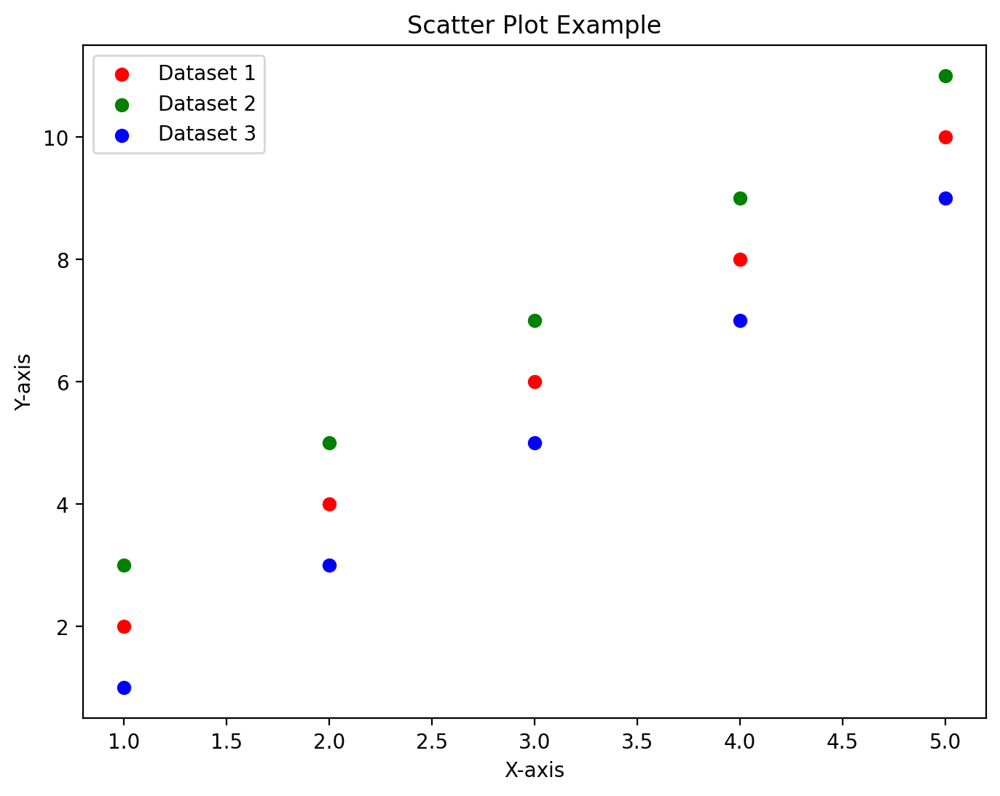

In [81]:
# 示例数据
x1 = [1, 2, 3, 4, 5]
y1 = [2, 4, 6, 8, 10]
x2 = [1, 2, 3, 4, 5]
y2 = [3, 5, 7, 9, 11]
x3 = [1, 2, 3, 4, 5]
y3 = [1, 3, 5, 7, 9]

fig, ax = plt.subplots(figsize=(8, 6))

# 绘制散点图
ax.scatter(x1, y1, color='red', label='Dataset 1')
ax.scatter(x2, y2, color='green', label='Dataset 2')
ax.scatter(x3, y3, color='blue', label='Dataset 3')

# 添加标题和轴标签
ax.set_title("Scatter Plot Example")
ax.set_xlabel("X-axis")
ax.set_ylabel("Y-axis")

# 添加图例
plt.legend()

# 显示图形
plt.show()

## classified by experiment

Bandlock_B1_B3_B7_B8_Dupl_Phone
Bandlock_All_B3_B7_B8_Dupl_Phone
Bandlock_LTE_B3_B7_B8_Dupl_Phone


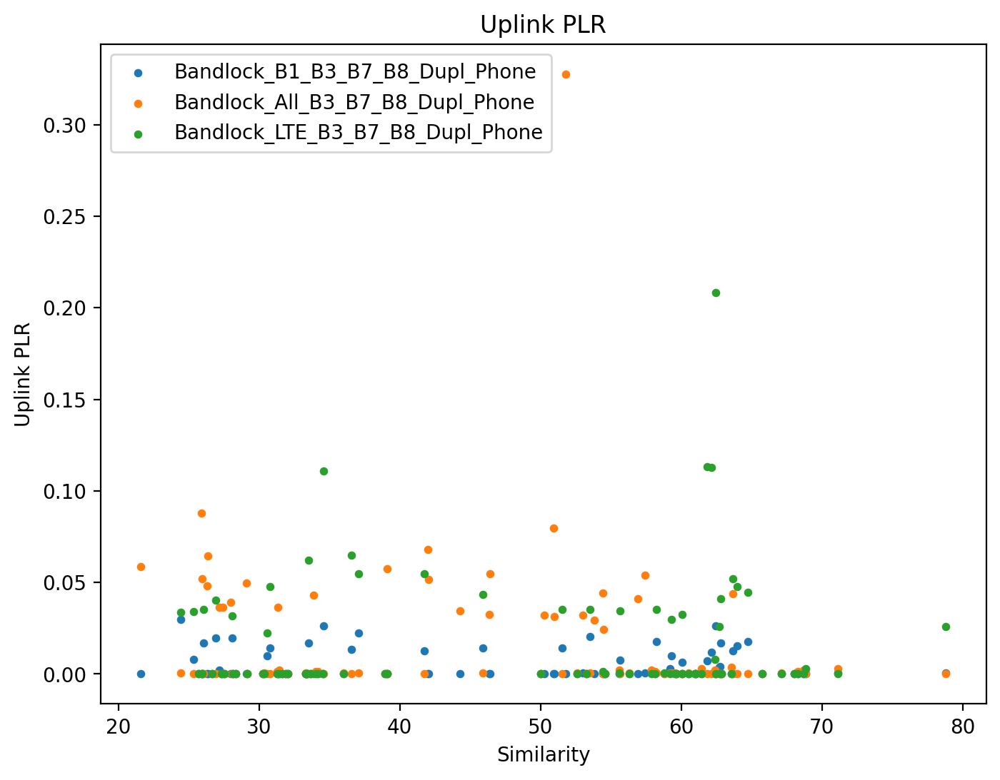

Bandlock_B1_B3_B7_B8_Dupl_Phone
Bandlock_All_B3_B7_B8_Dupl_Phone
Bandlock_LTE_B3_B7_B8_Dupl_Phone


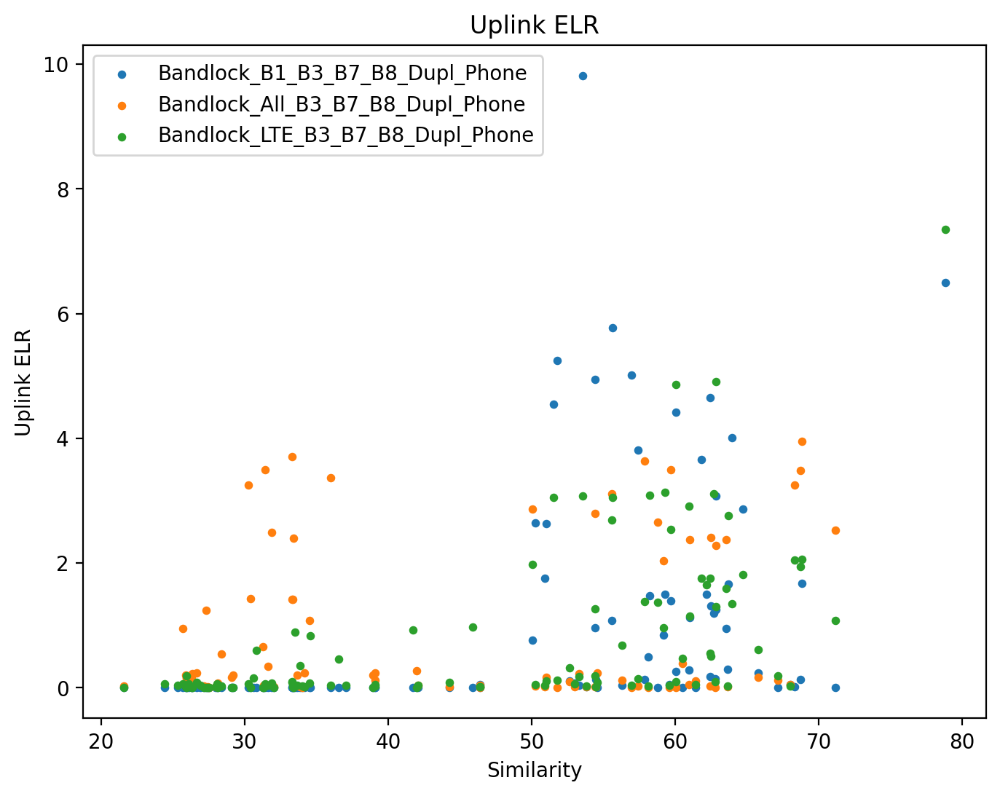

Bandlock_B1_B3_B7_B8_Dupl_Phone
Bandlock_All_B3_B7_B8_Dupl_Phone
Bandlock_LTE_B3_B7_B8_Dupl_Phone


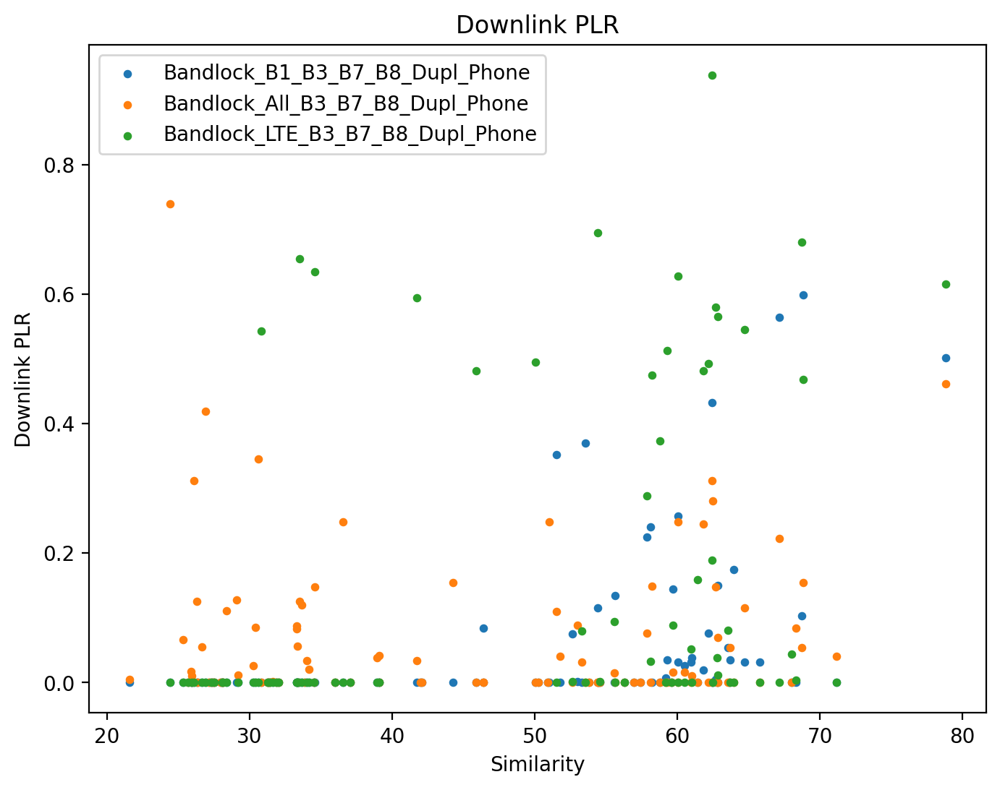

Bandlock_B1_B3_B7_B8_Dupl_Phone
Bandlock_All_B3_B7_B8_Dupl_Phone
Bandlock_LTE_B3_B7_B8_Dupl_Phone


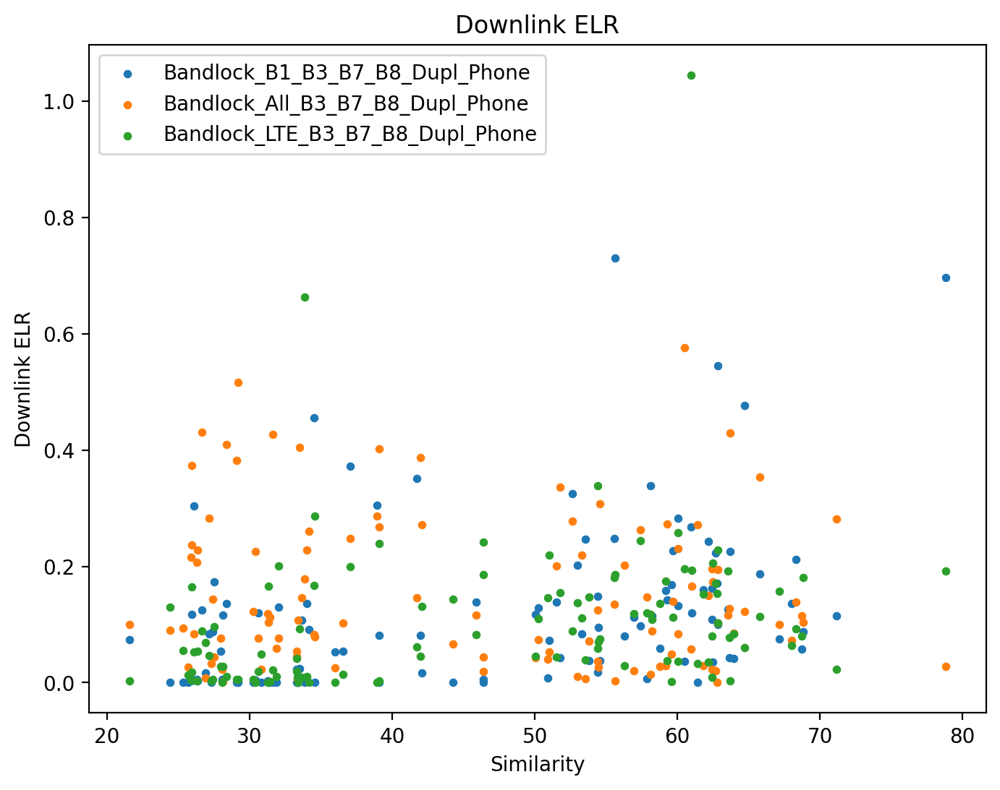

In [80]:
output_path = './scatter'

tables1 = {}
tables1['Similarity'] = sim_tables[exp_name].copy()
tables1['Similarity1'] = sim_tables1[exp_name].copy()

colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple',]
for sname in ['Similarity1']:
    
    for pname in ['Uplink_PLR', 'Uplink_ELR', 'Downlink_PLR', 'Downlink_ELR']:
        title = ' '.join(pname.split('_'))
        fig, ax = plt.subplots(figsize=(8, 6))
    
        for i, exp in enumerate(exp_list[:3]):
            dirname = exp.dirname
            devices = list(exp.setting.keys())
            schemes = list(exp.setting.values())
            traces = exp.traces
            print(os.path.basename(dirname))
            
            schemes = [f'{s}.0' if i % 2 == 0 else f'{s}.1' for i, s in enumerate(schemes)]
            # print(devices)
            # print(schemes)
            
            xs = list(it.product(schemes, repeat=2))
            xs = ['+'.join([s[0], s[1]]) if s[0] != s[1] else s[0] for s in xs]
            xs = np.reshape(xs, (len(schemes), len(schemes)))
            mtags = masked(xs.tolist(), mask(len(schemes), mode='upper'))
            mtags1 = masked(xs.tolist(), mask(len(schemes), mode='upper', diag=False))

            xs = list(it.combinations(schemes, 2))
            tags = [*schemes, *['+'.join([s[0], s[1]]) for s in xs]]

            xs = list(it.combinations(devices, 2))
            xs = [*devices, *xs]
            devices = xs
            
            tables = {}
            exp_name = os.path.basename(dirname)
            tables['Uplink_PLR'] = ul_plr_tables[exp_name].copy()
            tables['Uplink_ELR'] = ul_elr_tables[exp_name].copy()
            tables['Downlink_PLR'] = dl_plr_tables[exp_name].copy()
            tables['Downlink_ELR'] = dl_elr_tables[exp_name].copy()
            
            table = tables[pname].copy()
            table1 = tables1[sname].copy()
            # display(table)
            # display(table1)
            
            x, y = [], []
            for row1, row2 in zip(table1.iterrows(), table.iterrows()):
                index1, data1 = row1
                index2, data2 = row2
                if np.mean(data2.values) > 4.2:
                    continue
                x = [*x, *data1[8:]]
                y = [*y, *data2[8:]]
                # x = [*x, *data1]
                # y = [*y, *data2]
            
            # print(x)
            # print(y)
            # ax.scatter(x, y, color=colors[i], s=10, label=os.path.basename(dirname))
            ax.scatter(x, y, s=10, label=os.path.basename(dirname))

        ax.set_title(title)
        ax.set_xlabel('Similarity')
        ax.set_ylabel(title)
        # 添加图例
        plt.legend()
        # 显示图形
        plt.show()

## classified by setting

Bandlock_B1_B3_B7_B8_Dupl_Phone


,B1.0+B1.1,B1.0+B3.0,B1.0+B3.1,B1.0+B7.0,B1.0+B7.1,B1.0+B8.0,B1.0+B8.1,B1.1+B3.0,B1.1+B3.1,B1.1+B7.0,B1.1+B7.1,B1.1+B8.0,B1.1+B8.1,B3.0+B3.1,B3.0+B7.0,B3.0+B7.1,B3.0+B8.0,B3.0+B8.1,B3.1+B7.0,B3.1+B7.1,B3.1+B8.0,B3.1+B8.1,B7.0+B7.1,B7.0+B8.0,B7.0+B8.1,B7.1+B8.0,B7.1+B8.1,B8.0+B8.1
0,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,0.004011,0.000000,0.000000
1,0.022573,0.009876,0.01693,0.02963,0.019753,0.019753,0.007781,0.014109,0.012696,0.026102,0.016931,0.013404,0.014148,0.000705,0.007055,0.006349,0.020458,0.017685,0.017637,0.016931,0.00776,0.003537,0.026102,0.01552,0.012026,0.014109,0.009904,0.012733
2,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.001968,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000654,0.000000,0.000000,0.000000,0.000000,0.000000,0.000655,0.00000,0.000000,0.000000,0.00000,0.000656,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000703,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000703,0.00000,0.002821,0.000000,0.000000,0.000000


,B1.0+B1.1,B1.0+B3.0,B1.0+B3.1,B1.0+B7.0,B1.0+B7.1,B1.0+B8.0,B1.0+B8.1,B1.1+B3.0,B1.1+B3.1,B1.1+B7.0,B1.1+B7.1,B1.1+B8.0,B1.1+B8.1,B3.0+B3.1,B3.0+B7.0,B3.0+B7.1,B3.0+B8.0,B3.0+B8.1,B3.1+B7.0,B3.1+B7.1,B3.1+B8.0,B3.1+B8.1,B7.0+B7.1,B7.0+B8.0,B7.0+B8.1,B7.1+B8.0,B7.1+B8.1,B8.0+B8.1
0,47.405653,24.865591,22.319180,28.849485,30.200427,26.211640,27.625997,18.159815,22.892628,23.486140,25.143538,20.774031,21.154253,55.051862,57.622192,54.863533,55.181252,59.565502,63.877885,61.664587,63.843188,51.727454,72.792690,65.674733,53.793863,62.931595,53.481388,66.179340
1,70.178571,23.378606,22.536129,26.313883,23.097439,27.762968,27.480150,24.624636,23.254169,27.385605,25.577539,26.182693,26.266078,80.540117,72.347024,64.368666,63.837097,61.233070,74.881063,63.581204,63.668127,58.914350,65.693746,72.910209,68.759964,59.963048,55.869483,77.599682
2,66.717630,22.393864,18.443501,20.395982,26.457504,22.810555,23.552724,27.379934,23.168857,24.066718,30.614069,26.844485,27.196786,67.175170,62.423271,54.487255,55.049201,47.202487,53.754681,57.257758,58.563048,54.080908,53.262196,56.535344,55.956198,51.147153,51.502964,56.990026
3,71.263399,24.668391,21.902134,31.061569,24.034701,28.103048,29.965112,26.449905,23.426349,33.931854,23.619280,27.804693,31.238792,76.962399,61.747416,56.462471,72.541716,60.259914,55.338622,55.126136,59.305090,55.420134,54.803406,61.223897,67.721219,53.117131,46.873286,64.942221


/var/folders/vy/w6g3hxgj76s0gzty27t2d6gm0000gn/T/ipykernel_16526/3737864851.py:54: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for (column_name1, column_data1), (column_name2, column_data2) in zip(table1.iteritems(), table.iteritems()):
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


B1.0+B1.1
B1.0+B1.1
B1.0+B3.0
B1.0+B3.0
B1.0+B3.1
B1.0+B3.1
B1.0+B7.0
B1.0+B7.0
B1.0+B7.1
B1.0+B7.1
B1.0+B8.0
B1.0+B8.0
B1.0+B8.1
B1.0+B8.1
B1.1+B3.0
B1.1+B3.0
B1.1+B3.1
B1.1+B3.1
B1.1+B7.0
B1.1+B7.0
B1.1+B7.1
B1.1+B7.1
B1.1+B8.0
B1.1+B8.0
B1.1+B8.1
B1.1+B8.1
B3.0+B3.1
B3.0+B3.1
B3.0+B7.0
B3.0+B7.0
B3.0+B7.1
B3.0+B7.1
B3.0+B8.0
B3.0+B8.0
B3.0+B8.1
B3.0+B8.1
B3.1+B7.0
B3.1+B7.0
B3.1+B7.1
B3.1+B7.1
B3.1+B8.0
B3.1+B8.0
B3.1+B8.1
B3.1+B8.1
B7.0+B7.1
B7.0+B7.1
B7.0+B8.0
B7.0+B8.0
B7.0+B8.1
B7.0+B8.1
B7.1+B8.0
B7.1+B8.0
B7.1+B8.1
B7.1+B8.1
B8.0+B8.1
B8.0+B8.1
{'B1.0+B1.1': [47.40565317035905, 70.17857142857143, 66.71762995638879, 71.2633990318119], 'B1.0+B3.0': [24.865590500170306, 23.3786060981406, 22.393864495492874, 24.66839105718588], 'B1.0+B3.1': [22.3191804670302, 22.53612883792285, 18.443501144724088, 21.902133868847248], 'B1.0+B7.0': [28.849484731767888, 26.31388300826686, 20.39598194788179, 31.06156867275038], 'B1.0+B7.1': [30.200426572987894, 23.09743883700749, 26.457504097401074, 

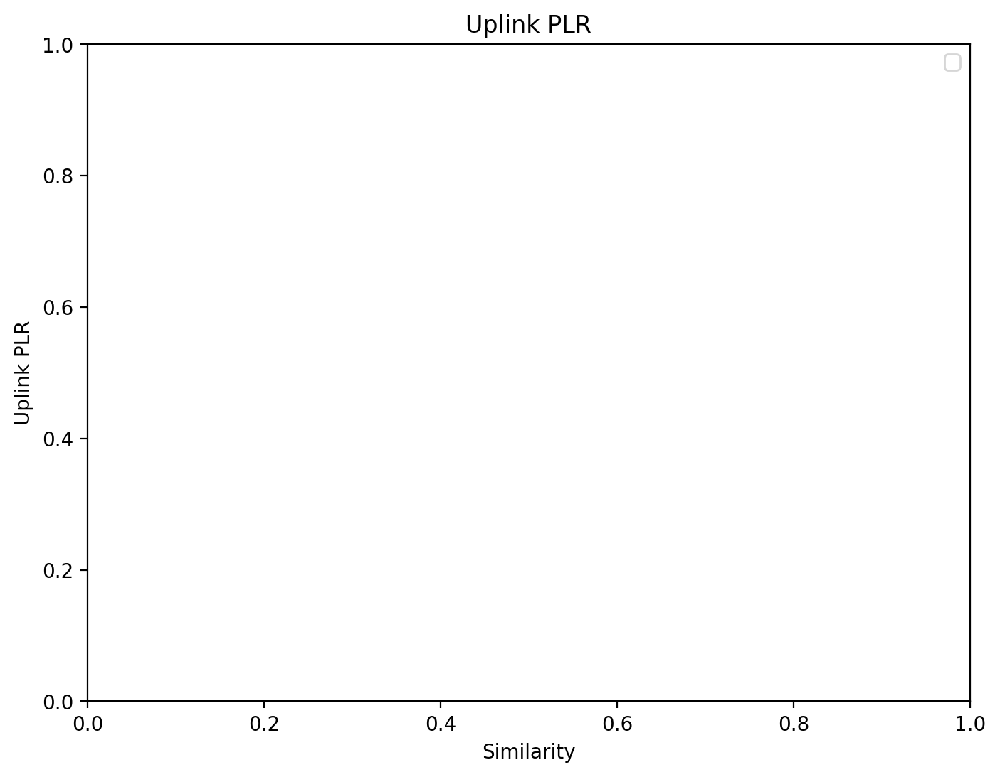

In [89]:
output_path = './scatter'

tables1 = {}
tables1['Similarity'] = sim_tables[exp_name].copy()
tables1['Similarity1'] = sim_tables1[exp_name].copy()

colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple',]
for sname in ['Similarity1']:
    
    for pname in ['Uplink_PLR', 'Uplink_ELR', 'Downlink_PLR', 'Downlink_ELR']:
        title = ' '.join(pname.split('_'))
        fig, ax = plt.subplots(figsize=(8, 6))
        
        sim_dict = {}
        lr_dict = {}
    
        for i, exp in enumerate(exp_list[:3]):
            dirname = exp.dirname
            devices = list(exp.setting.keys())
            schemes = list(exp.setting.values())
            traces = exp.traces
            print(os.path.basename(dirname))
            
            schemes = [f'{s}.0' if i % 2 == 0 else f'{s}.1' for i, s in enumerate(schemes)]
            # print(devices)
            # print(schemes)
            
            xs = list(it.product(schemes, repeat=2))
            xs = ['+'.join([s[0], s[1]]) if s[0] != s[1] else s[0] for s in xs]
            xs = np.reshape(xs, (len(schemes), len(schemes)))
            mtags = masked(xs.tolist(), mask(len(schemes), mode='upper'))
            mtags1 = masked(xs.tolist(), mask(len(schemes), mode='upper', diag=False))

            xs = list(it.combinations(schemes, 2))
            tags = [*schemes, *['+'.join([s[0], s[1]]) for s in xs]]

            xs = list(it.combinations(devices, 2))
            xs = [*devices, *xs]
            devices = xs
            
            tables = {}
            exp_name = os.path.basename(dirname)
            tables['Uplink_PLR'] = ul_plr_tables[exp_name].copy()
            tables['Uplink_ELR'] = ul_elr_tables[exp_name].copy()
            tables['Downlink_PLR'] = dl_plr_tables[exp_name].copy()
            tables['Downlink_ELR'] = dl_elr_tables[exp_name].copy()
            
            table = tables[pname].iloc[:, 8:].copy()
            table1 = tables1[sname].iloc[:, 8:].copy()
            
            display(table)
            display(table1)
            
            for (column_name1, column_data1), (column_name2, column_data2) in zip(table1.iteritems(), table.iteritems()):
                print(column_name1)
                print(column_name2)
                try:
                    sim_dict[column_name1] = [*sim_dict[column_name1], *column_data1]
                    lr_dict[column_name2] = [*lr_dict[column_name2], *column_data2]
                except:
                    sim_dict[column_name1] = [*column_data1]
                    lr_dict[column_name2] = [*column_data2]
            
            print(sim_dict)
            print(lr_dict)
            
            # x, y = [], []
            # for row1, row2 in zip(table1.iterrows(), table.iterrows()):
            #     index1, data1 = row1
            #     index2, data2 = row2
            #     if np.mean(data2.values) > 4.2:
            #         continue
            #     x = [*x, *data1[8:]]
            #     y = [*y, *data2[8:]]
            #     # x = [*x, *data1]
            #     # y = [*y, *data2]
            
            # # print(x)
            # # print(y)
            # # ax.scatter(x, y, color=colors[i], s=10, label=os.path.basename(dirname))
            # ax.scatter(x, y, s=10, label=os.path.basename(dirname))
            break

        ax.set_title(title)
        ax.set_xlabel('Similarity')
        ax.set_ylabel(title)
        # 添加图例
        plt.legend()
        # 显示图形
        plt.show()
        break
    break